# **Cat Face Generator**
## CAS ADS M3 Project Submission by Petra Müller, University Bern. 

The goal of this project was to create and train a Generative Adversarial Network to generate realistic looking cat faces. 

As this project is a toy example, i also wanted to implement a few ideas to improve the GAN's overall performance.



---



### Importing the required libraries:

In [1]:
# if running in google colab:
%tensorflow_version 2.x 


import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import os
import glob
import math
import random
import time
import datetime
import shutil
from tqdm import tqdm, tqdm_notebook

from pathlib import Path
import warnings


from PIL import Image

import tensorflow as tf
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, LeakyReLU, Reshape, Conv2DTranspose, Conv2D, Flatten, Dropout, Embedding, ReLU


TensorFlow 2.x selected.


### 1. The training data

Dataset containing around 29843 images of cats' faces of size 64x64. It was obtained from https://github.com/Ferlix/Cat-faces-dataset and according to the description it combines various different datasets of cat data. 


---

**Loading and preprocessing the data:**



Working with a large number of files in google colab / google drive can be slow. Therefore I recommend loading the files into one single numpy array and save that array to a binary file which can then be uploaded to the drive and loaded in quickly for further processing. 

In [ ]:

#filelist = os.listdir('/your/path/to/your/cat/data/')                          # obtain list of files

#allcatdata = np.array([np.array(Image.open(fname)) for fname in filelist])     # loop over the files and convert to numpy array

#np.save('/your/path/to/data/input/training_data_64_64.npy', allcatdata)        # save the array as .npy and upload to google drive / colab

In [ ]:
# load the binary file
allcats = np.load('/your/path/to/data/input/training_data_64_64.npy')

In [ ]:
IMAGE_WIDTH = 64
IMAGE_HEIGHT = 64
IMAGE_CHANNELS = 3
SAMPLE_SIZE = allcats.shape[0]


**Let's see some example images:**

In [ ]:
def plot_cats(image_arr, examples, image_width=IMAGE_WIDTH, image_height=IMAGE_HEIGHT, image_channels=IMAGE_CHANNELS): 
  ''' This function takes an array of images as input as well as a number of 
  examples and plots the images in a grid '''
  imgs = []                                                                     # set up an empty list to append the images
  for i in range(examples):                                                     # loop over number of examples
    rnd_idx = np.random.randint(0, SAMPLE_SIZE)                                 # get a random index
    imgs.append(image_arr[rnd_idx, :, :, :])                                    # append the randomly picked image
    
    
  fig, axes = plt.subplots(round(math.sqrt(examples)), 
                           round(math.sqrt(examples)),
                           figsize=(15,15),                                     # set up the grid so it will set it up squared by using the square root of examples to set rows and columns
  subplot_kw = {'xticks':[], 'yticks':[]},                                      # no axis ticks
  gridspec_kw = dict(hspace=0.3, wspace=0.01))                                  # a nice grid
    
  for i, ax in enumerate(axes.flat):                                            # assign each image to it's position by looping over the axes
    ax.imshow(imgs[i])                                                          

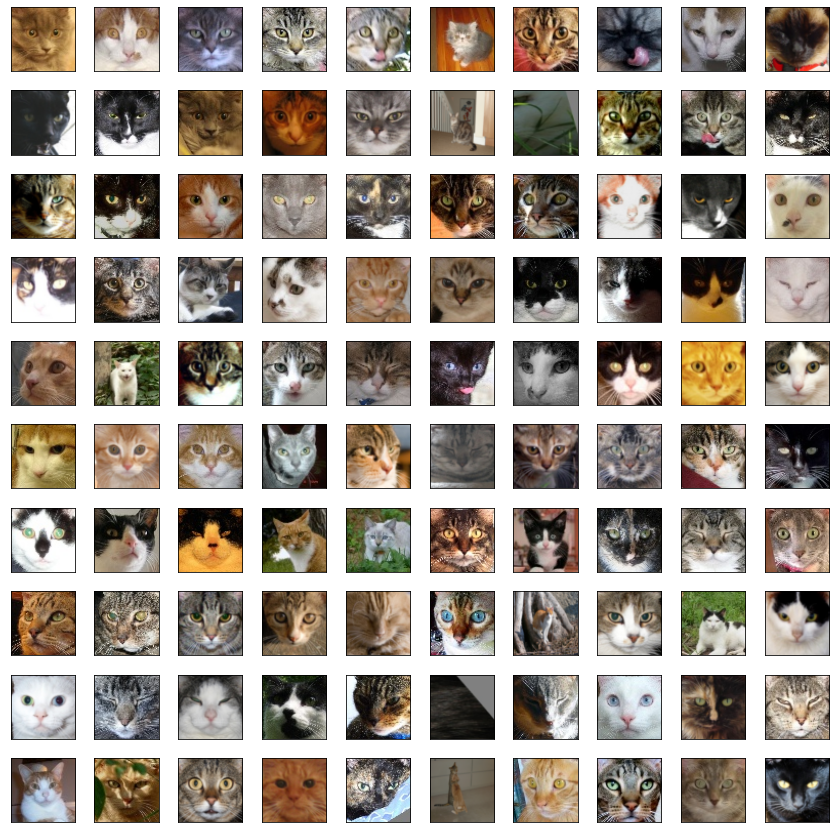

In [6]:
# plot some examples
plot_cats(allcats,examples = 100)

As we can see, not all of the images really contain only a cat face or are centered on the cats' face - so not optimal. But most of them are OK and for the sake of this project, no futher data cleaning methods are applied. 


---

**Normalise the data:** 



In [7]:
'''
It is recommended to use tanh activation function for the generator model.
The range of the tanh function is from -1 to 1, so I have to 'normalize' 
the pixel values so they are ranging from -1 to 1 in the input data as well. 
this can be done like this: 
'''
allcats_norm = (allcats - 127.5) / 127.5            
print(np.max(allcats_norm[3,:,:,:]), np.min(allcats_norm[3,:,:,:]))             # print max and min values

0.9058823529411765 -0.9764705882352941


lets see normalised examples:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

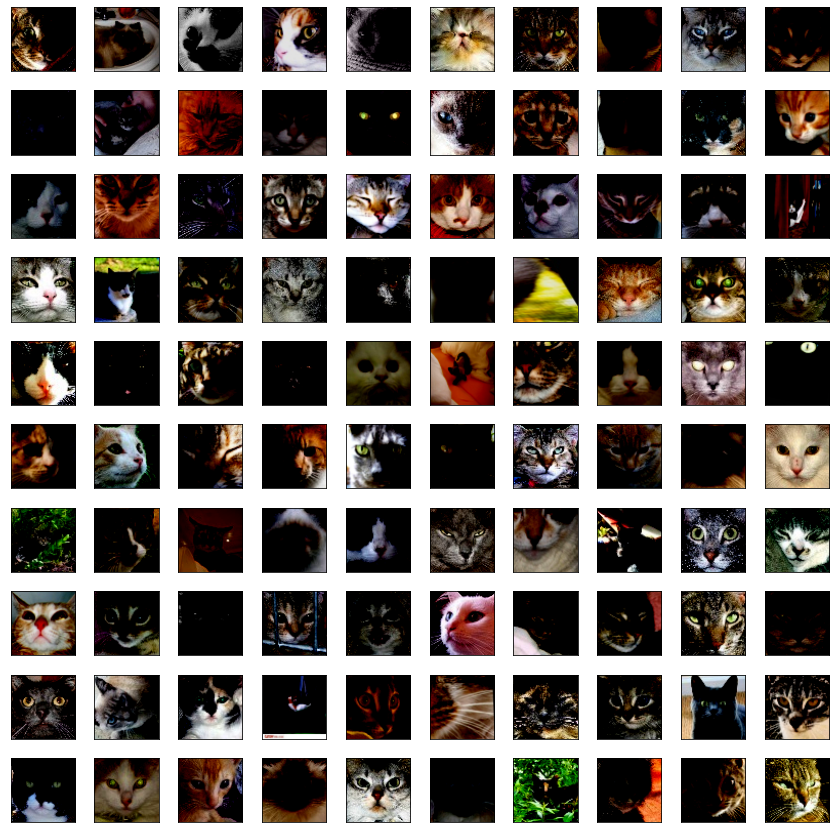

In [8]:
print('lets see normalised examples:')
plot_cats(allcats_norm,examples=100)

This 'normalisation' can be reversed by reversing the operation, e.g

(img * 127.5 + 127.5) / 255.


---



### 2. Setting up the model(s) and the data


In [ ]:
# convert 'normalised' cat images array to a tensor
cat_images_tf = tf.cast(allcats_norm, 'float32')

In [ ]:
# MODEL HYPERPARAMETERS
BATCH_SIZE = 128                                                                # minibatch size
WEIGHT_INIT_STD = 0.02                                                          # make the std more narrow than default helped for some reason i don't know
WEIGHT_INIT_MEAN = 0.0
LEAKY_RELU_SLOPE = 0.2
DOWNSIZE_FACTOR = 2
SCALE_FACTOR = 4 ** DOWNSIZE_FACTOR
GENERATOR_LR = 0.0002                                                           # learning rates
DISCRIMINATOR_LR = 0.0002
NOISE_DIM = 128                                                                 # size of the noise vector to give the generator as input

WEIGHT_INITIALISER = tf.keras.initializers.TruncatedNormal(stddev=WEIGHT_INIT_STD, mean=WEIGHT_INIT_MEAN,seed=42)

In [ ]:
# i want to randomly flip some images horizontally, therefore create a helper function
def flip(x: tf.Tensor) -> (tf.Tensor):
  ''' 
  takes a tensor of images and flips the images horizontally with 50% chance 
  using tensorflow's random_flip_left_right function. returns a tensor with 
  flipped images.
  '''
  x = tf.image.random_flip_left_right(x)
  return x

In [12]:
# create tensorflow type dataset with flipped images:
cat_features_data = tf.data.Dataset.from_tensor_slices(cat_images_tf).shuffle(SAMPLE_SIZE).map(flip).batch(BATCH_SIZE)
print(cat_features_data)

<BatchDataset shapes: (None, 64, 64, 3), types: tf.float32>




---


### 3. Building the model(s)

A Generative Adversarial Network consists of 2 neural networks - a Generator model and a Discriminator model - who then contest with each other in a game:
The generative network generates examples (from noise) while the discriminative network evaluates them. The Discriminator model is trained to discriminate generated examples from real samples in the training dataset. The Generator model trains based on whether it succeeds to trick the Discriminator. 

 

---

**The Generator model:**

My final generator model consists of '7' layers:
- Dense (fully connected) input layer with no activation function, followed by a Reshape that is used to reshape the input correctly
- 5 Deconvolution layers followed by batch normalization (see https://towardsdatascience.com/batch-normalization-in-neural-networks-1ac91516821c) and ReLU activation
- Dense (fully connected) output layer with 3 neurons (one for each color channel) and tanh activation function.


In [ ]:
def CatGenerator():
  model = Sequential(name = 'Cat Generator')
  # 1. layer, Fully Connected (2048)
  model.add(Dense(IMAGE_WIDTH // SCALE_FACTOR * IMAGE_HEIGHT // SCALE_FACTOR * NOISE_DIM, input_shape = (NOISE_DIM,), kernel_initializer = WEIGHT_INITIALISER))
  # 1.1 reshape to (4, 4, 128)
  model.add(Reshape((IMAGE_HEIGHT // SCALE_FACTOR, IMAGE_WIDTH // SCALE_FACTOR, NOISE_DIM)))
  
  # 2. layer, 'Deconvolution', 512 neurons (4, 4, 512)
  model.add(Conv2DTranspose(512, kernel_size = 5, strides = (1,1), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 2.1 Batch normalization
  model.add(BatchNormalization())
  # 2.2 relu activation
  model.add(ReLU())

  # 3. layer, 'Deconvolution', 256 neurons (8, 8, 256)
  model.add(Conv2DTranspose(256, kernel_size = 5, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 3.1 Batch normalization
  model.add(BatchNormalization())
  # 3.2 relu activation
  model.add(ReLU())

  # 4. layer, 'Deconvolution', 128 neurons (16, 16, 128)
  model.add(Conv2DTranspose(128, kernel_size = 5, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 4.1 Batch normalization
  model.add(BatchNormalization())
  # 4.2 relu activation
  model.add(ReLU())

  # 5. layer, 'Deconvolution', 64 neurons (32, 32, 64)
  model.add(Conv2DTranspose(64, kernel_size = 5, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 5.1 Batch normalization
  model.add(BatchNormalization())
  # 5.2 relu activation
  model.add(ReLU())

  # 6. layer, 'Deconvolution', 32 neurons (64, 64, 32)
  model.add(Conv2DTranspose(32, kernel_size = 5, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 6.1 Batch normalization
  model.add(BatchNormalization())
  # 6.2 relu activation
  model.add(ReLU())

  # 7. Output layer, 3 neurons (64, 64, 3) with tanh activation
  model.add(Dense(3, activation = 'tanh', kernel_initializer = WEIGHT_INITIALISER))

  return model

Initialise and show the model summary:

In [14]:
cat_generator = CatGenerator()
print(cat_generator.summary())

Model: "Cat Generator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2048)              264192    
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 128)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 4, 4, 512)         1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 4, 4, 512)         2048      
_________________________________________________________________
re_lu (ReLU)                 (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 8, 8, 256)         3276800   
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 256)       



---


**The Discriminator model:**

My final discriminator model consists of '5' layers:
- a Convolution layer as input layer with 64 neurons followed by LeakyReLu activation 
- 3 Convolution layers followed by Batch Normalisation and leaky ReLU activation
- Dense (fully connected) output layer with 1 neuron and sigmoid activation



In [ ]:
def CatDiscriminator():
  model = Sequential(name = 'Cat Discriminator')
  # 1. layer, Convolution (32, 32, 64)
  model.add(Conv2D(64, kernel_size = 4, strides = (2,2), padding = 'same', use_bias = False, input_shape = [IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS], kernel_initializer = WEIGHT_INITIALISER))
  # 1.1 leaky relu activation
  model.add(LeakyReLU(alpha = LEAKY_RELU_SLOPE))

  # 2. layer, Convolution (16, 16, 64)
  model.add(Conv2D(64, kernel_size = 4, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 2.1 Batch normalization
  model.add(BatchNormalization())
  # 2.2 leaky relu activation
  model.add(LeakyReLU(alpha = LEAKY_RELU_SLOPE))

  # 3. layer, Convolution (8, 8, 128)
  model.add(Conv2D(128, kernel_size = 4, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 3.1 Batch normalization
  model.add(BatchNormalization())
  # 3.2 leaky relu activation
  model.add(LeakyReLU(alpha = LEAKY_RELU_SLOPE))

  # 4. layer, Convolution (4, 4, 256)
  model.add(Conv2D(256, kernel_size = 4, strides = (2,2), padding = 'same', kernel_initializer = WEIGHT_INITIALISER, use_bias = False))
  # 4.1 Batch normalization
  model.add(BatchNormalization())
  # 4.2 leaky relu activation
  model.add(LeakyReLU(alpha=LEAKY_RELU_SLOPE))

  # 5. Output, flatten (4096)
  model.add(Flatten())
  # 5.1 fully connected layer with 1 output neuron and sigmoid activation (1)
  model.add(Dense(1, activation='sigmoid'))

  return model

Initialise and show the model summary:

In [16]:
cat_discriminator = CatDiscriminator()
print(cat_discriminator.summary())

Model: "Cat Discriminator"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 32, 32, 64)        3072      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 16, 16, 64)        65536     
_________________________________________________________________
batch_normalization_5 (Batch (None, 16, 16, 64)        256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 8, 8, 128)         131072    
_________________________________________________________________
batch_normalization_6 (Batch (None, 8, 8, 128)   



---


**Testing the models:**

I can now use this (untrained) model to already generate some images and have them evaluated by the discriminator. 

To observe how the training develops, I am going to use a 'seed', e.g. every time i generate images, I use the exact same noise input


In [ ]:
N_TO_GENERATE = 9                                                               # how many images we want to generate
#my_output_seed = tf.random.normal([N_TO_GENERATE, NOISE_DIM], seed = 1337)     # this is the seeded noise vector
#np.save('/your/path/to/data/input/noise_input.npy', my_output_seed)            # save the array as .npy and upload to google drive / colab so i can use the seed on multiple notebooks
my_output_seed = np.load('/your/path/to/data/input/noise_input.npy')
OUTPUT_IMAGES_PATH = '/your/path/to/data/model/output/generated_images'         # where to save generated images

In [ ]:
# create a function to be used to generate, plot and save images without training the model:
def GenerateShowSaveCatImages(model, epoch, noise_vector):
  '''
  Will generate images according to the shape of the noise vector and plot
  these in a grid, and save the resulting figure to a .png file.
  '''
  predictions = model(noise_vector, training = False)                           # generate images with training set to False
  fig = plt.figure(figsize=(15,15))
  for i in range(predictions.shape[0]):
    plt.subplot(round(math.sqrt(N_TO_GENERATE)),round(math.sqrt(N_TO_GENERATE)), i+1)
    plt.imshow((predictions[i, :, :, :] * 127.5 + 127.5) / 255.)                # de-normalise images so we get a nicer plot
    plt.axis('off') 
  plt.savefig(os.path.join(OUTPUT_IMAGES_PATH, 'generated_at_epoch_{}.png'.format(epoch)))
  plt.show()

Let's see what the untrained model generates:

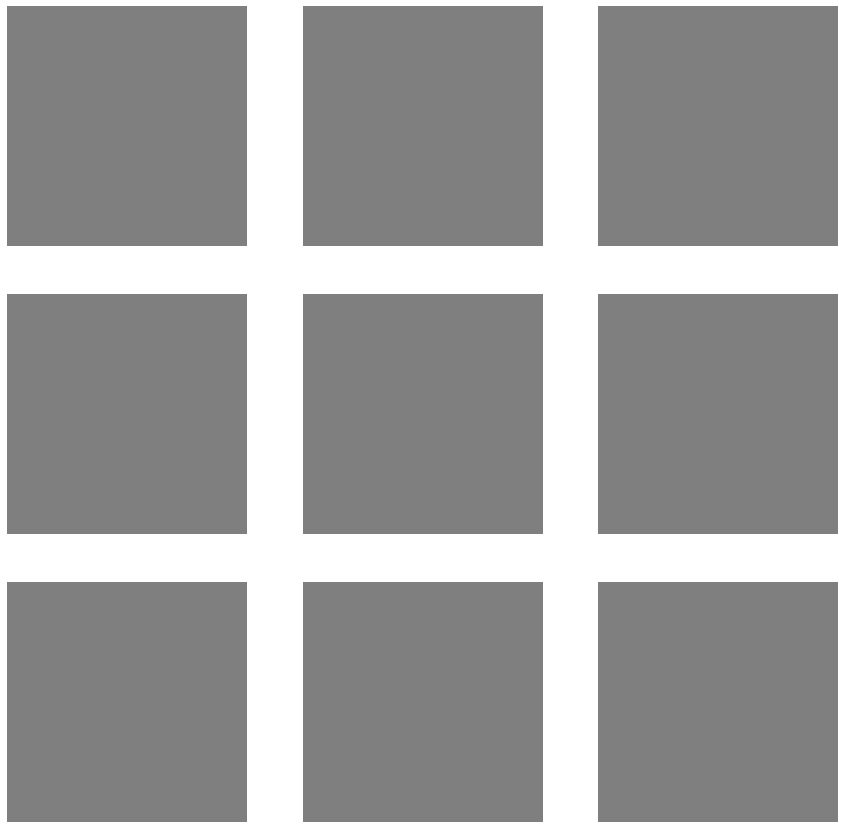

In [19]:
GenerateShowSaveCatImages(cat_generator,0, my_output_seed)

We can also see how the discriminator evaluates these images:

In [20]:
predictions = cat_generator(my_output_seed, training = False) 
decision = cat_discriminator(predictions, training = False)
print(decision[0:10]) # print the decision for the first 10 generated images. 

tf.Tensor(
[[0.50000054]
 [0.49999964]
 [0.49999982]
 [0.50000036]
 [0.50000006]
 [0.5000007 ]
 [0.5       ]
 [0.49999976]
 [0.50000036]], shape=(9, 1), dtype=float32)


We can see that the decision for all these images with the untrained Discriminator is at chance level with around 0.5. 


---

### 4. Model Loss 


I use Adam optimizer for both, the Generator and the Discriminator 

In [ ]:
# adam optimizer with specified learning rate
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=GENERATOR_LR, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=DISCRIMINATOR_LR, beta_1=0.5)

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

In [ ]:
# defining a function that will flip zeros to ones /ones to zeros based on a given probability
"""
def LabelNoise(labels, prob):
  ''' 
  This function expects an input tensor (labels) that consists of either zeros 
  or ones and will flip ones to zeros / zeros to ones based on the probability
  prob.
  '''
  n_flip = int(prob * int(labels.shape[0]))                                     # how many labels to flip
  flip_idx = np.random.choice([i for i in range(int(labels.shape[0]))], size=n_flip) # which labels to flip
    
  lst = []
  for i in range(int(labels.shape[0])):
    if i in flip_idx:
      lst.append(tf.subtract(1, labels[i]))
    else:
      lst.append(labels[i])
    
  outputs = tf.stack(lst)
  return outputs
"""

Discriminator loss is the sum of the cross entropy between the 'real output' and a tensor of ones and the cross entropy between the 'fake output' and a tensor of zeros. 

In [ ]:
def DiscriminatorLoss(real_output, fake_output):
  #real_output_noise = LabelNoise(tf.ones_like(real_output), 0.05)
  #fake_output_noise = LabelNoise(tf.zeros_like(fake_output), 0.05)
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  #real_loss = cross_entropy(real_output_noise, real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  #fake_loss = cross_entropy(fake_output_noise, fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

Generator loss is the cross entropy between a tensor of ones and the 'fake output'

In [ ]:
def GeneratorLoss(fake_output):
  generator_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
  return generator_loss



---


### 5. Training the model

In [ ]:
# setting up checkpoint saves:
checkpoint_dir = 'your/path/to/model/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")

checkpoint = tf.train.Checkpoint(generator_optimizer = generator_optimizer,
                                 discriminator_optimizer = discriminator_optimizer,
                                 generator = cat_generator,
                                 discriminator = cat_discriminator)

In [ ]:
# setting up a function to plot the losses per epoch
def LossPlot(g_loss, d_loss, epoch):
  '''
  Takes losses and an epoch number to plot losses for that epoch.
  '''
  plt.figure(figsize = (10,5))
  plt.title("Generator and Discriminator Loss - EPOCH {}".format(epoch))
  plt.plot(g_loss, label = "Generator")
  plt.plot(d_loss, label = "Discriminator")
  plt.xlabel("Batches")
  plt.ylabel("Loss")
  plt.legend()
  plt.savefig(os.path.join(OUTPUT_IMAGES_PATH, 'losses_at_epoch_{}.png'.format(epoch)))
  plt.show()

In [ ]:
def TrainingStep(images, G_loss, D_loss):
  '''
  What happens in training for 1 Batch.
  '''
  noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])                             # noise tensor for batch

  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:           # GradientTape is used to 'watch' the trainable variables and the resulting gradients
    generated_images = cat_generator(noise, training=True)                      # the generator generates n = Batch Size images
        
    real_output = cat_discriminator(images, training=True)                      # the discriminator evaluates generated images and images from training set
    fake_output = cat_discriminator(generated_images, training=True)
        
    gen_loss = GeneratorLoss(fake_output)                                       # losses are calculated for batch
    disc_loss = DiscriminatorLoss(real_output, fake_output)

  G_loss.append(gen_loss.numpy())                                               # losses are appended to list for whole Epoch
  D_loss.append(disc_loss.numpy())
  # get gradients from GradientTape
  gradients_of_generator = gen_tape.gradient(gen_loss, cat_generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, cat_discriminator.trainable_variables)
  # apply gradients to trainable variables
  generator_optimizer.apply_gradients(zip(gradients_of_generator, cat_generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, cat_discriminator.trainable_variables))

In [ ]:
def Train(dataset, epochs):
  '''
  What happens per Epoch in training.
  '''
  G_loss = []                                                                   # initialize empty lists for losses (for plot)
  D_loss = []
  for epoch in tqdm(range(epochs)):                                             # tqdm is used to display a progress bar per epoch!
    start = time.time()
    global_step = 0
        
    for image_batch in dataset:                                                 # iterate over batches in the dataset
      TrainingStep(image_batch, G_loss, D_loss)                                 # do TrainStep on batch
      global_step += 1                                                          # increase global step counter

    if (epoch + 1) % 10 == 0:                                                    # every tenth epoch, 
      LossPlot(G_loss, D_loss, epoch+100 + 1)                                       # plot losses
      GenerateShowSaveCatImages(cat_generator, epoch+100 + 1, my_output_seed)       # save plot of generated images (without training, based on previously picked seed)
      checkpoint.save(file_prefix = checkpoint_prefix)                          # save a checkpoint
    
    G_loss = []                                                                 # reset losses after epoch
    D_loss = []           

    print ('Epoch: {} computed for {} sec'.format(epoch + 1, time.time() - start)) # display how long the epoch took
  # after the final epoch, save a checkpoint and the generated images
  GenerateShowSaveCatImages(cat_generator, epochs+100, my_output_seed)
  checkpoint.save(file_prefix = checkpoint_prefix)
  print('Final epoch.')

In [ ]:

#checkpoint.restore(tf.train.latest_checkpoint('/your/path/to/model/training_checkpoints/'))

  1%|          | 1/100 [00:57<1:35:20, 57.78s/it]

Epoch: 1 computed for 57.783533573150635 sec


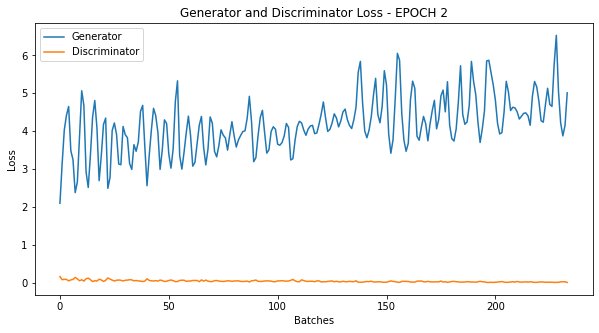

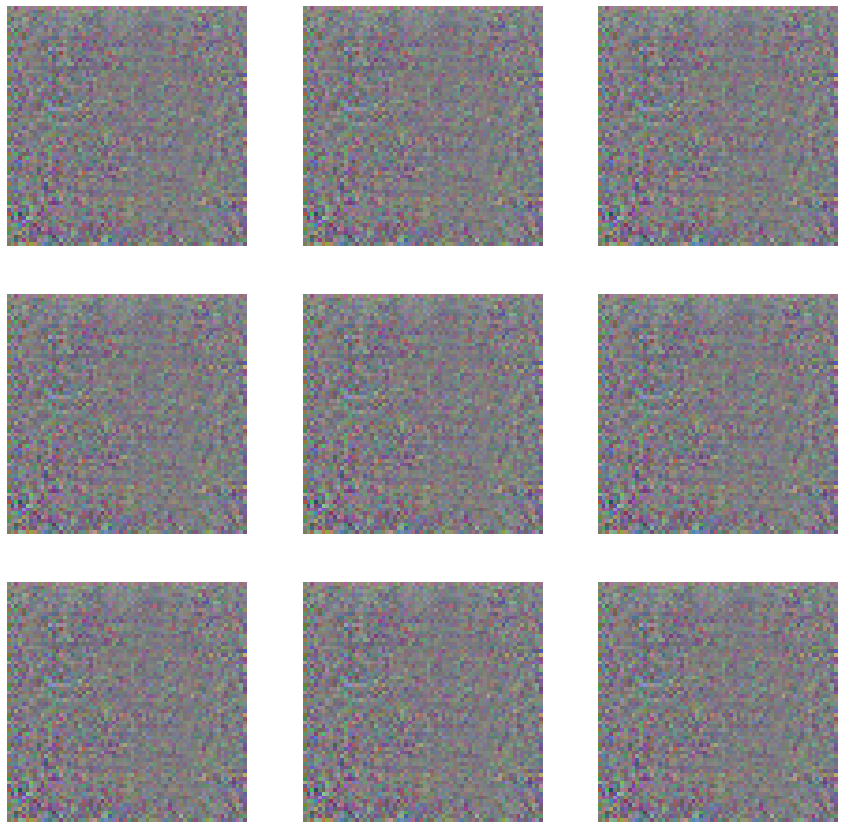

  2%|▏         | 2/100 [01:56<1:34:38, 57.95s/it]

Epoch: 2 computed for 58.330090045928955 sec


  3%|▎         | 3/100 [02:51<1:32:39, 57.31s/it]

Epoch: 3 computed for 55.820008277893066 sec


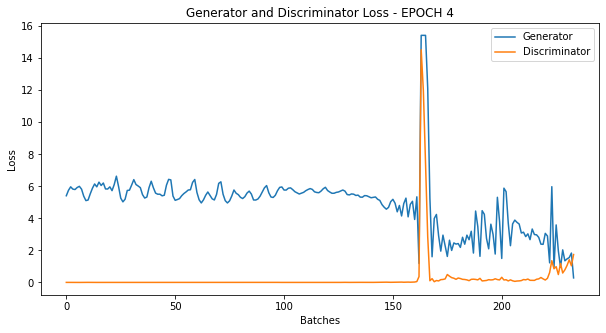

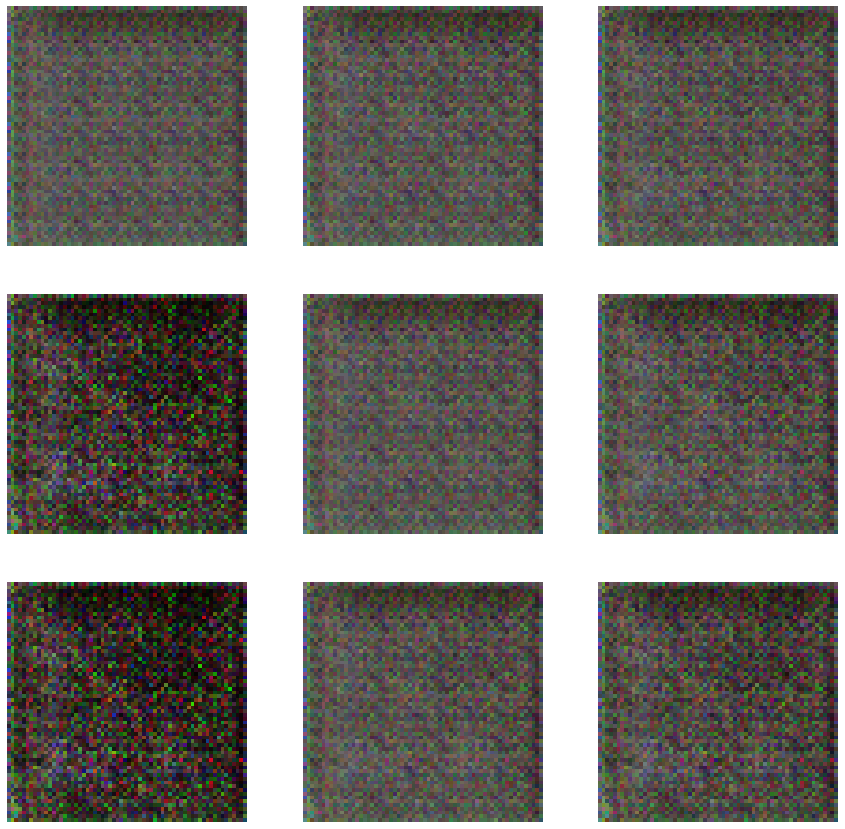

  4%|▍         | 4/100 [03:49<1:31:39, 57.28s/it]

Epoch: 4 computed for 57.215829849243164 sec


  5%|▌         | 5/100 [04:45<1:30:25, 57.11s/it]

Epoch: 5 computed for 56.701311349868774 sec


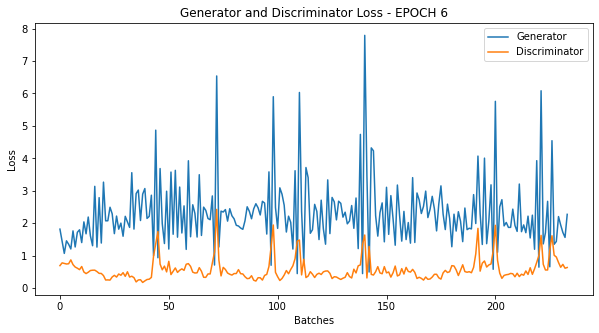

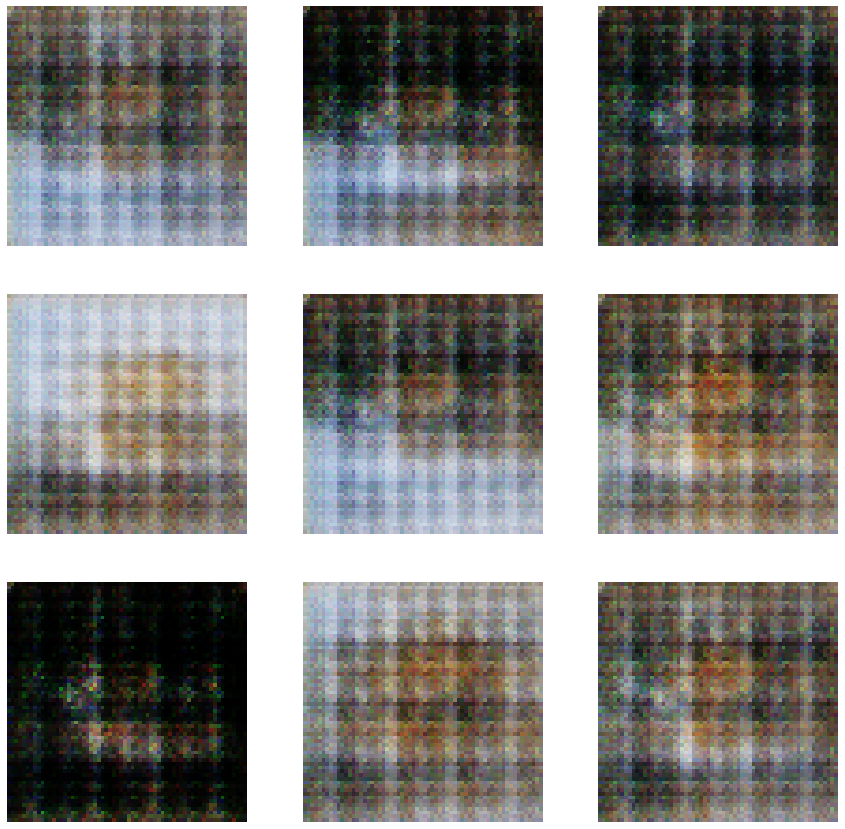

  6%|▌         | 6/100 [05:43<1:29:31, 57.14s/it]

Epoch: 6 computed for 57.217132329940796 sec


  7%|▋         | 7/100 [06:39<1:28:14, 56.93s/it]

Epoch: 7 computed for 56.42874336242676 sec


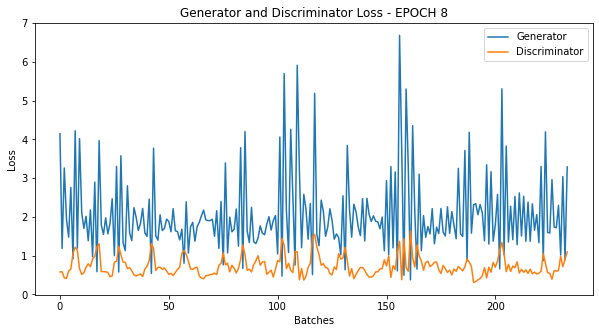

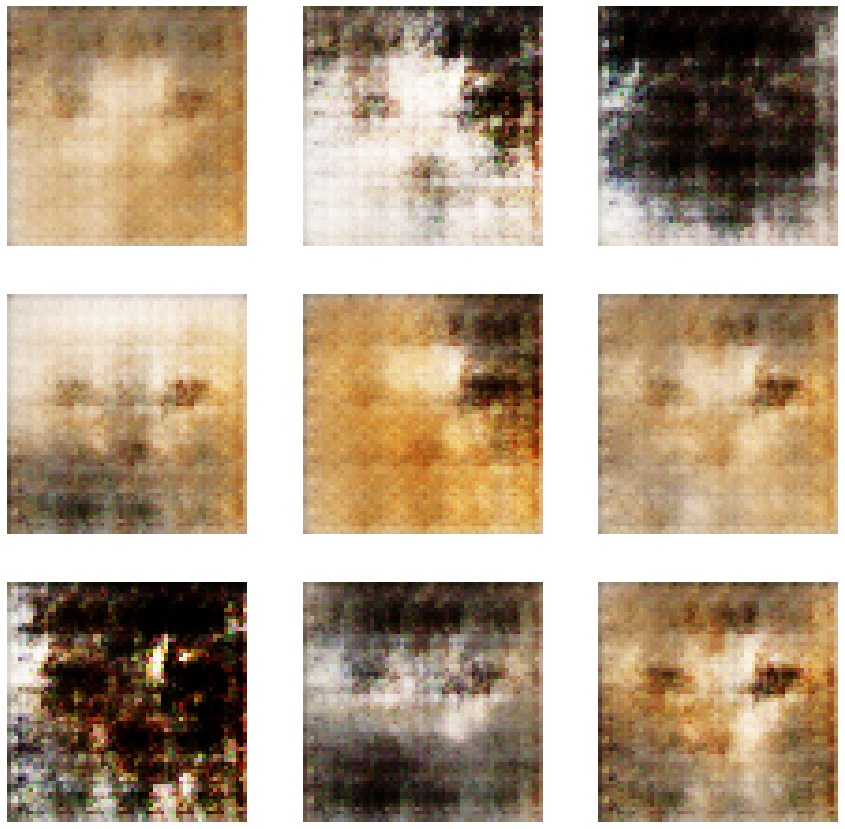

  8%|▊         | 8/100 [07:36<1:27:26, 57.03s/it]

Epoch: 8 computed for 57.267873764038086 sec


  9%|▉         | 9/100 [08:33<1:26:23, 56.96s/it]

Epoch: 9 computed for 56.800498485565186 sec


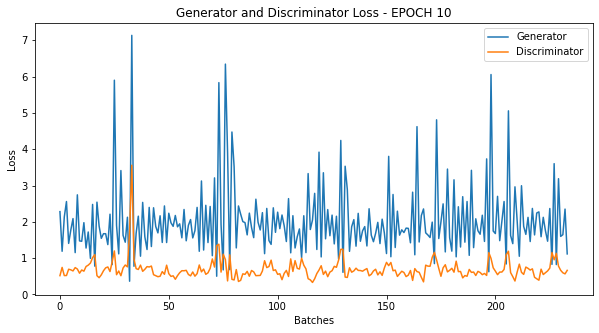

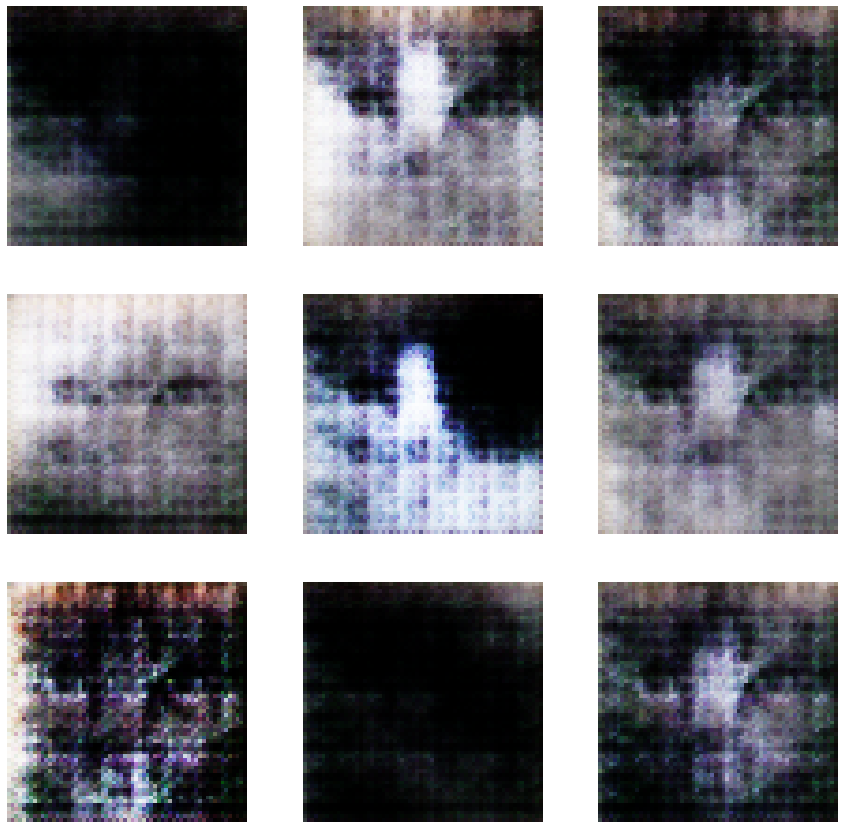

 10%|█         | 10/100 [09:30<1:25:33, 57.04s/it]

Epoch: 10 computed for 57.2062554359436 sec


 11%|█         | 11/100 [10:27<1:24:14, 56.79s/it]

Epoch: 11 computed for 56.20665717124939 sec


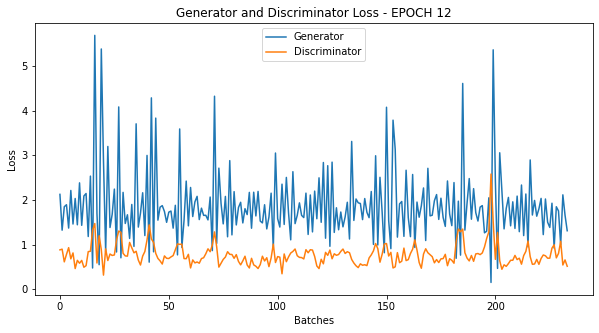

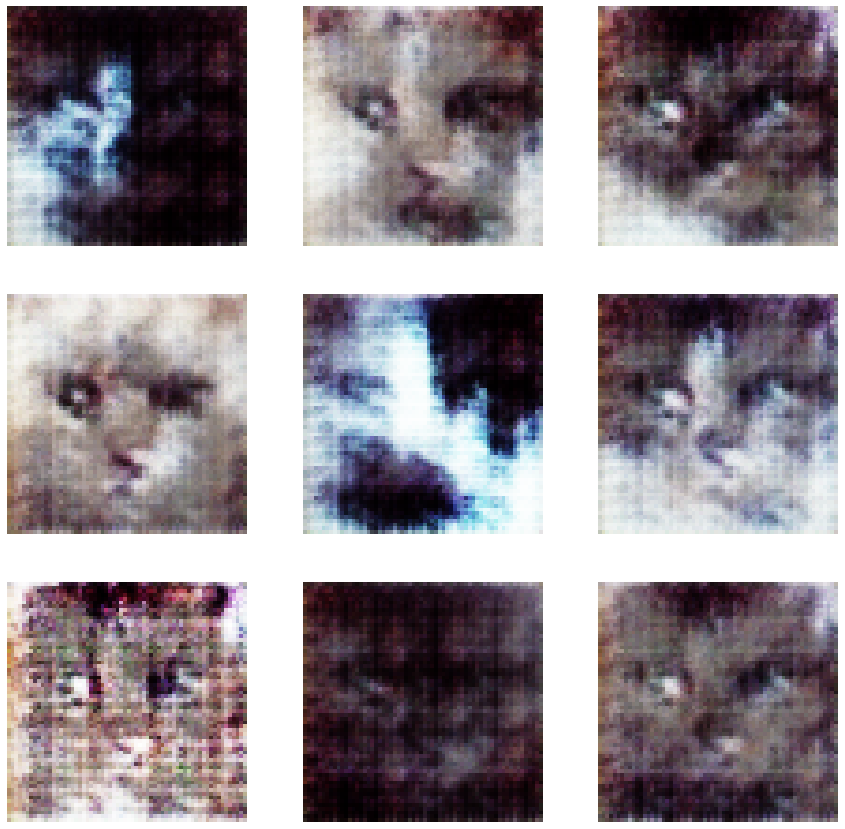

 12%|█▏        | 12/100 [11:24<1:23:30, 56.94s/it]

Epoch: 12 computed for 57.28291654586792 sec


 13%|█▎        | 13/100 [12:20<1:22:14, 56.72s/it]

Epoch: 13 computed for 56.221264362335205 sec


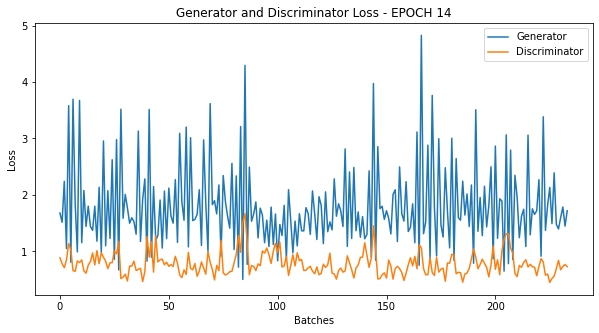

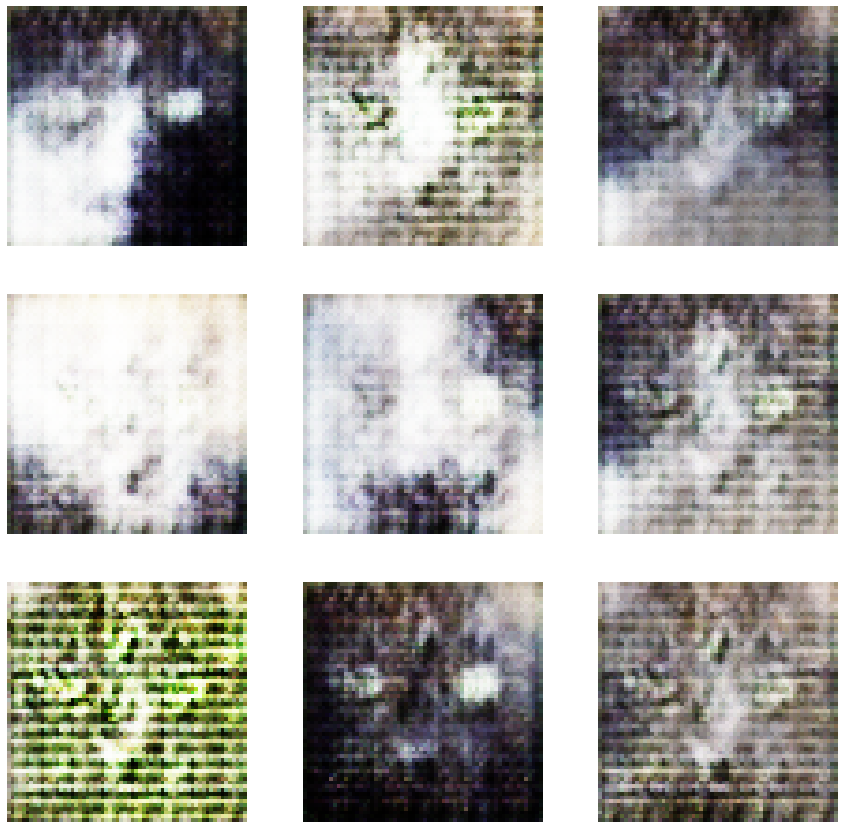

 14%|█▍        | 14/100 [13:17<1:21:29, 56.86s/it]

Epoch: 14 computed for 57.16731595993042 sec


 15%|█▌        | 15/100 [14:13<1:20:18, 56.69s/it]

Epoch: 15 computed for 56.30015540122986 sec


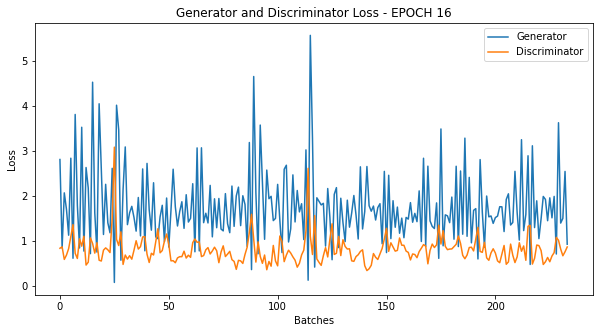

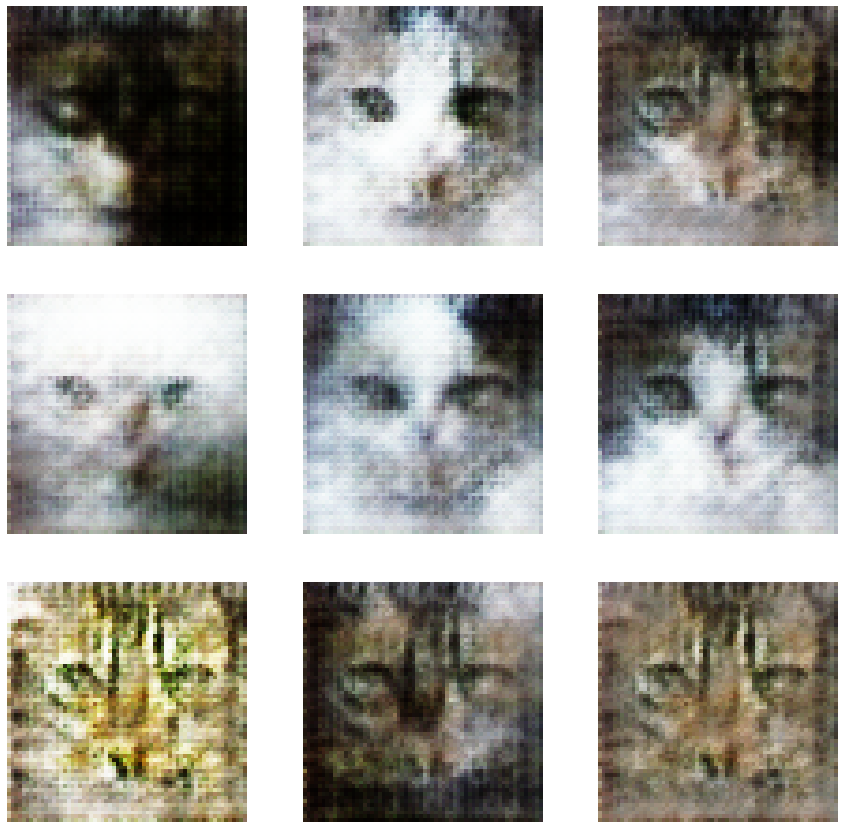

 16%|█▌        | 16/100 [15:11<1:19:33, 56.83s/it]

Epoch: 16 computed for 57.15491008758545 sec


 17%|█▋        | 17/100 [16:07<1:18:22, 56.65s/it]

Epoch: 17 computed for 56.241162061691284 sec


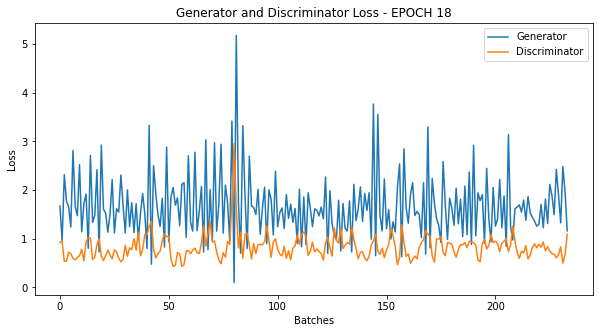

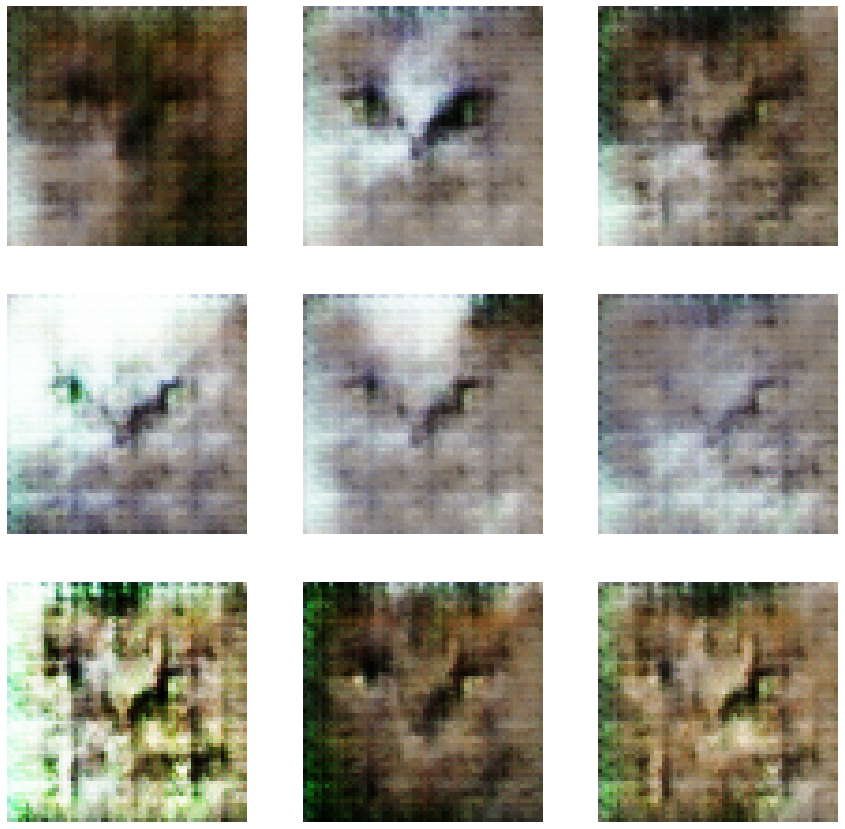

 18%|█▊        | 18/100 [17:04<1:17:40, 56.84s/it]

Epoch: 18 computed for 57.26049017906189 sec


 19%|█▉        | 19/100 [18:00<1:16:25, 56.61s/it]

Epoch: 19 computed for 56.080225229263306 sec


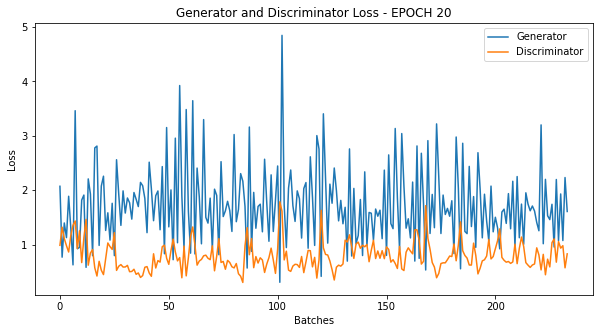

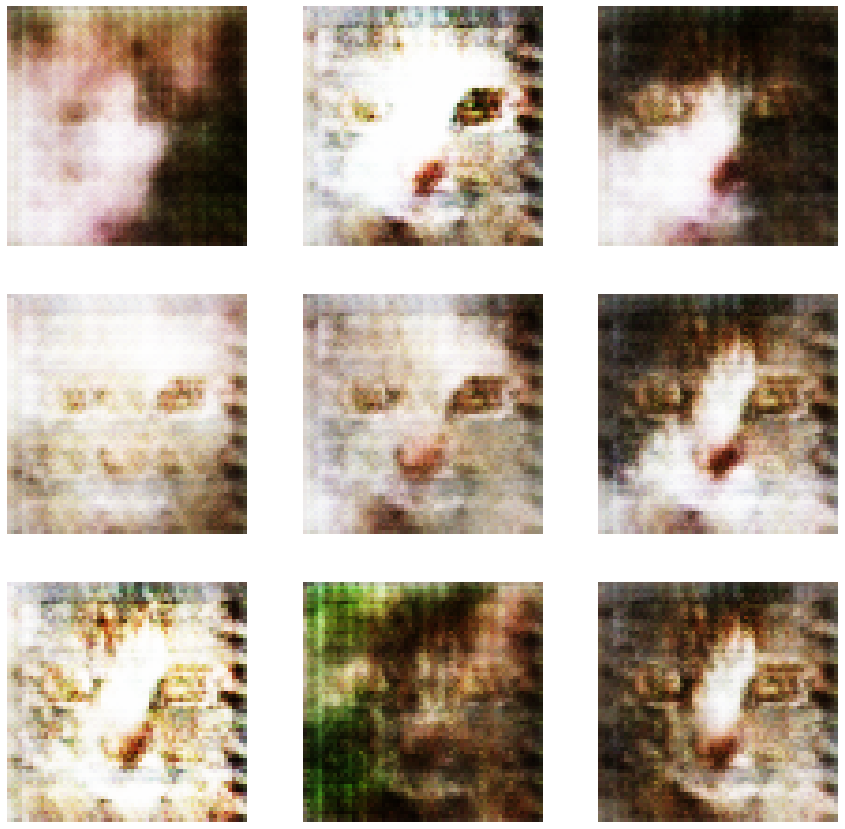

 20%|██        | 20/100 [18:57<1:15:34, 56.68s/it]

Epoch: 20 computed for 56.833434104919434 sec


 21%|██        | 21/100 [19:53<1:14:25, 56.53s/it]

Epoch: 21 computed for 56.171972036361694 sec


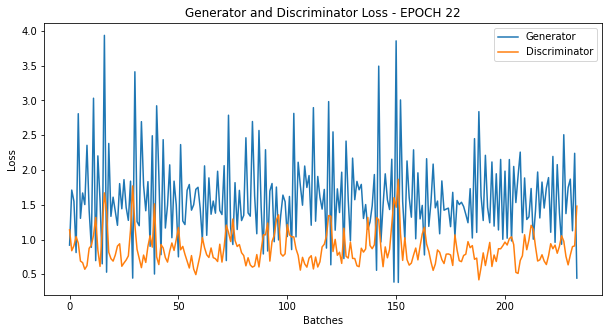

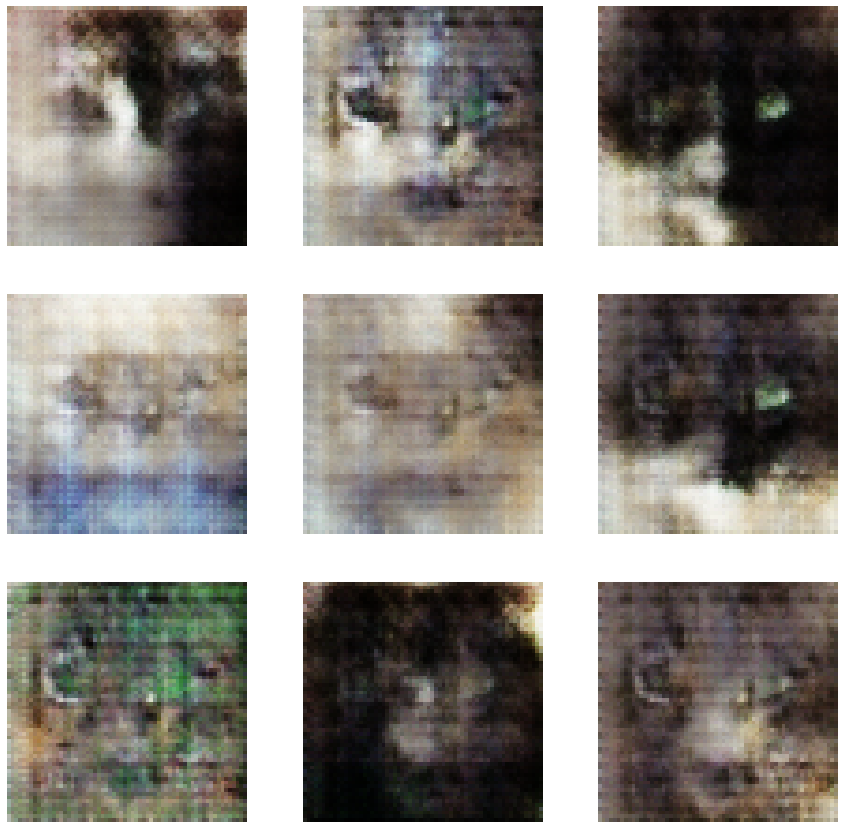

 22%|██▏       | 22/100 [20:50<1:13:34, 56.59s/it]

Epoch: 22 computed for 56.73313879966736 sec


 23%|██▎       | 23/100 [21:46<1:12:26, 56.45s/it]

Epoch: 23 computed for 56.12018322944641 sec


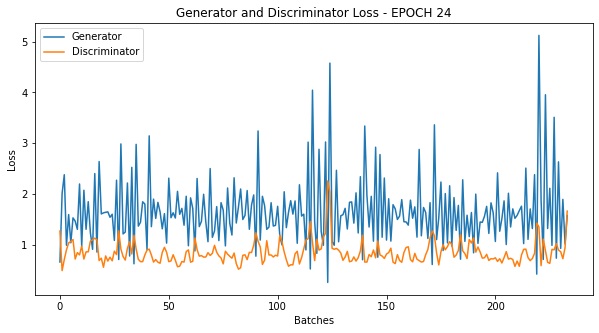

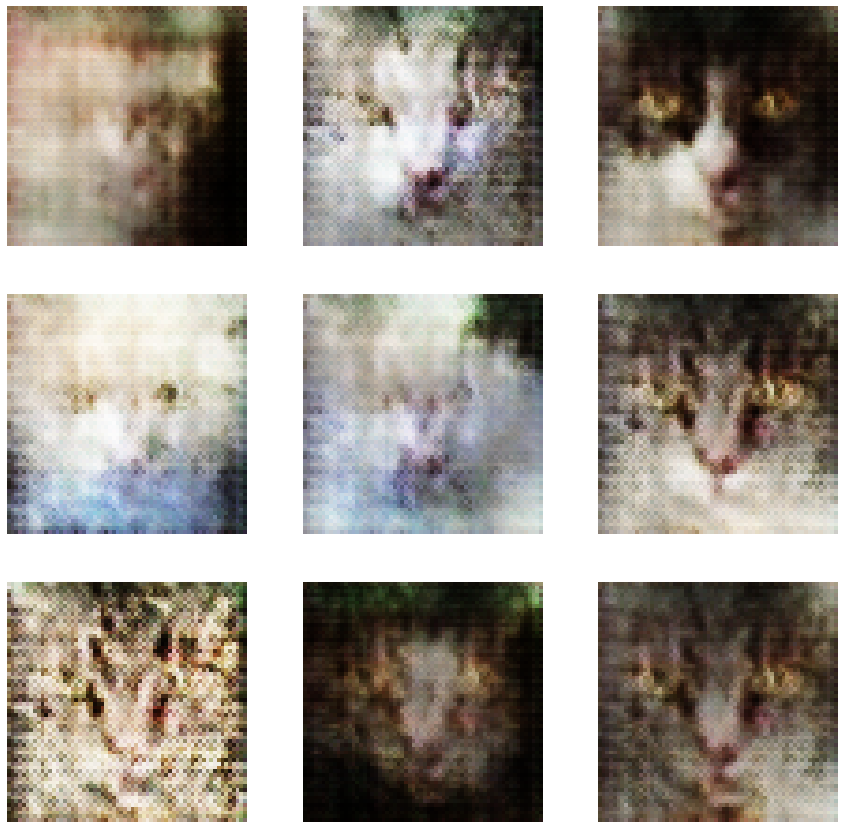

 24%|██▍       | 24/100 [22:43<1:11:40, 56.59s/it]

Epoch: 24 computed for 56.902153730392456 sec


 25%|██▌       | 25/100 [23:39<1:10:24, 56.33s/it]

Epoch: 25 computed for 55.73055648803711 sec


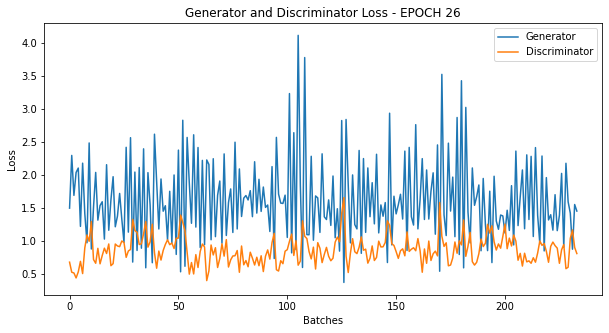

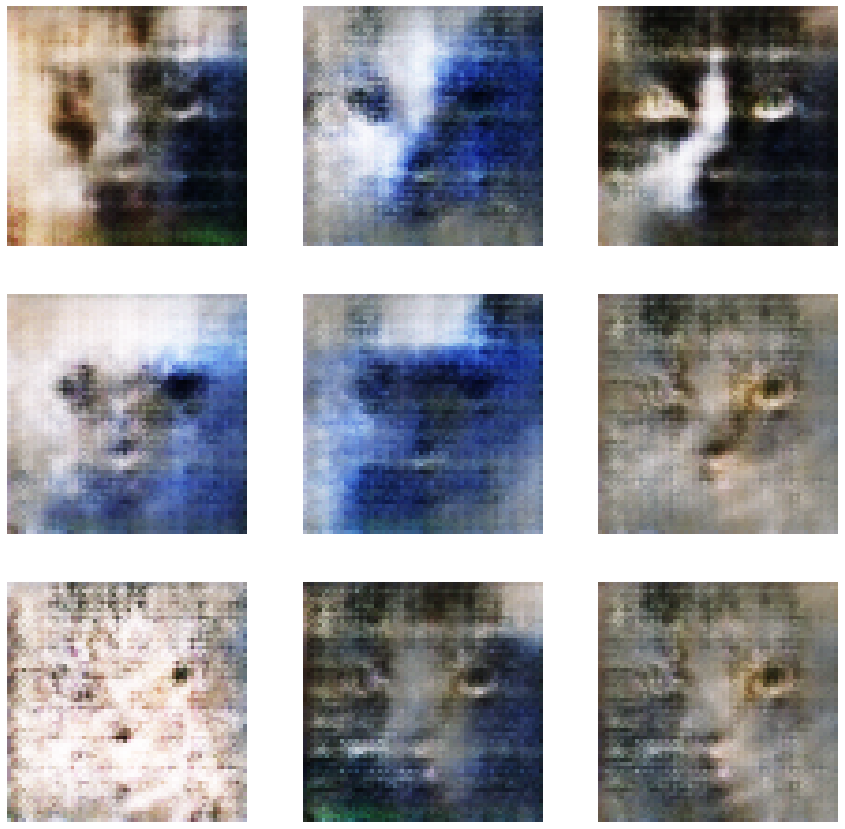

 26%|██▌       | 26/100 [24:35<1:09:38, 56.46s/it]

Epoch: 26 computed for 56.770108222961426 sec


 27%|██▋       | 27/100 [25:32<1:08:31, 56.33s/it]

Epoch: 27 computed for 56.01093554496765 sec


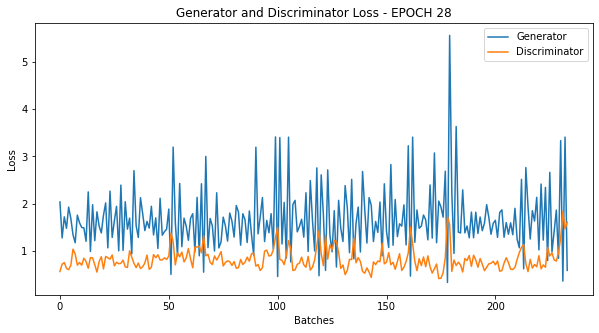

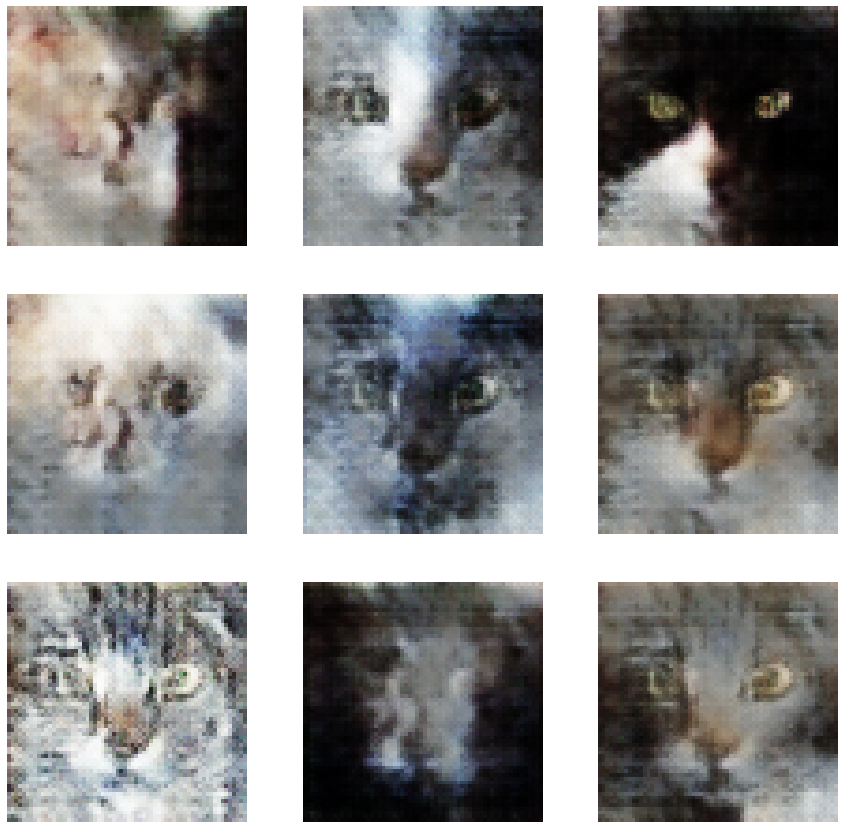

 28%|██▊       | 28/100 [26:28<1:07:45, 56.46s/it]

Epoch: 28 computed for 56.76898694038391 sec


 29%|██▉       | 29/100 [27:24<1:06:39, 56.34s/it]

Epoch: 29 computed for 56.051252126693726 sec


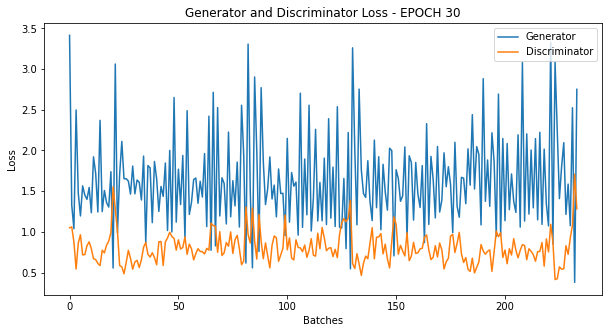

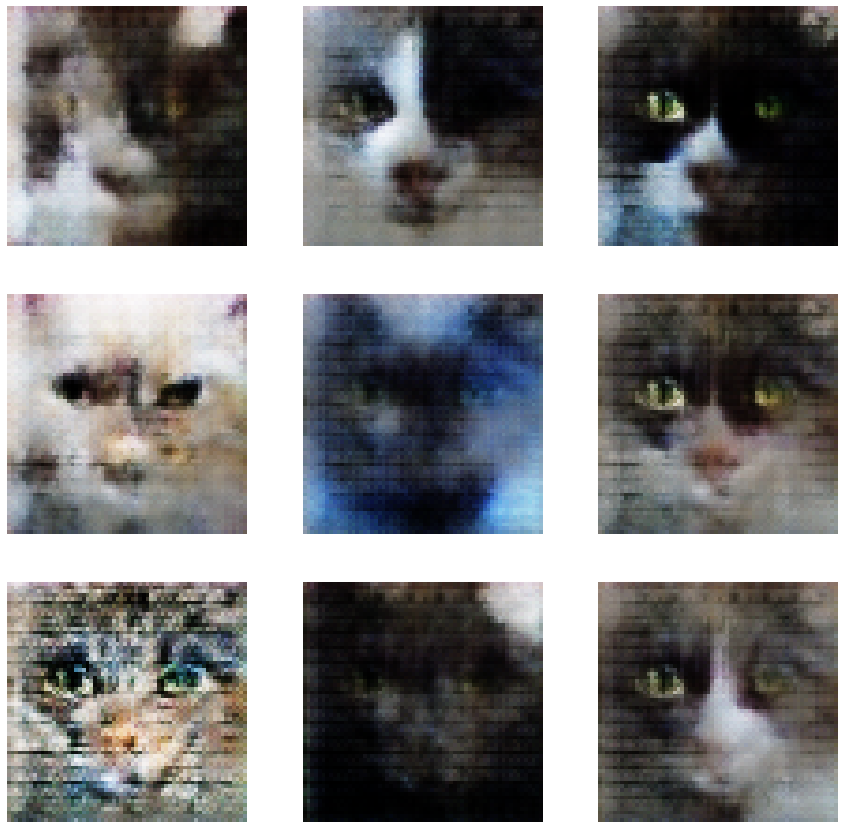

 30%|███       | 30/100 [28:21<1:05:54, 56.49s/it]

Epoch: 30 computed for 56.851816177368164 sec


 31%|███       | 31/100 [29:17<1:04:42, 56.26s/it]

Epoch: 31 computed for 55.72917985916138 sec


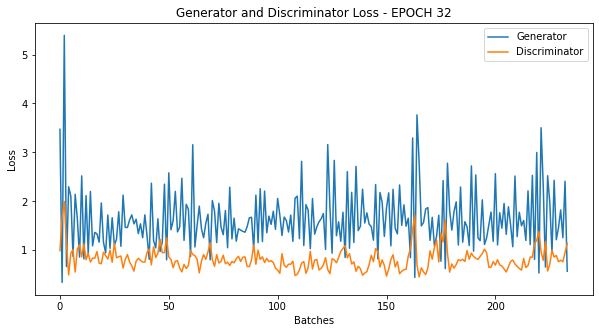

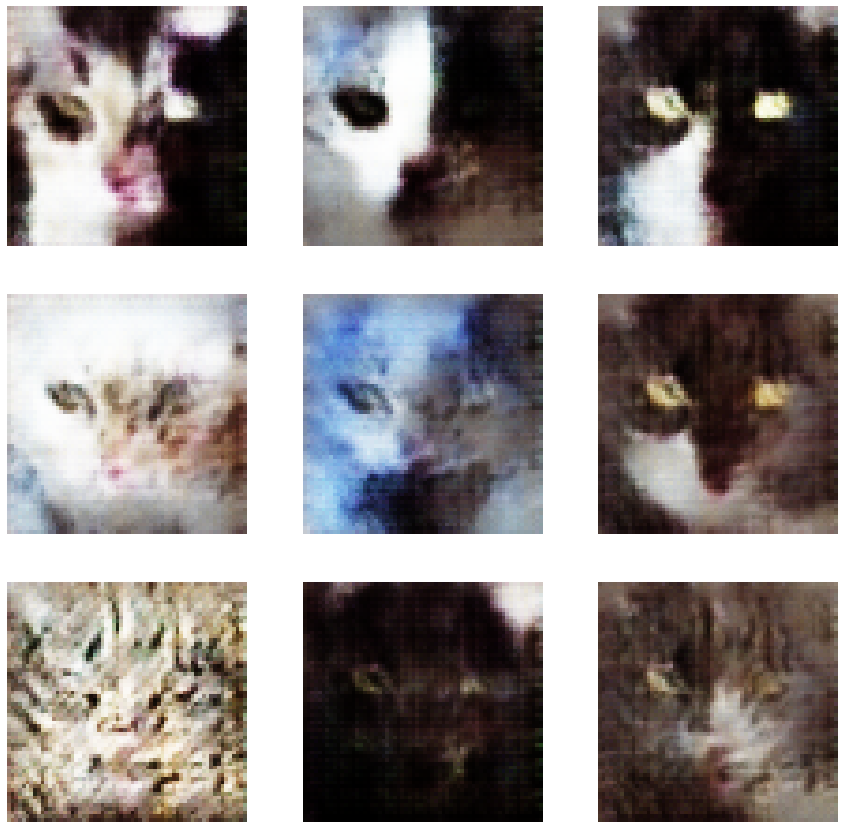

 32%|███▏      | 32/100 [30:14<1:04:00, 56.48s/it]

Epoch: 32 computed for 56.985334157943726 sec


 33%|███▎      | 33/100 [31:10<1:03:00, 56.42s/it]

Epoch: 33 computed for 56.276060342788696 sec


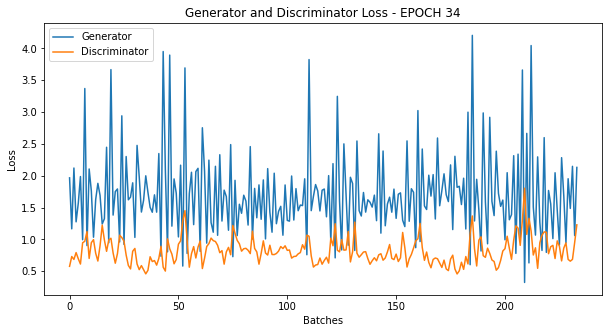

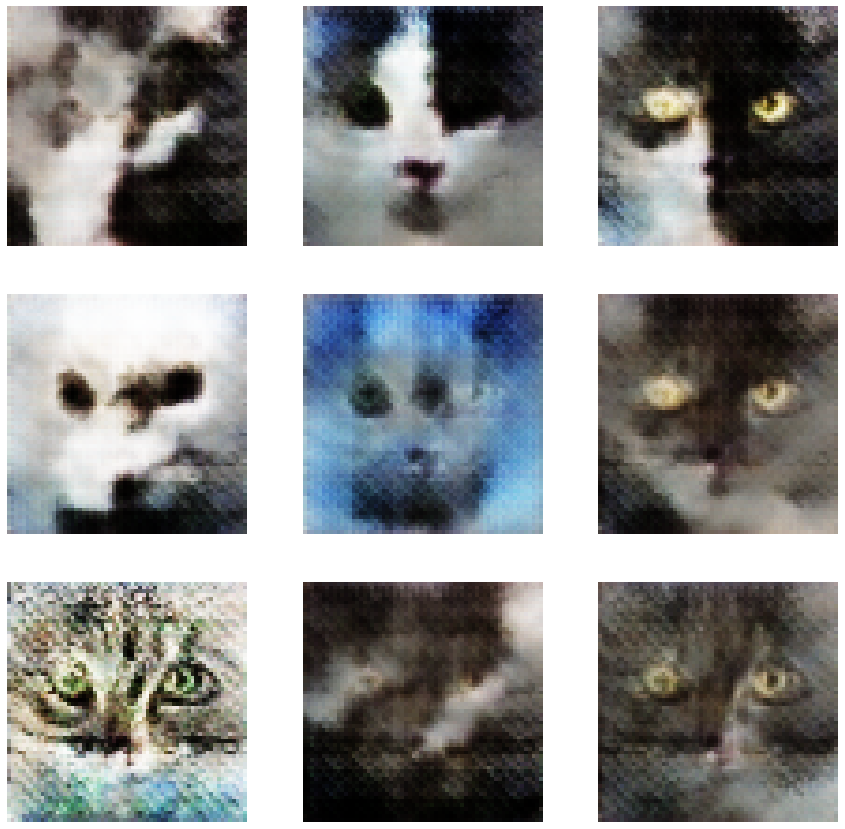

 34%|███▍      | 34/100 [32:08<1:02:22, 56.71s/it]

Epoch: 34 computed for 57.38625907897949 sec


 35%|███▌      | 35/100 [33:04<1:01:14, 56.52s/it]

Epoch: 35 computed for 56.08614802360535 sec


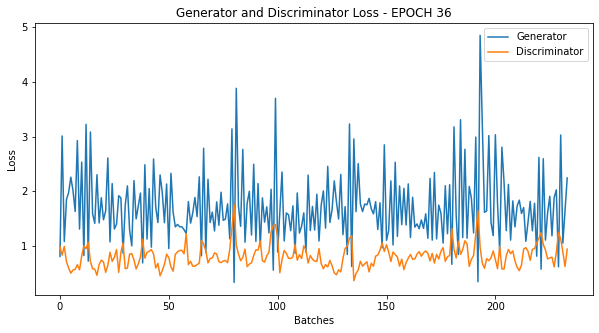

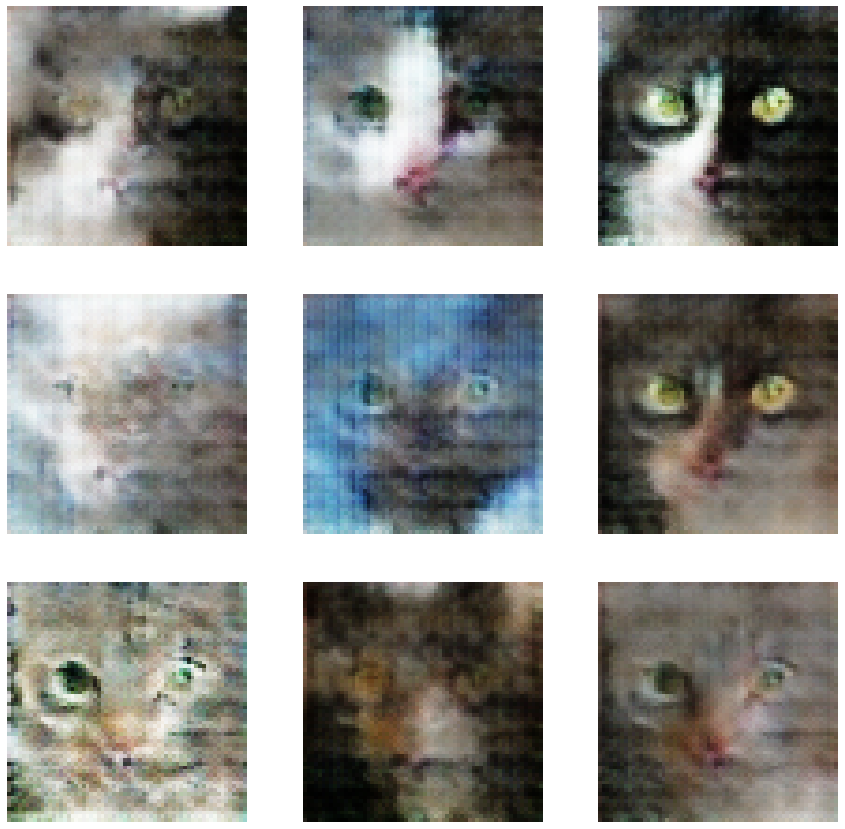

 36%|███▌      | 36/100 [34:02<1:00:51, 57.06s/it]

Epoch: 36 computed for 58.29710650444031 sec


 37%|███▋      | 37/100 [34:58<59:32, 56.71s/it]  

Epoch: 37 computed for 55.8905303478241 sec


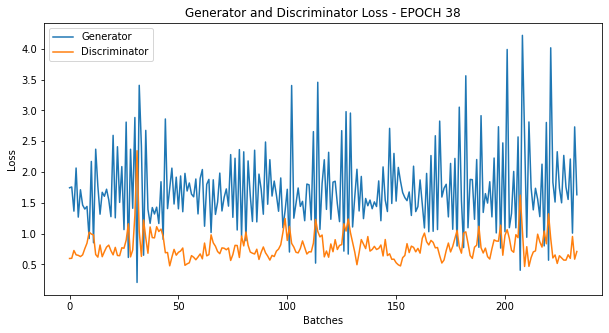

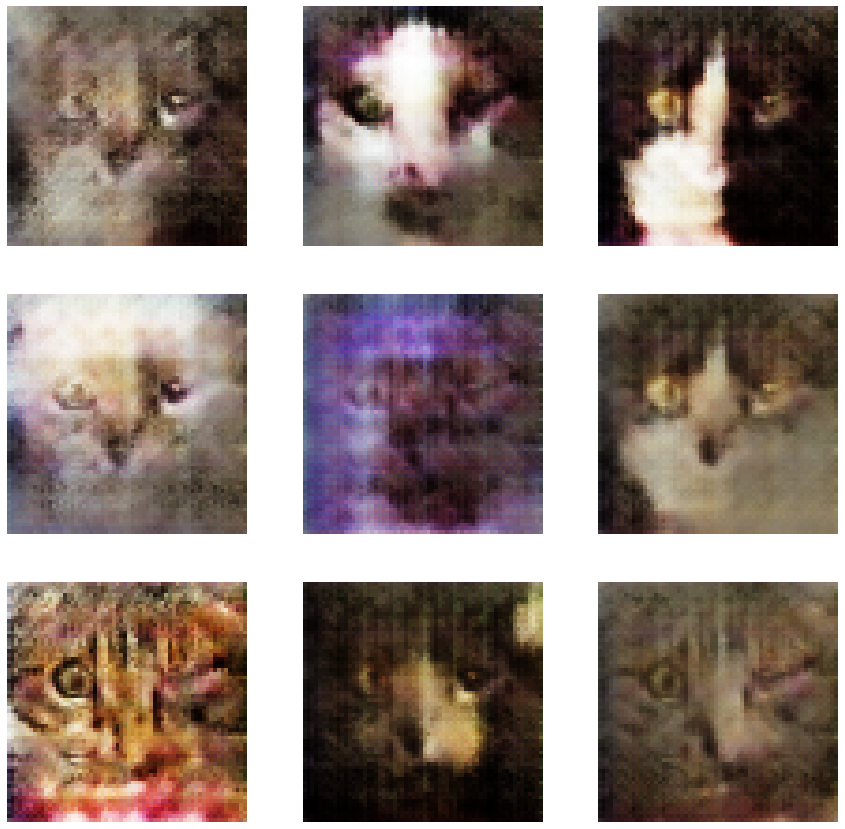

 38%|███▊      | 38/100 [35:55<58:36, 56.71s/it]

Epoch: 38 computed for 56.726179361343384 sec


 39%|███▉      | 39/100 [36:50<57:21, 56.41s/it]

Epoch: 39 computed for 55.710668325424194 sec


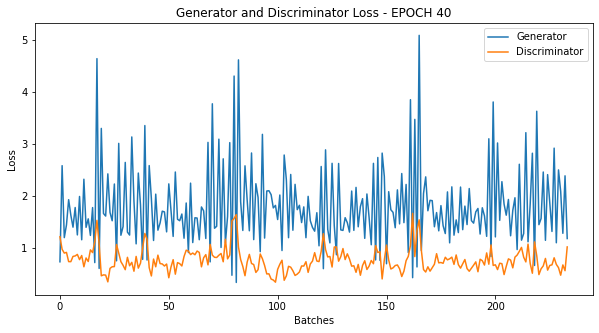

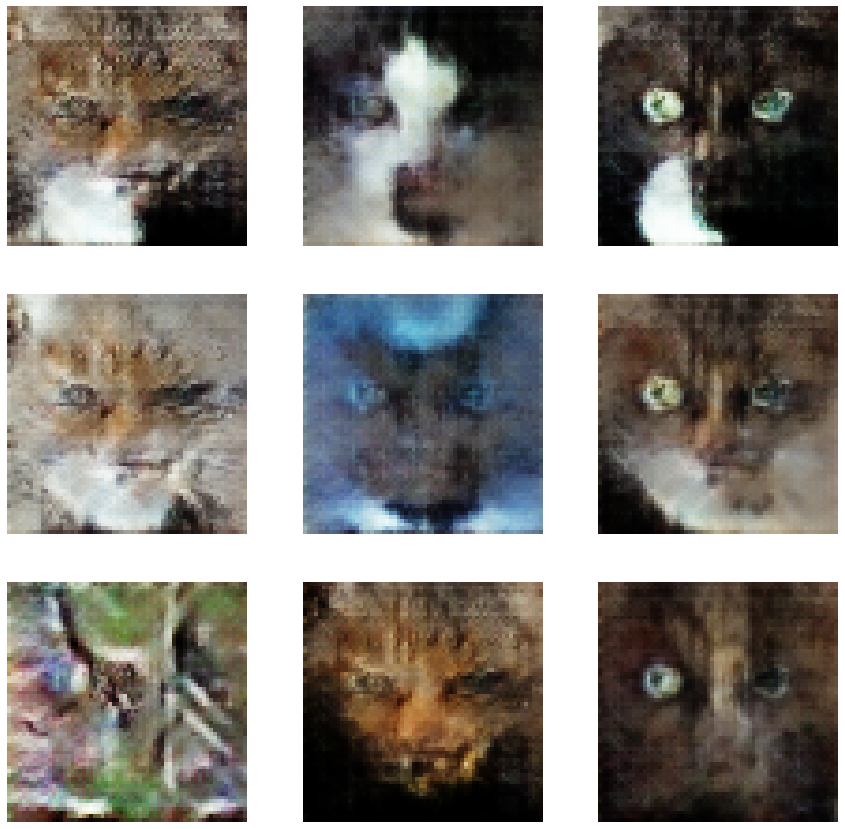

 40%|████      | 40/100 [37:47<56:33, 56.55s/it]

Epoch: 40 computed for 56.87584733963013 sec


 41%|████      | 41/100 [38:43<55:21, 56.29s/it]

Epoch: 41 computed for 55.687960386276245 sec


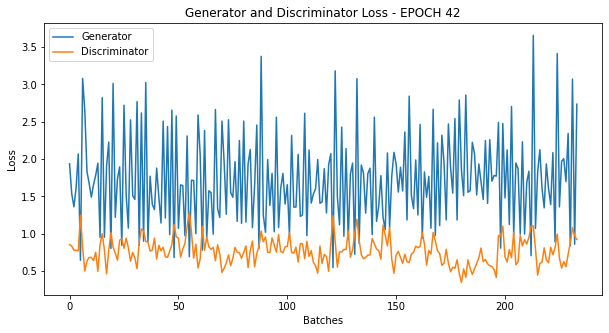

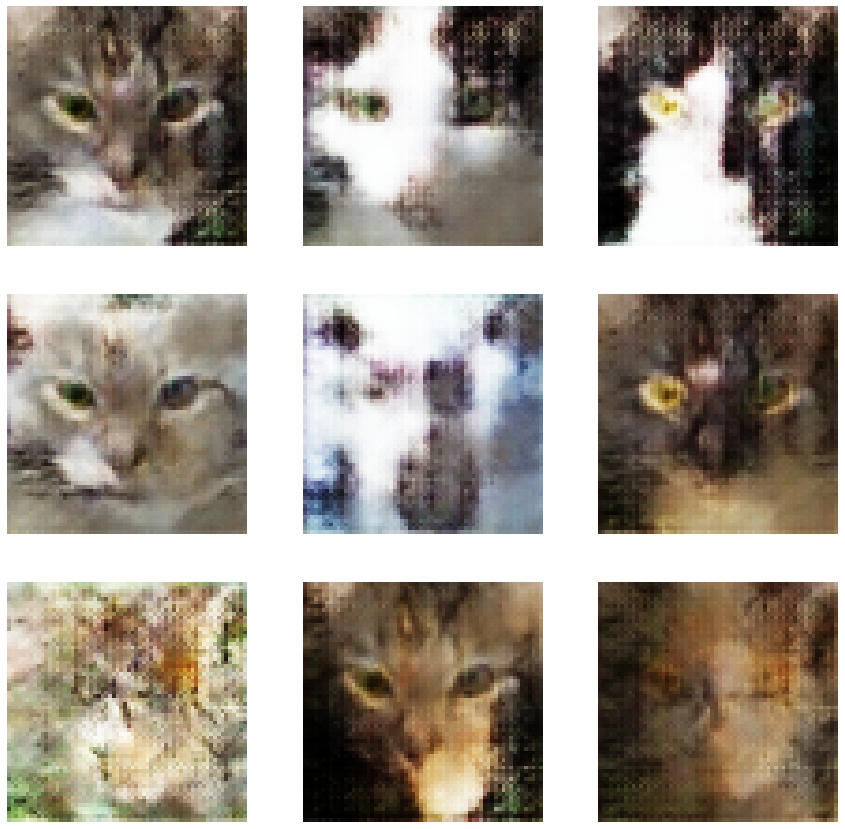

 42%|████▏     | 42/100 [39:39<54:29, 56.38s/it]

Epoch: 42 computed for 56.56702470779419 sec


 43%|████▎     | 43/100 [40:35<53:22, 56.19s/it]

Epoch: 43 computed for 55.73988056182861 sec


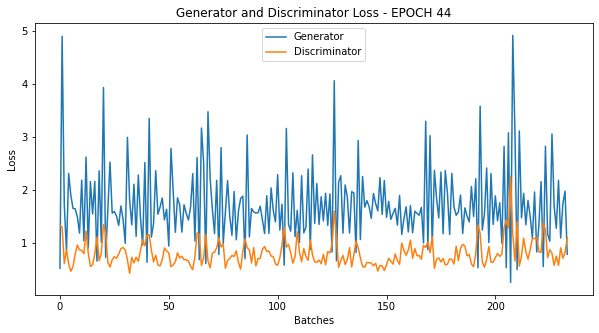

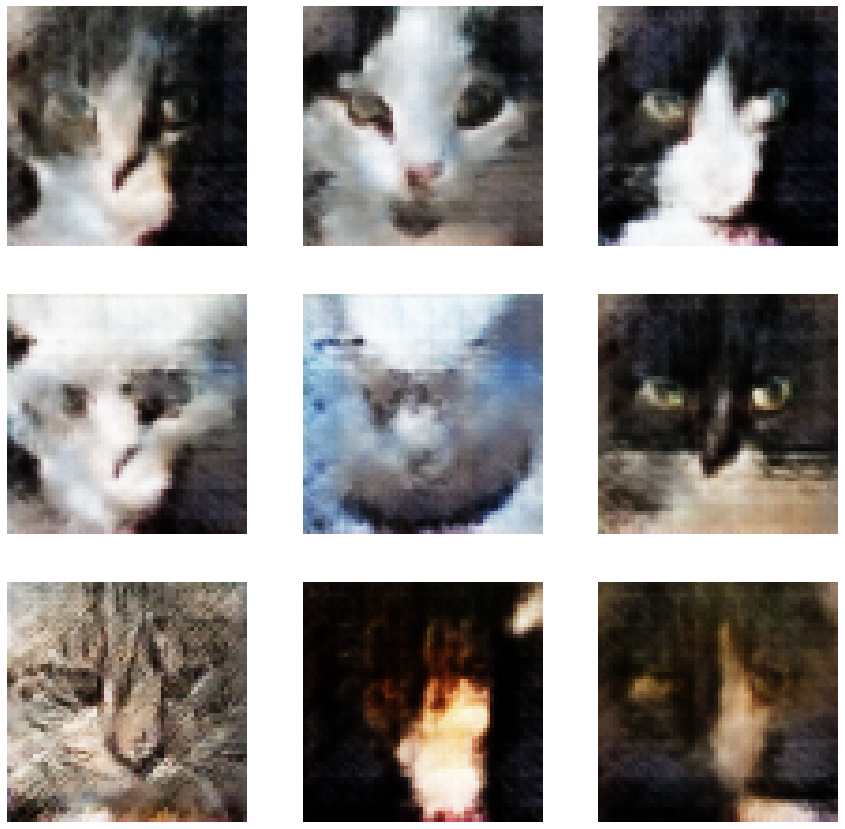

 44%|████▍     | 44/100 [41:32<52:36, 56.37s/it]

Epoch: 44 computed for 56.8081636428833 sec


 45%|████▌     | 45/100 [42:28<51:29, 56.18s/it]

Epoch: 45 computed for 55.71819353103638 sec


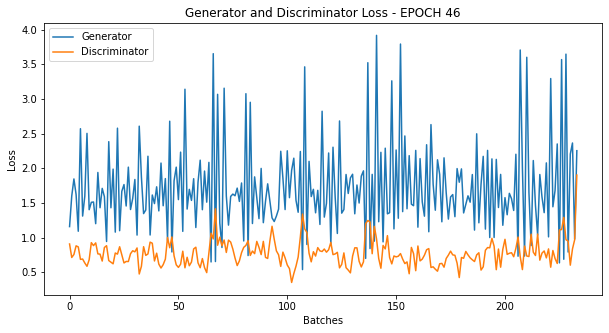

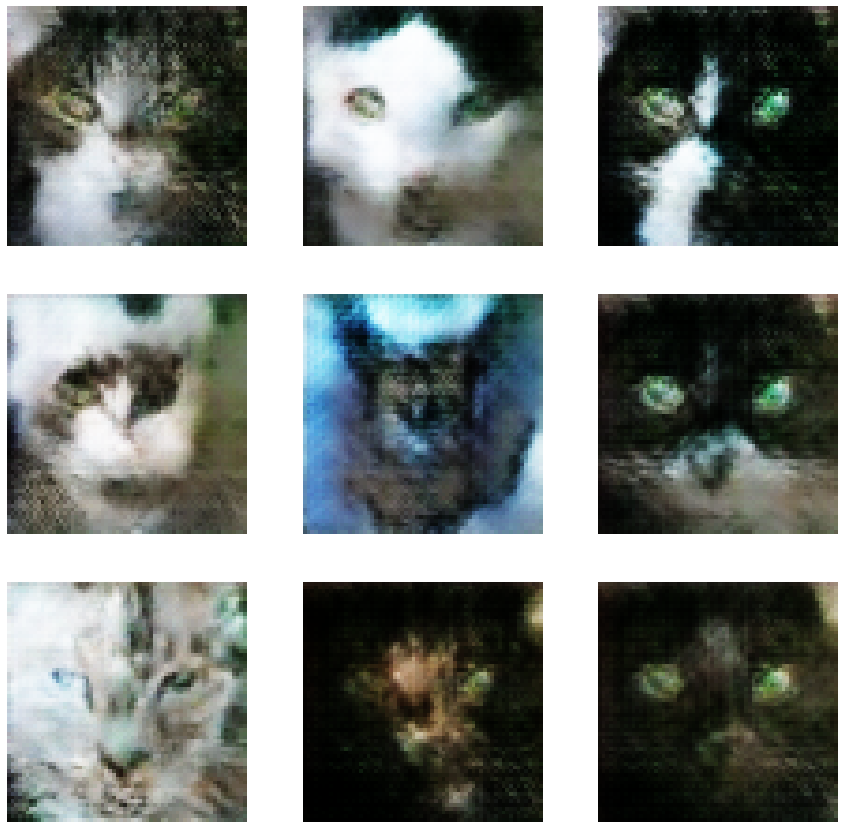

 46%|████▌     | 46/100 [43:24<50:40, 56.31s/it]

Epoch: 46 computed for 56.62730932235718 sec


 47%|████▋     | 47/100 [44:20<49:39, 56.22s/it]

Epoch: 47 computed for 56.01671886444092 sec


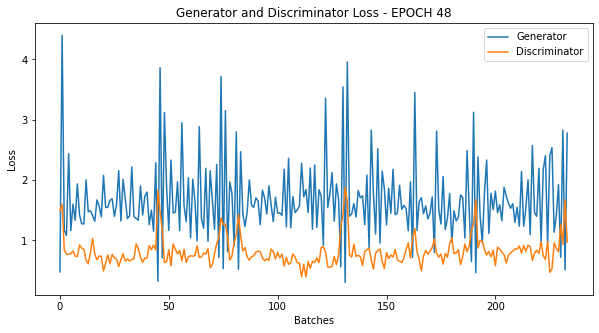

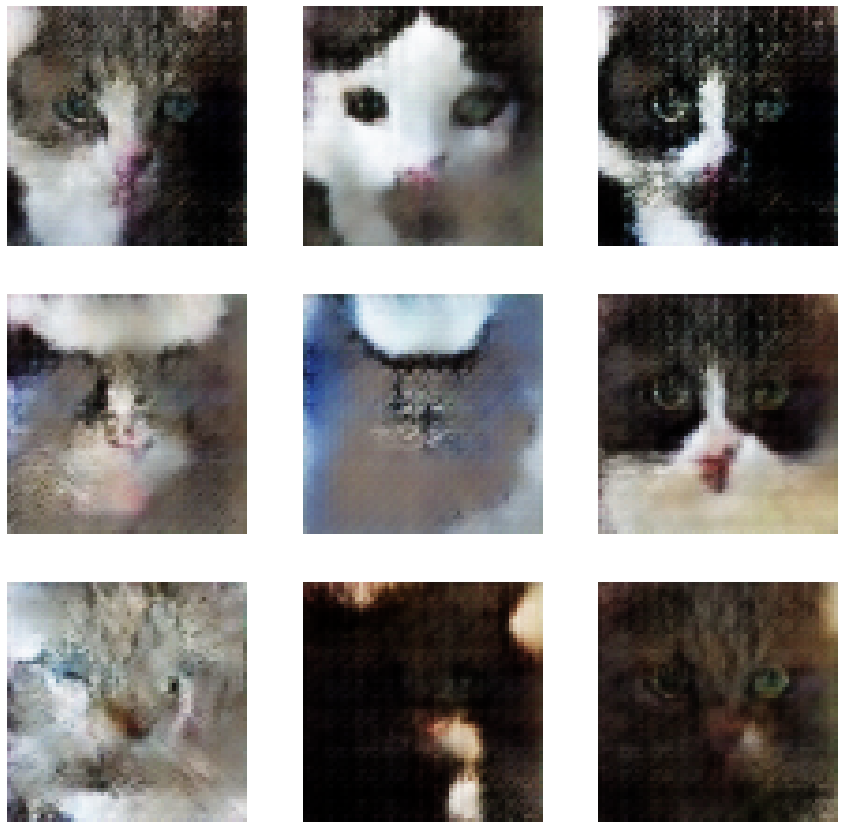

 48%|████▊     | 48/100 [45:17<48:49, 56.33s/it]

Epoch: 48 computed for 56.583364725112915 sec


 49%|████▉     | 49/100 [46:13<47:47, 56.22s/it]

Epoch: 49 computed for 55.96859574317932 sec


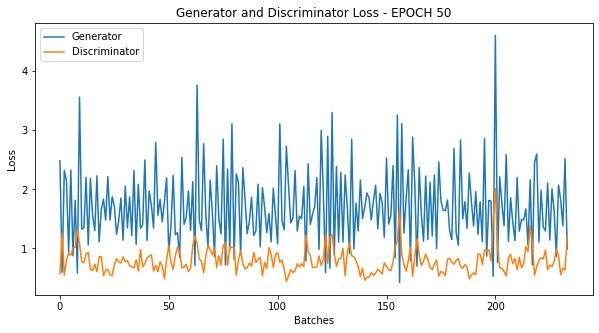

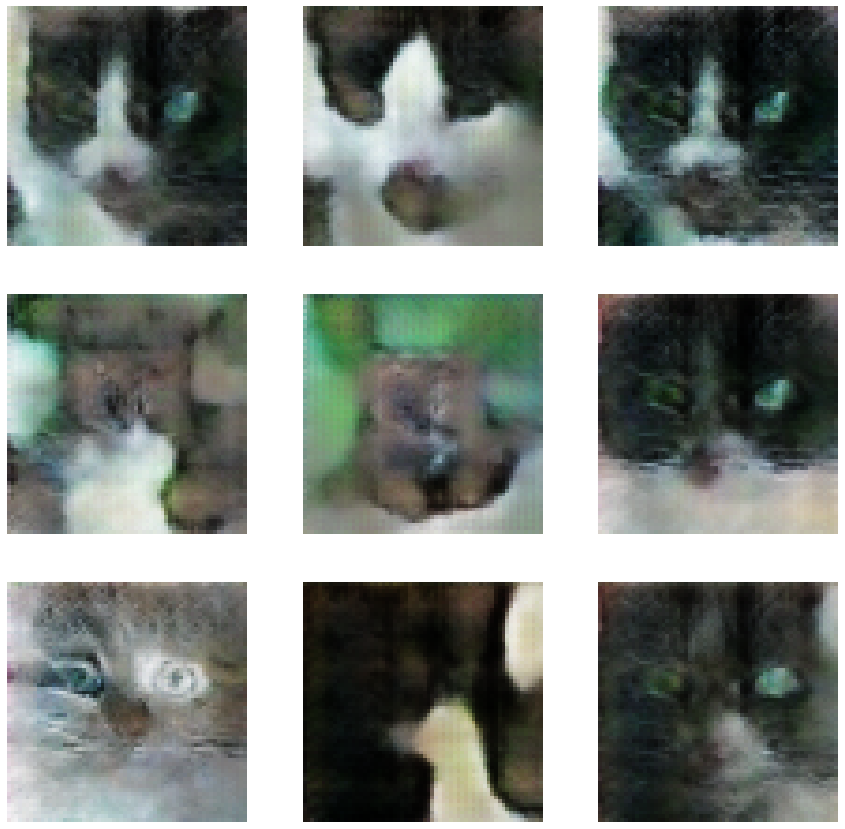

 50%|█████     | 50/100 [47:09<46:55, 56.30s/it]

Epoch: 50 computed for 56.480666637420654 sec


 51%|█████     | 51/100 [48:05<45:51, 56.15s/it]

Epoch: 51 computed for 55.79782438278198 sec


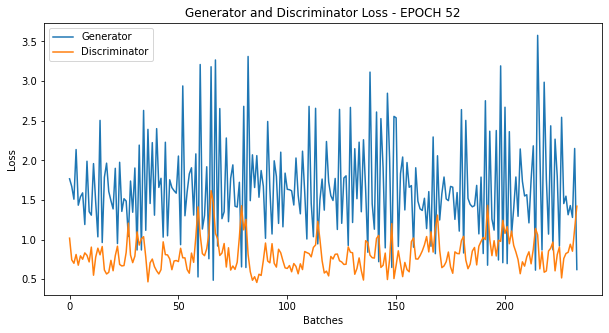

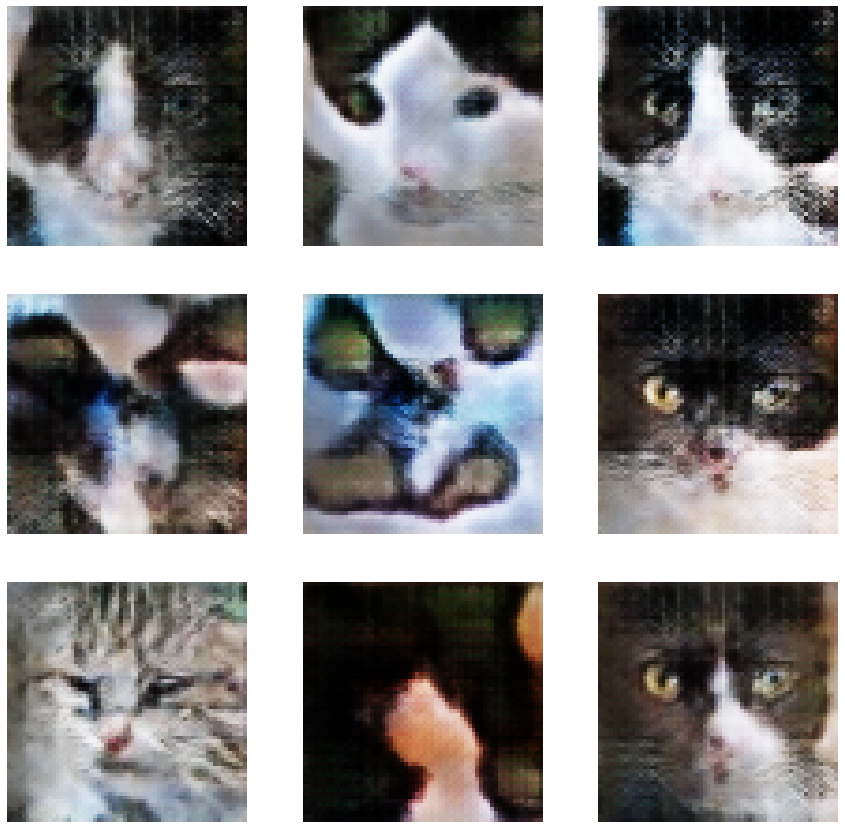

 52%|█████▏    | 52/100 [49:02<44:59, 56.24s/it]

Epoch: 52 computed for 56.44921565055847 sec


 53%|█████▎    | 53/100 [49:57<43:52, 56.02s/it]

Epoch: 53 computed for 55.49957823753357 sec


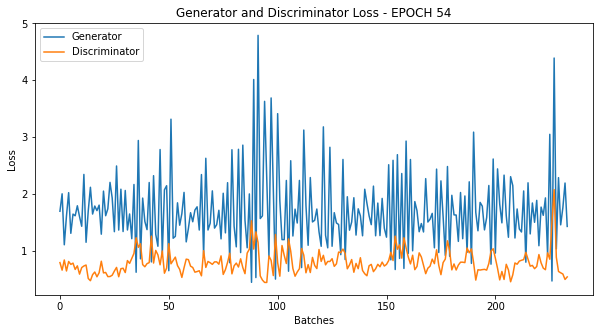

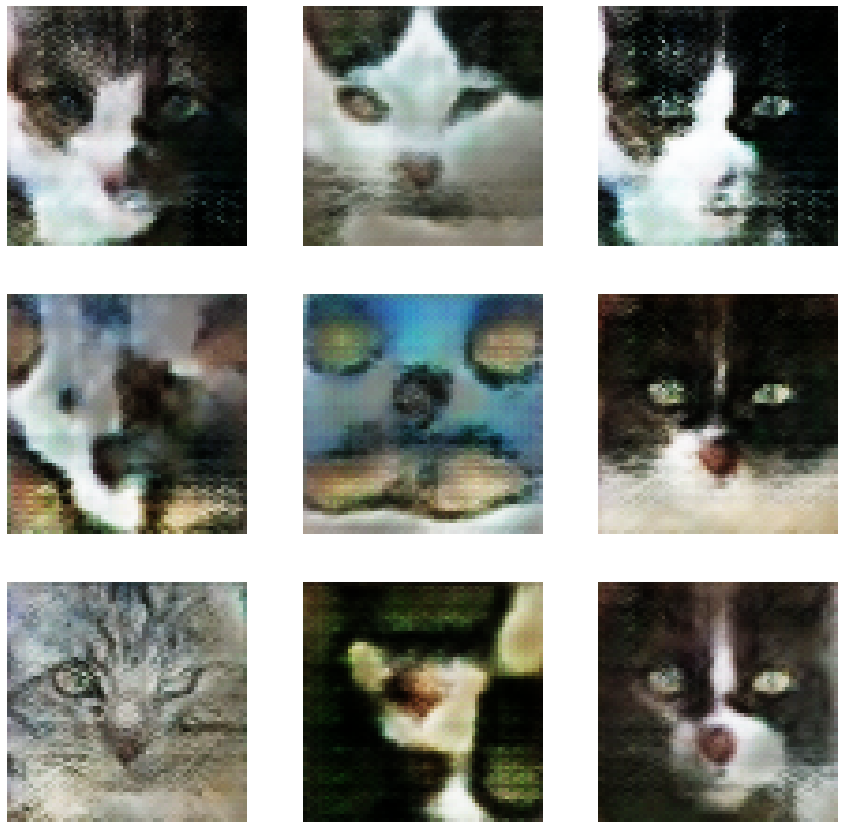

 54%|█████▍    | 54/100 [50:54<43:03, 56.16s/it]

Epoch: 54 computed for 56.468915700912476 sec


 55%|█████▌    | 55/100 [51:49<41:58, 55.96s/it]

Epoch: 55 computed for 55.516566038131714 sec


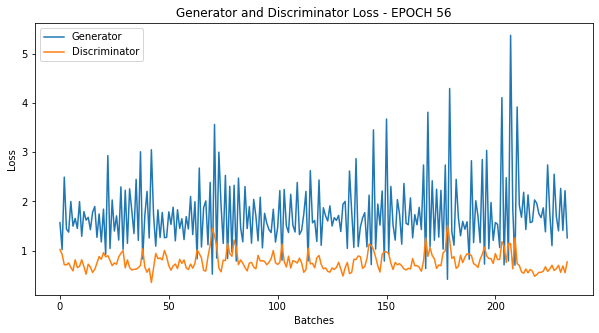

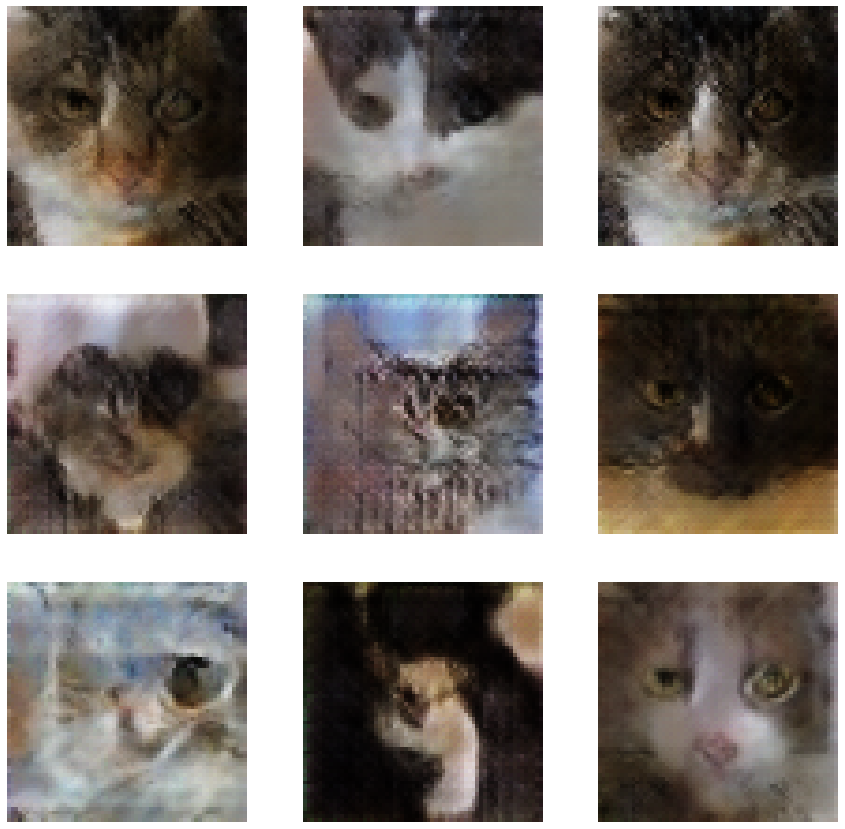

 56%|█████▌    | 56/100 [52:46<41:14, 56.25s/it]

Epoch: 56 computed for 56.91055727005005 sec


 57%|█████▋    | 57/100 [53:42<40:11, 56.09s/it]

Epoch: 57 computed for 55.711249113082886 sec


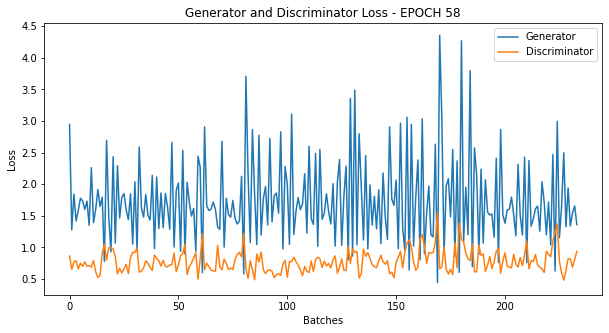

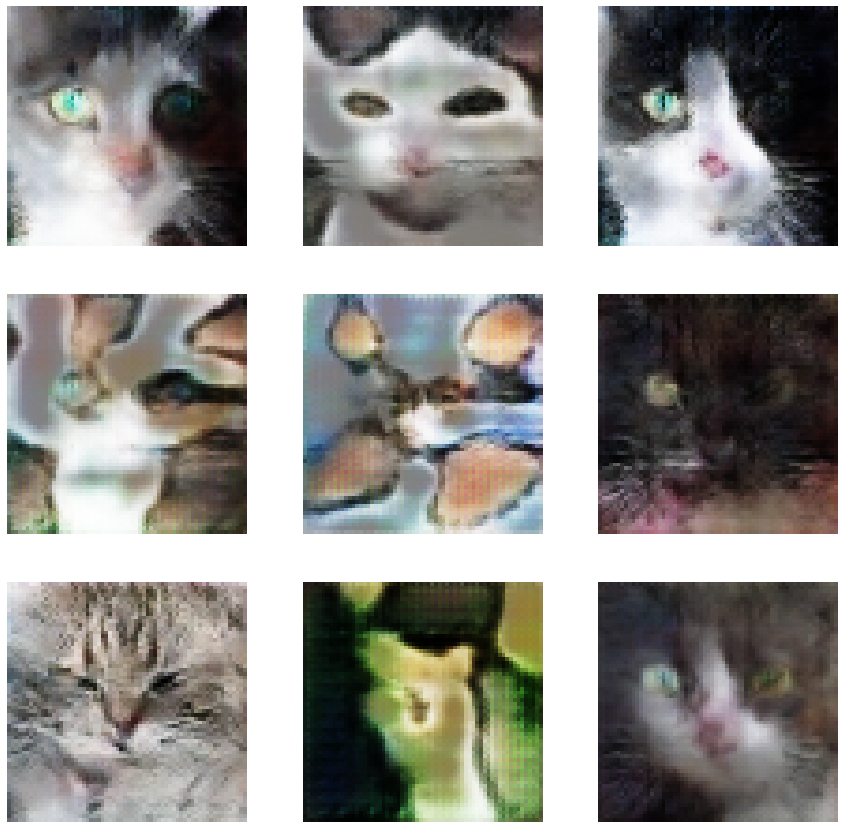

 58%|█████▊    | 58/100 [54:38<39:21, 56.23s/it]

Epoch: 58 computed for 56.54620957374573 sec


 59%|█████▉    | 59/100 [55:34<38:22, 56.17s/it]

Epoch: 59 computed for 56.03322625160217 sec


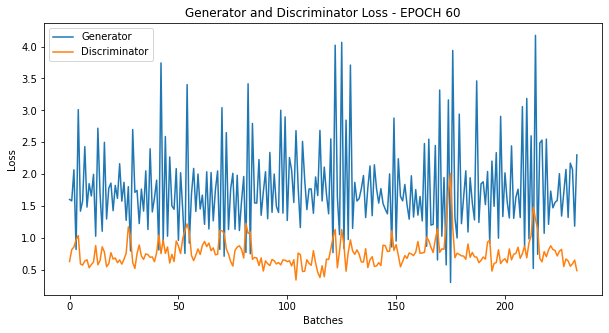

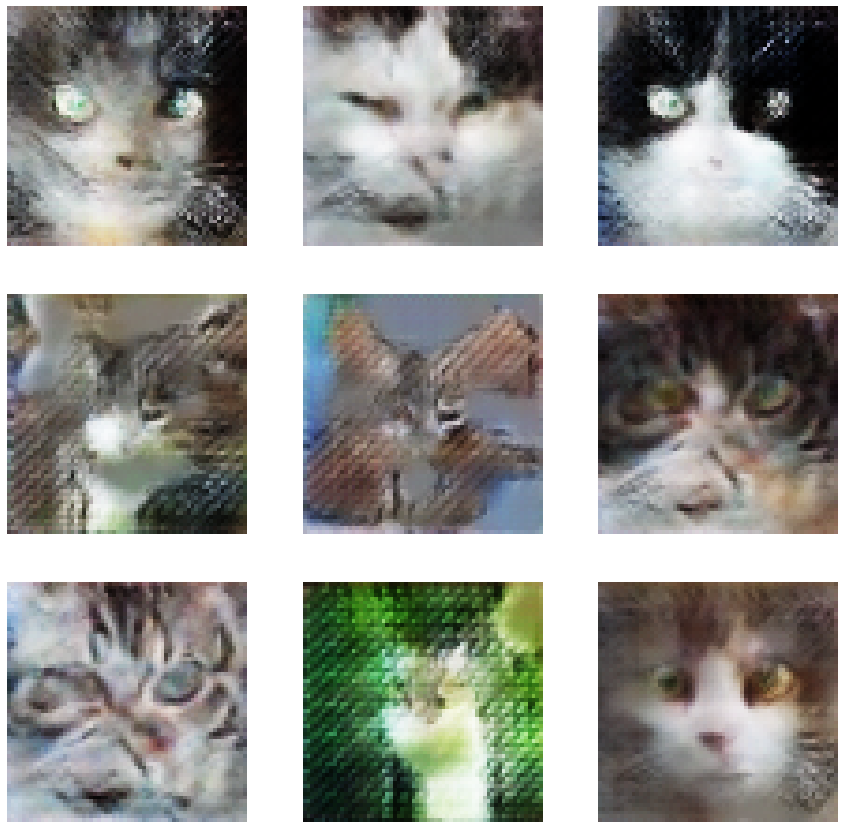

 60%|██████    | 60/100 [56:31<37:28, 56.22s/it]

Epoch: 60 computed for 56.33540368080139 sec


 61%|██████    | 61/100 [57:26<36:26, 56.07s/it]

Epoch: 61 computed for 55.71872806549072 sec


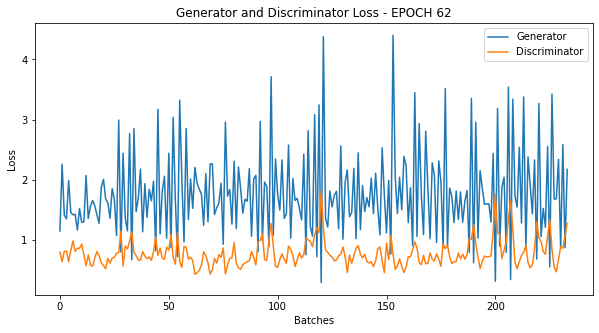

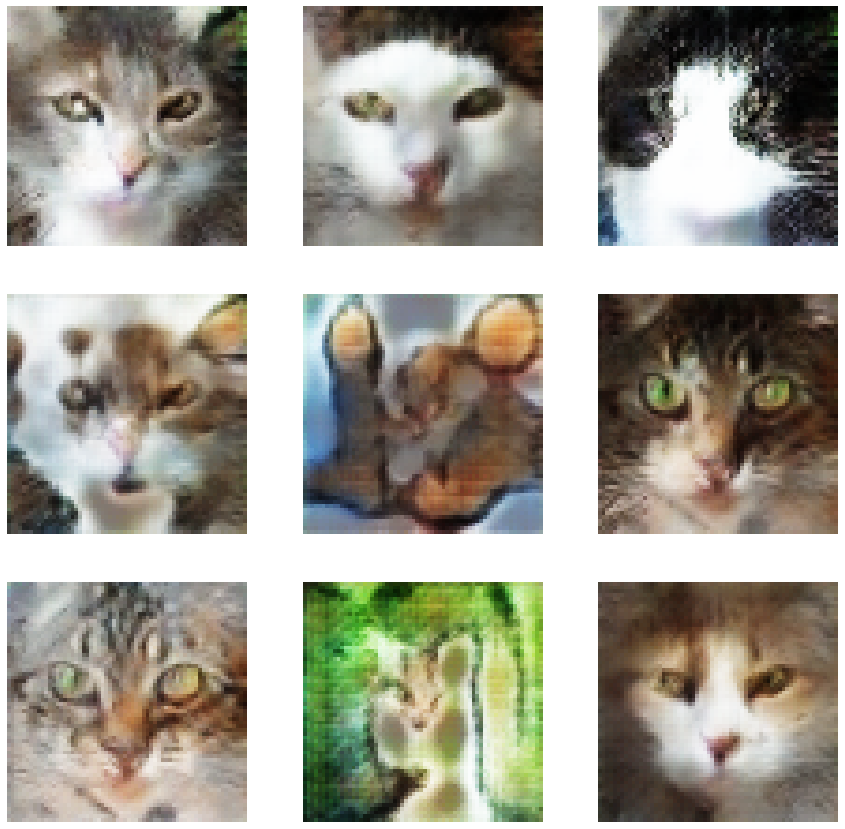

 62%|██████▏   | 62/100 [58:23<35:36, 56.21s/it]

Epoch: 62 computed for 56.55309224128723 sec


 63%|██████▎   | 63/100 [59:19<34:36, 56.12s/it]

Epoch: 63 computed for 55.90518569946289 sec


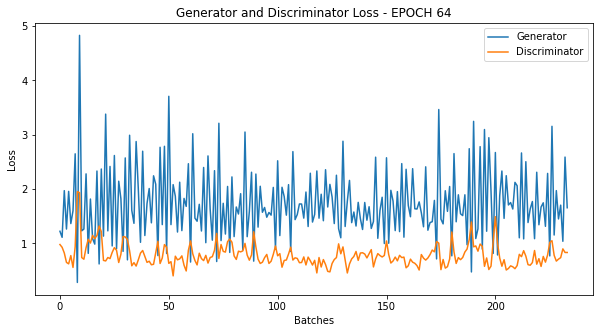

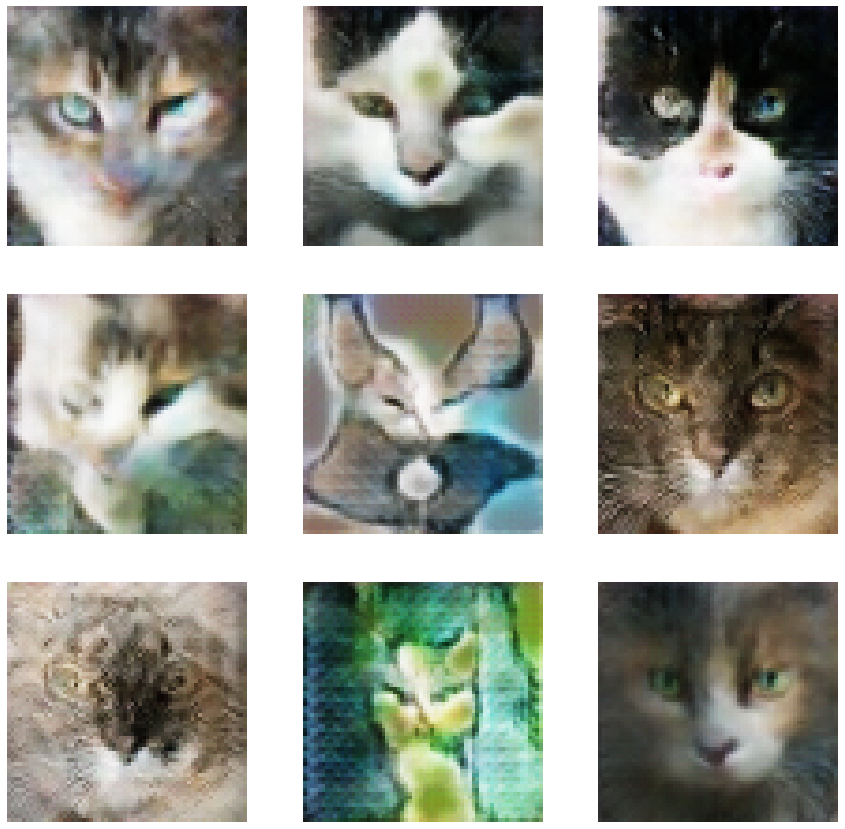

 64%|██████▍   | 64/100 [1:00:15<33:44, 56.23s/it]

Epoch: 64 computed for 56.483290910720825 sec


 65%|██████▌   | 65/100 [1:01:11<32:40, 56.02s/it]

Epoch: 65 computed for 55.537564516067505 sec


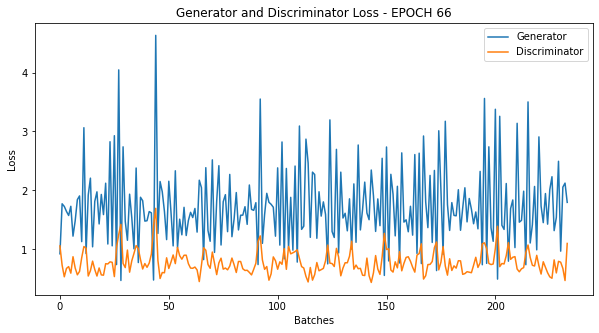

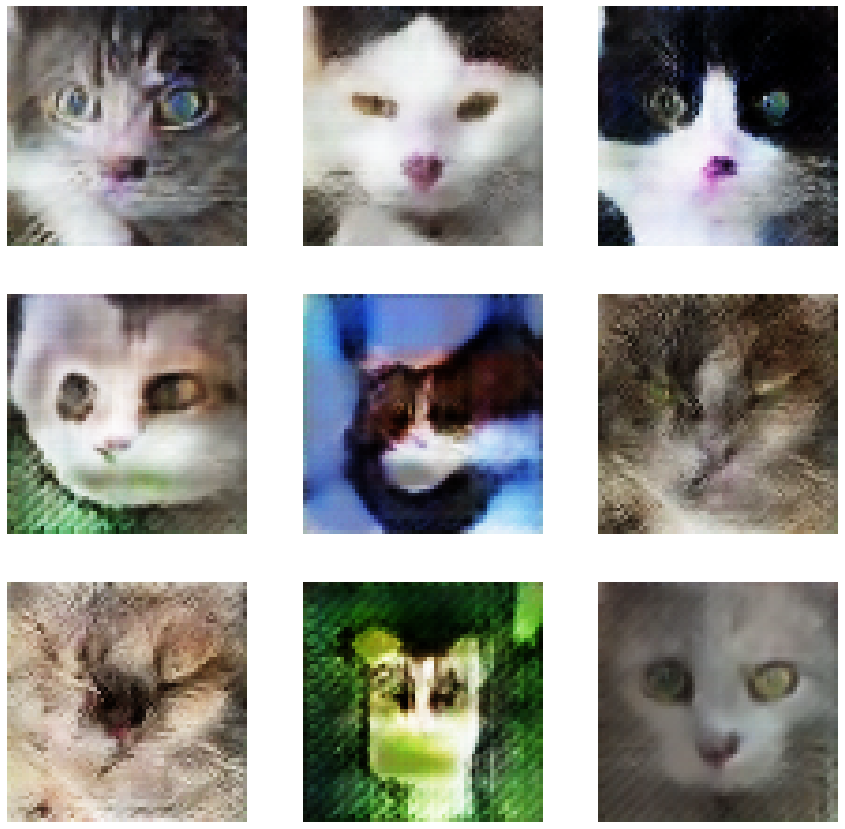

 66%|██████▌   | 66/100 [1:02:07<31:50, 56.18s/it]

Epoch: 66 computed for 56.538045167922974 sec


 67%|██████▋   | 67/100 [1:03:03<30:48, 56.01s/it]

Epoch: 67 computed for 55.60173988342285 sec


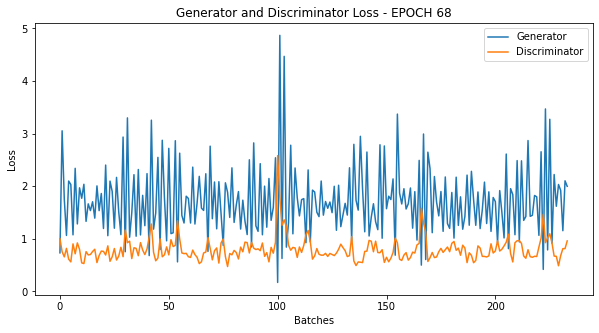

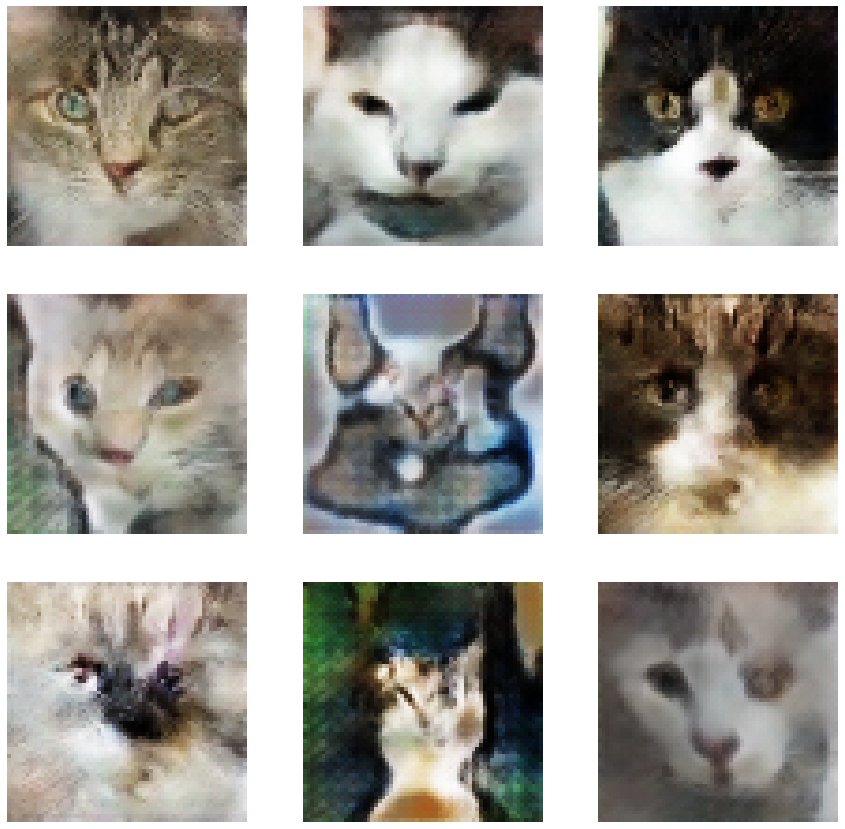

 68%|██████▊   | 68/100 [1:04:00<29:59, 56.22s/it]

Epoch: 68 computed for 56.718318462371826 sec


 69%|██████▉   | 69/100 [1:04:56<29:07, 56.37s/it]

Epoch: 69 computed for 56.72166347503662 sec


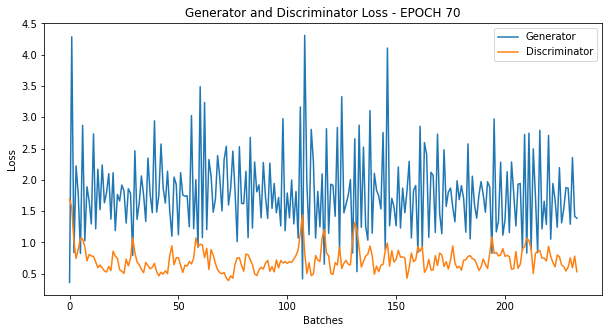

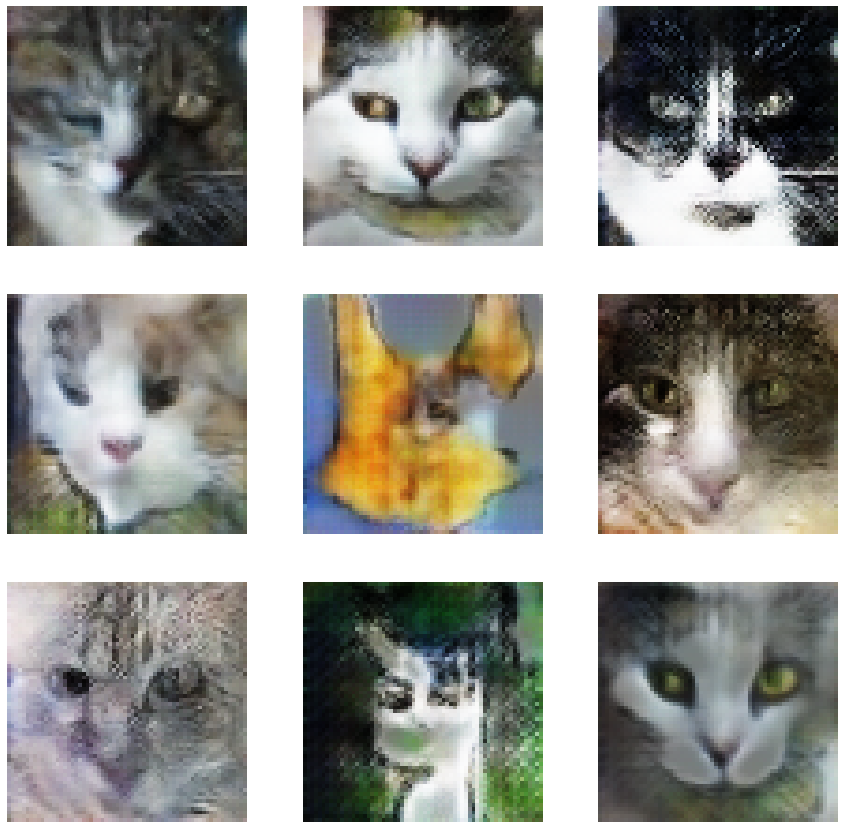

 70%|███████   | 70/100 [1:05:55<28:28, 56.96s/it]

Epoch: 70 computed for 58.34802842140198 sec


 71%|███████   | 71/100 [1:06:52<27:32, 56.97s/it]

Epoch: 71 computed for 56.985644578933716 sec


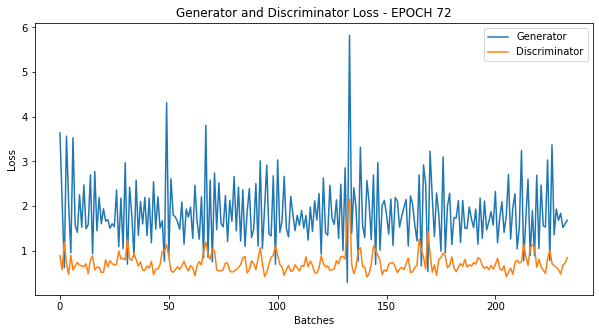

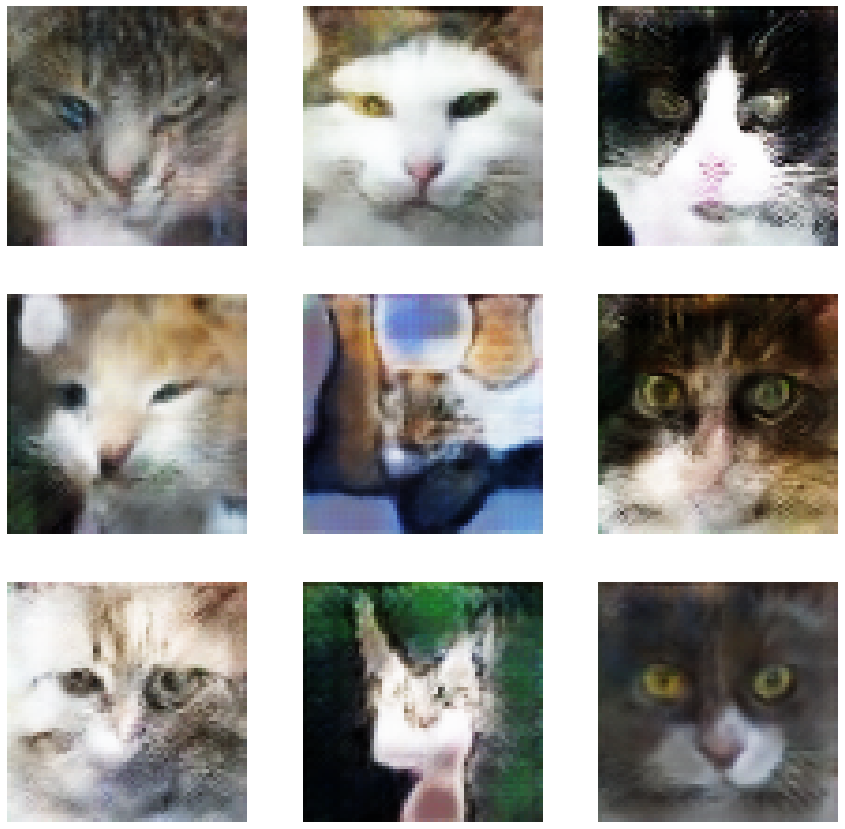

 72%|███████▏  | 72/100 [1:07:49<26:36, 57.02s/it]

Epoch: 72 computed for 57.11916995048523 sec


 73%|███████▎  | 73/100 [1:08:45<25:34, 56.84s/it]

Epoch: 73 computed for 56.44334673881531 sec


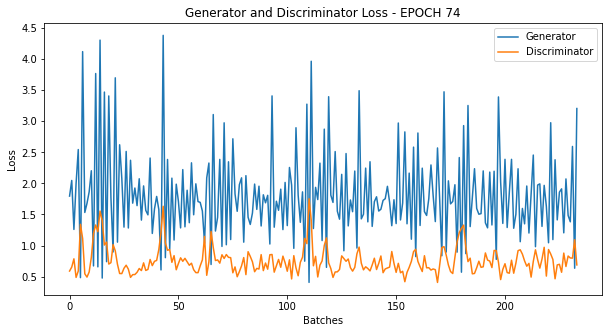

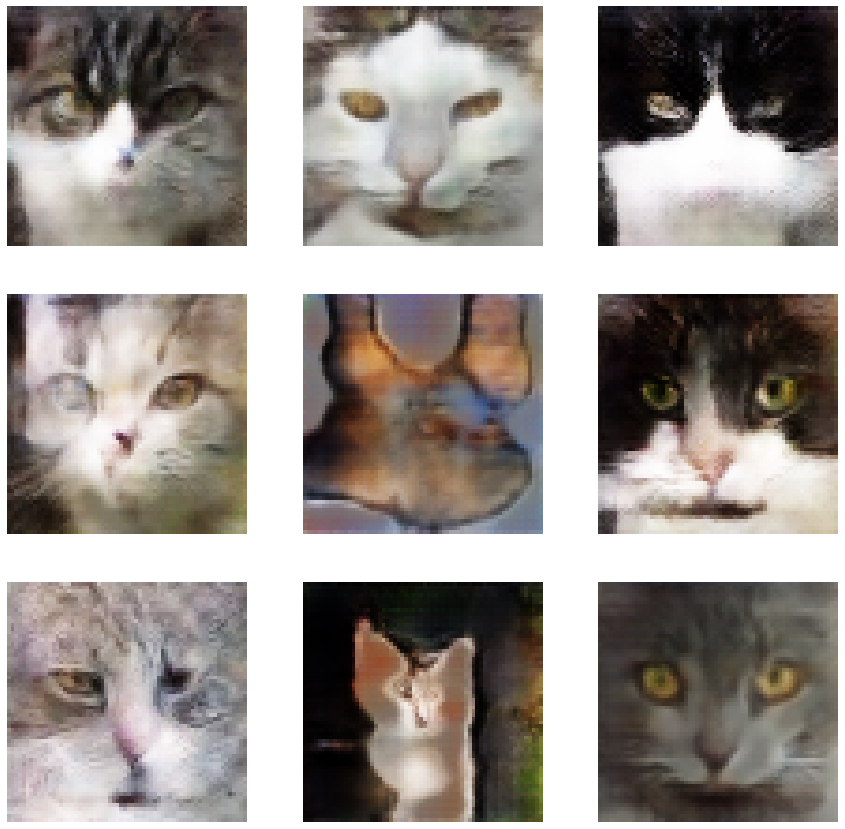

 74%|███████▍  | 74/100 [1:09:42<24:39, 56.91s/it]

Epoch: 74 computed for 57.071441411972046 sec


 75%|███████▌  | 75/100 [1:10:39<23:38, 56.73s/it]

Epoch: 75 computed for 56.30481004714966 sec


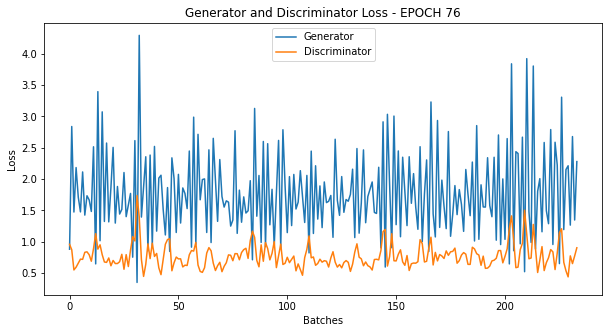

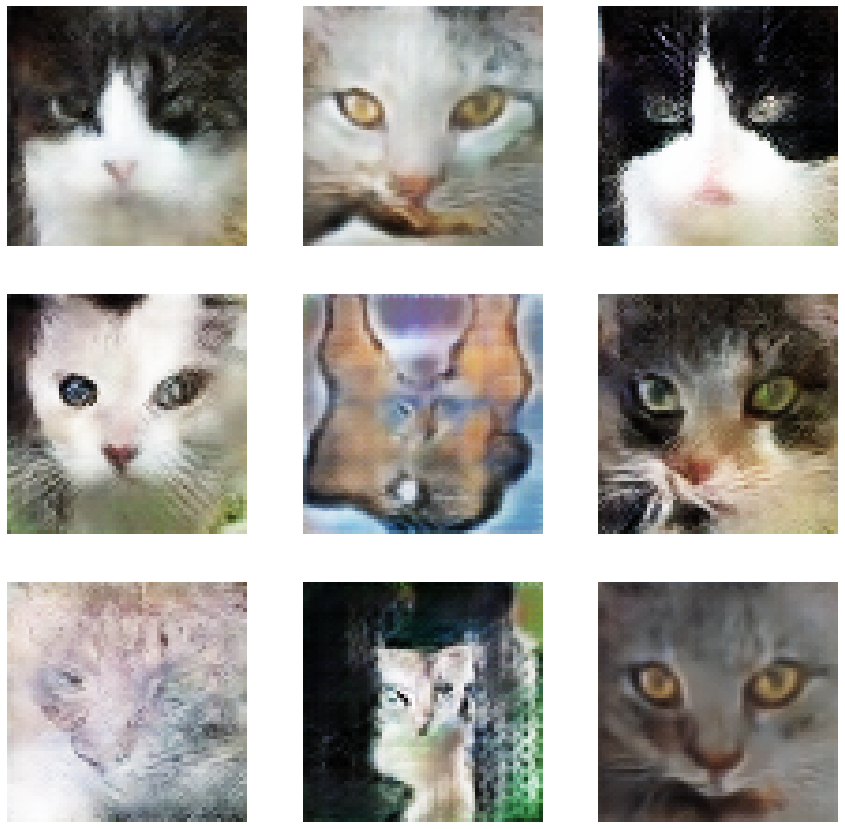

 76%|███████▌  | 76/100 [1:11:36<22:45, 56.90s/it]

Epoch: 76 computed for 57.29188323020935 sec


 77%|███████▋  | 77/100 [1:12:32<21:43, 56.68s/it]

Epoch: 77 computed for 56.162830114364624 sec


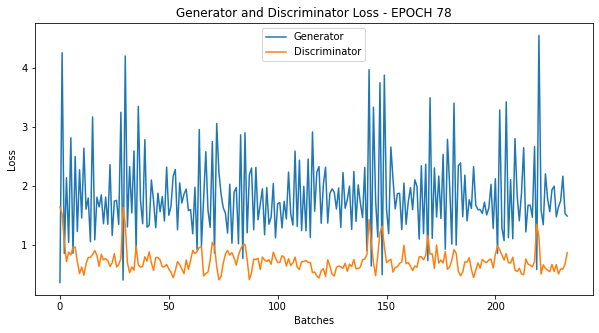

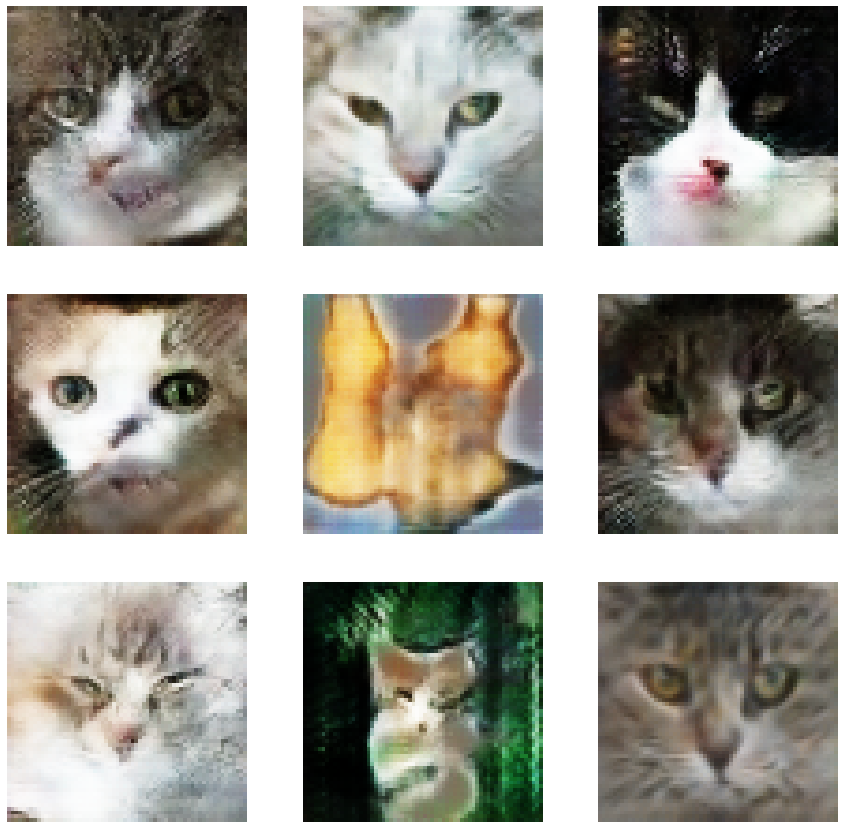

 78%|███████▊  | 78/100 [1:13:30<20:51, 56.90s/it]

Epoch: 78 computed for 57.421226024627686 sec


 79%|███████▉  | 79/100 [1:14:26<19:52, 56.79s/it]

Epoch: 79 computed for 56.507715702056885 sec


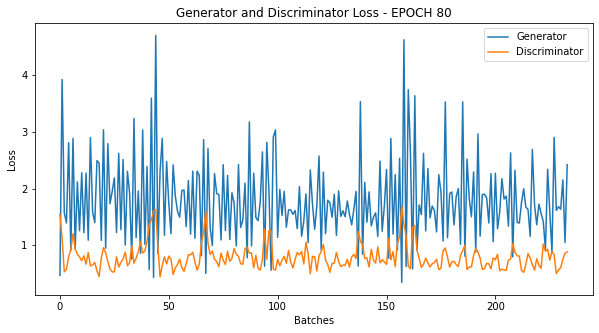

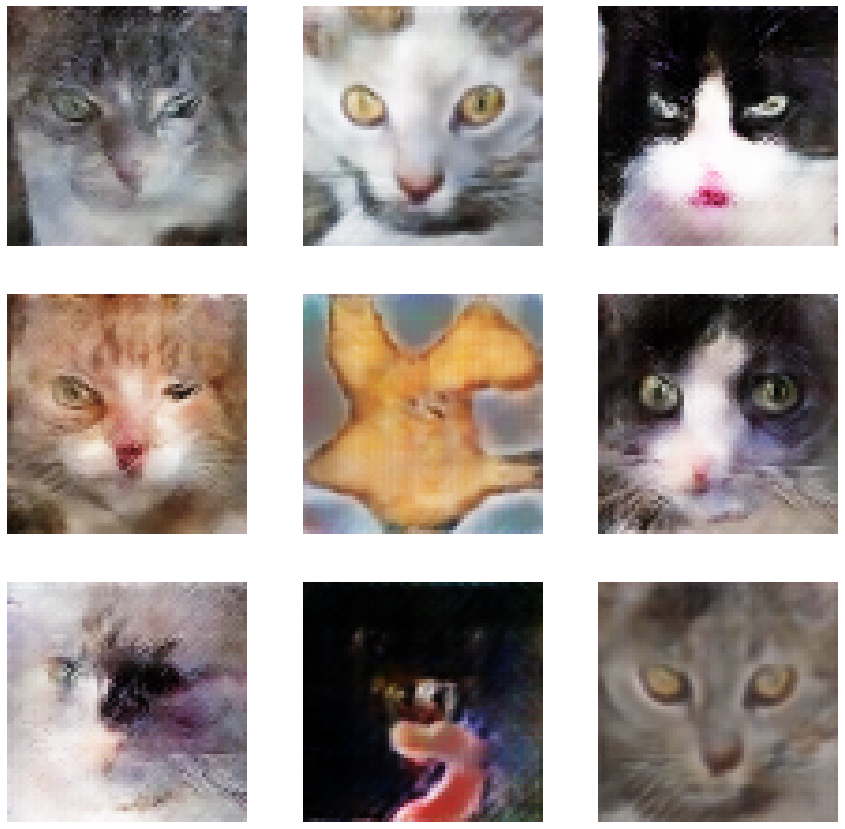

 80%|████████  | 80/100 [1:15:23<18:59, 56.96s/it]

Epoch: 80 computed for 57.359896183013916 sec


 81%|████████  | 81/100 [1:16:20<17:59, 56.83s/it]

Epoch: 81 computed for 56.53671169281006 sec


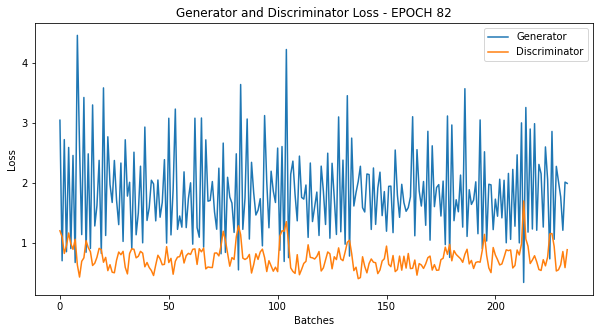

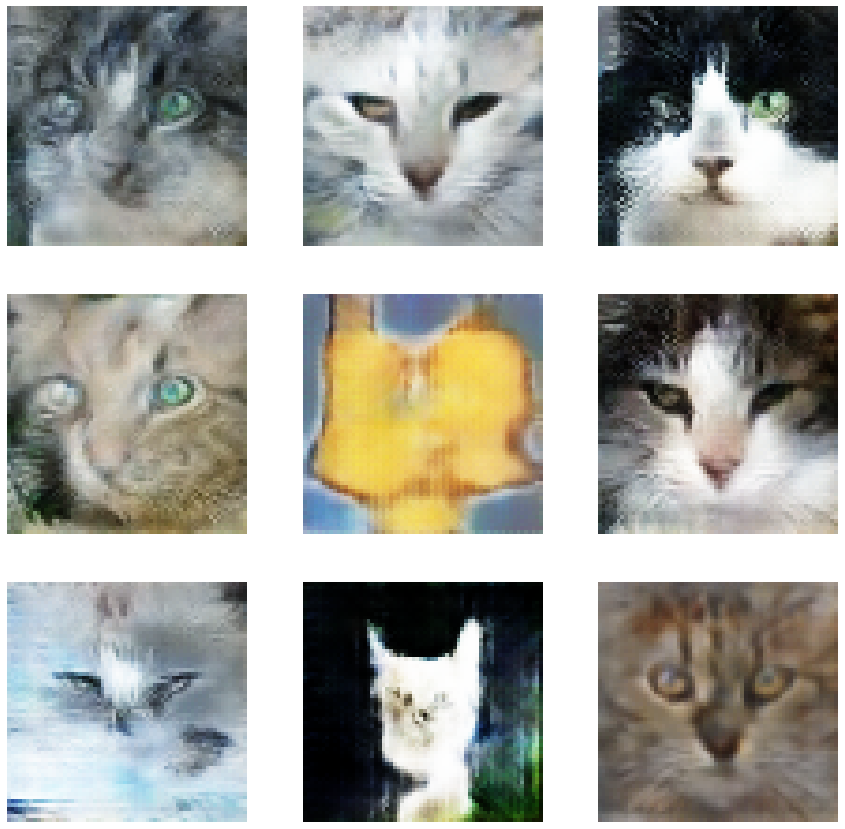

 82%|████████▏ | 82/100 [1:17:18<17:06, 57.05s/it]

Epoch: 82 computed for 57.55882525444031 sec


 83%|████████▎ | 83/100 [1:18:15<16:09, 57.01s/it]

Epoch: 83 computed for 56.924240827560425 sec


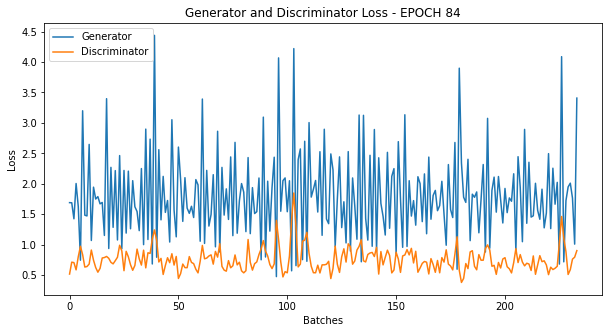

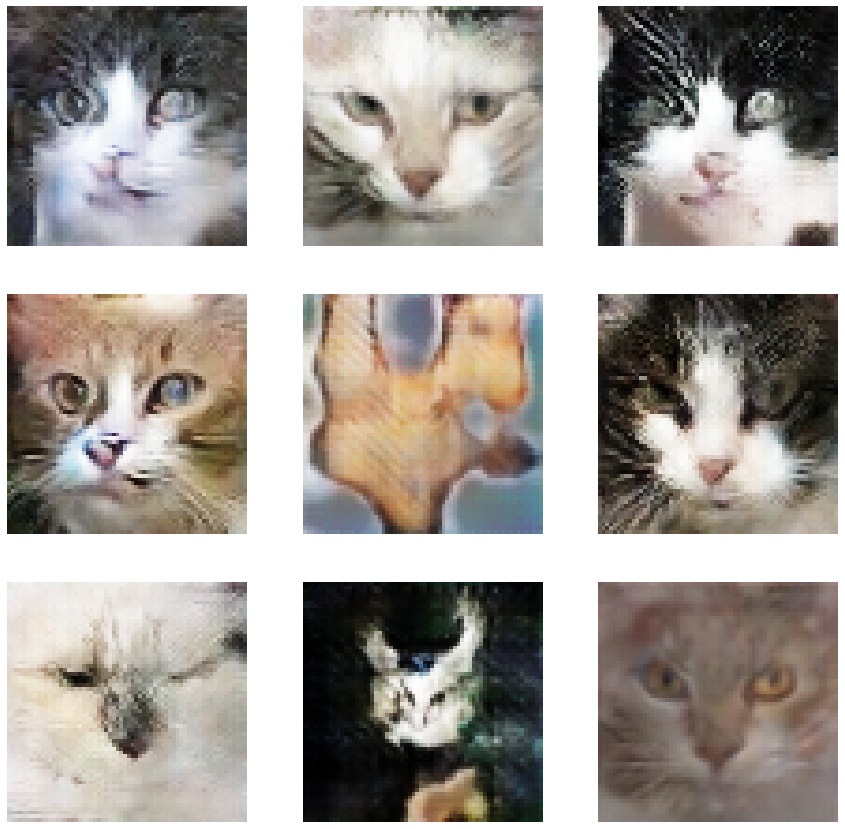

 84%|████████▍ | 84/100 [1:19:12<15:15, 57.22s/it]

Epoch: 84 computed for 57.70640587806702 sec


 85%|████████▌ | 85/100 [1:20:09<14:16, 57.10s/it]

Epoch: 85 computed for 56.80031228065491 sec


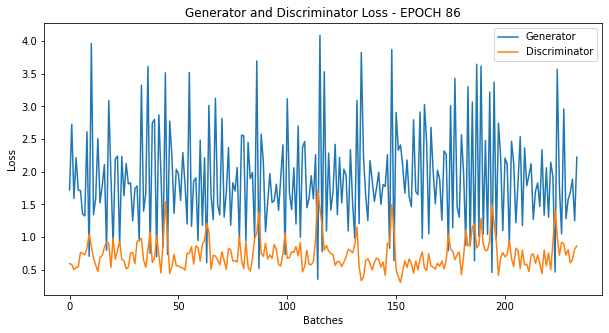

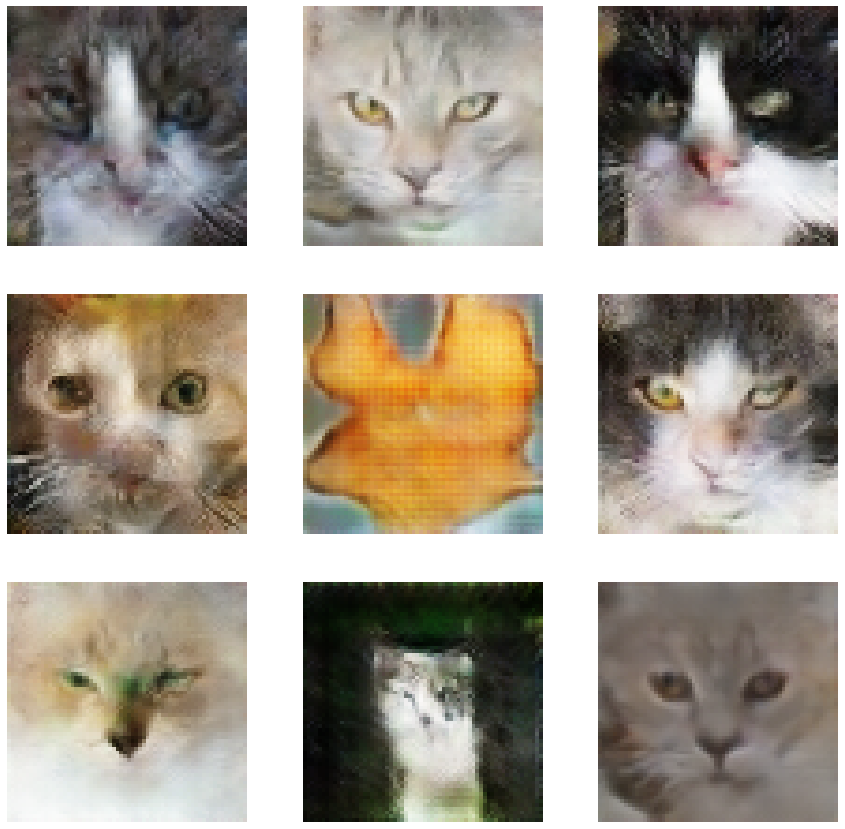

 86%|████████▌ | 86/100 [1:21:07<13:21, 57.23s/it]

Epoch: 86 computed for 57.54745364189148 sec


 87%|████████▋ | 87/100 [1:22:03<12:21, 57.03s/it]

Epoch: 87 computed for 56.55825328826904 sec


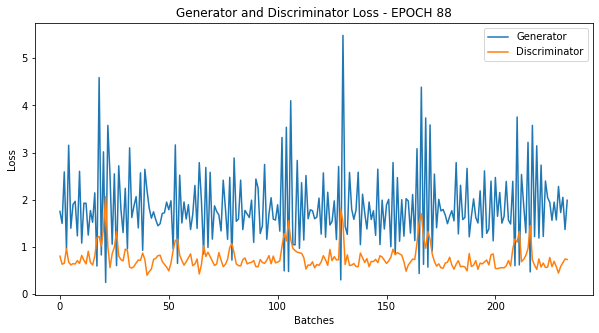

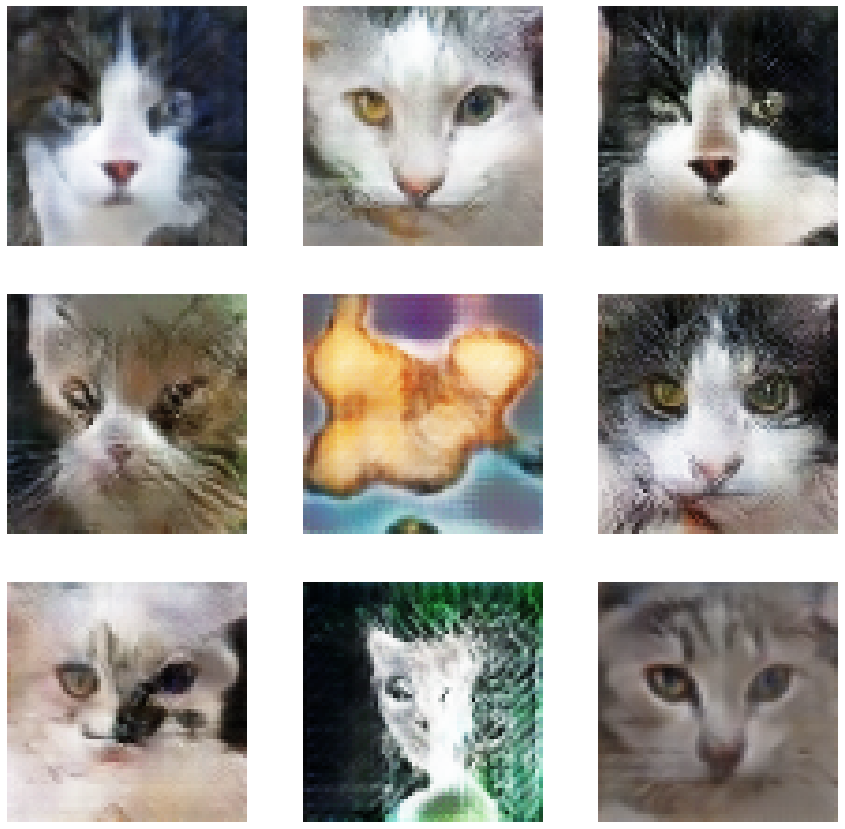

 88%|████████▊ | 88/100 [1:23:01<11:26, 57.19s/it]

Epoch: 88 computed for 57.558021783828735 sec


 89%|████████▉ | 89/100 [1:23:57<10:27, 57.07s/it]

Epoch: 89 computed for 56.79728841781616 sec


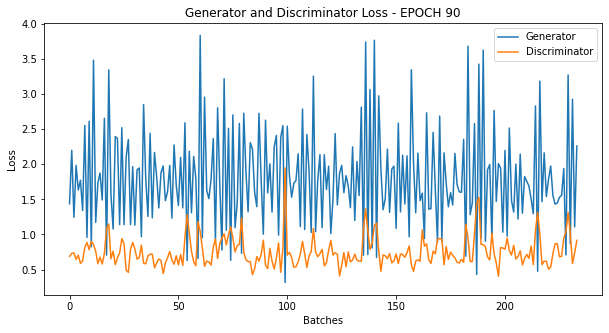

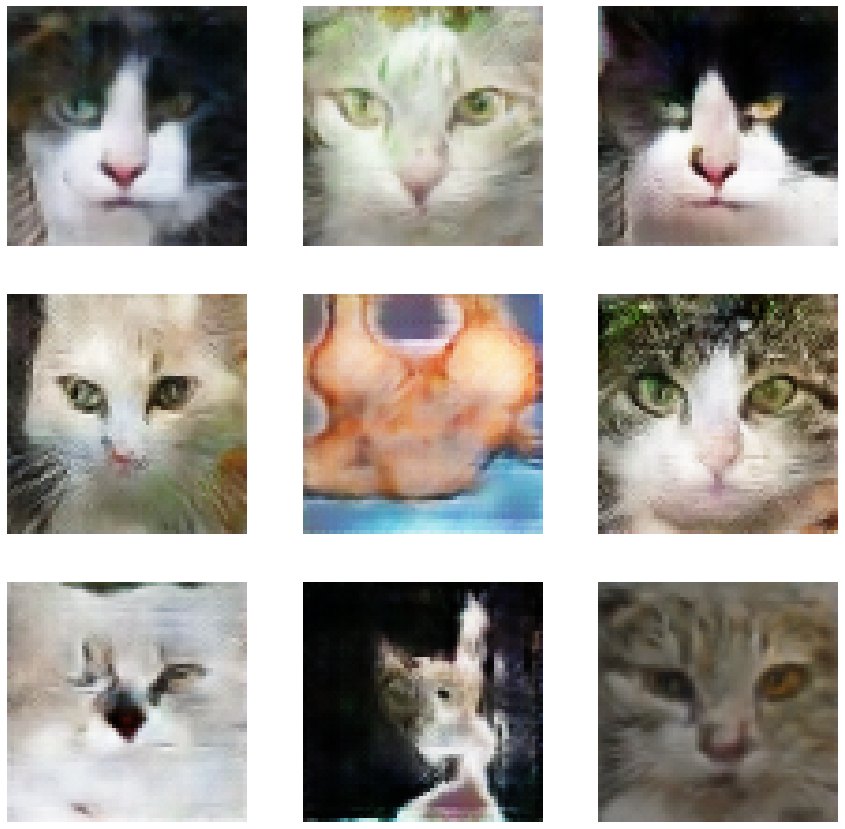

 90%|█████████ | 90/100 [1:24:55<09:32, 57.23s/it]

Epoch: 90 computed for 57.58242344856262 sec


 91%|█████████ | 91/100 [1:25:52<08:33, 57.07s/it]

Epoch: 91 computed for 56.70195007324219 sec


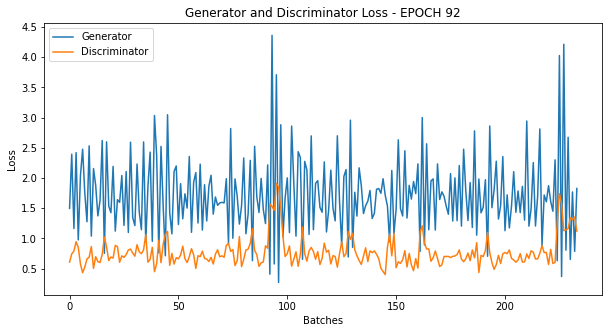

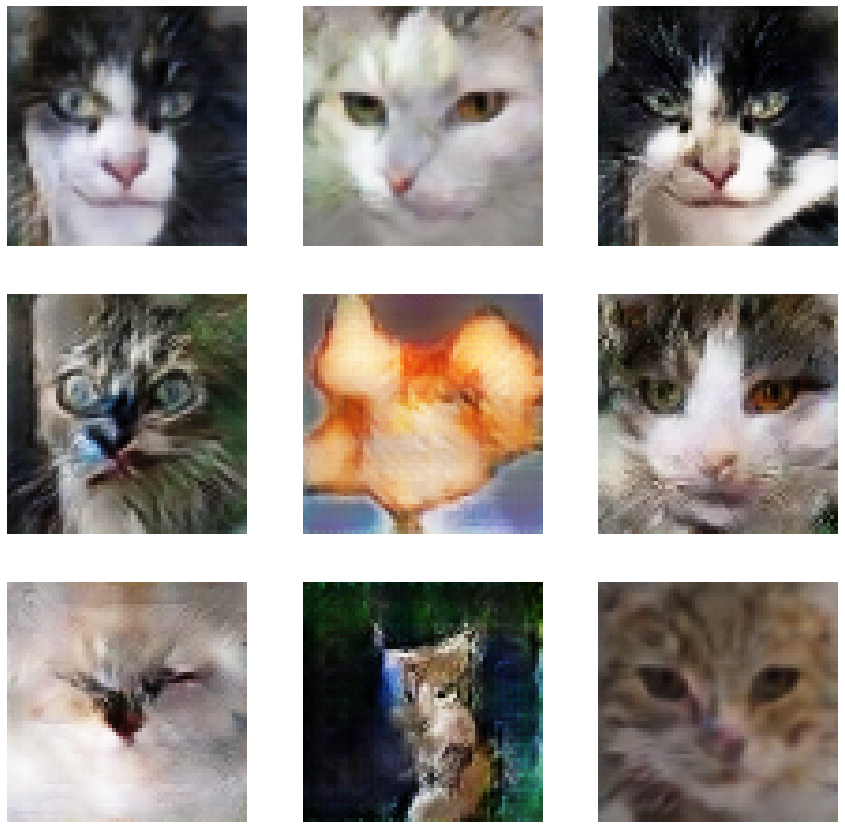

 92%|█████████▏| 92/100 [1:26:50<07:38, 57.31s/it]

Epoch: 92 computed for 57.86741757392883 sec


 93%|█████████▎| 93/100 [1:27:46<06:39, 57.14s/it]

Epoch: 93 computed for 56.74528098106384 sec


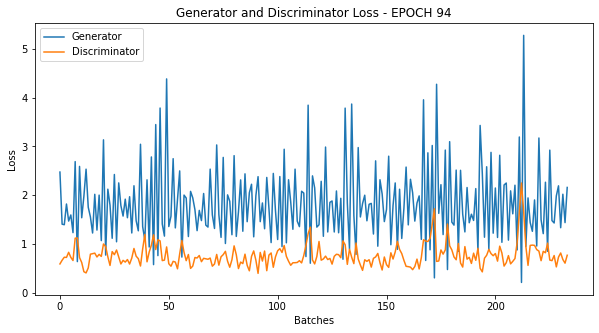

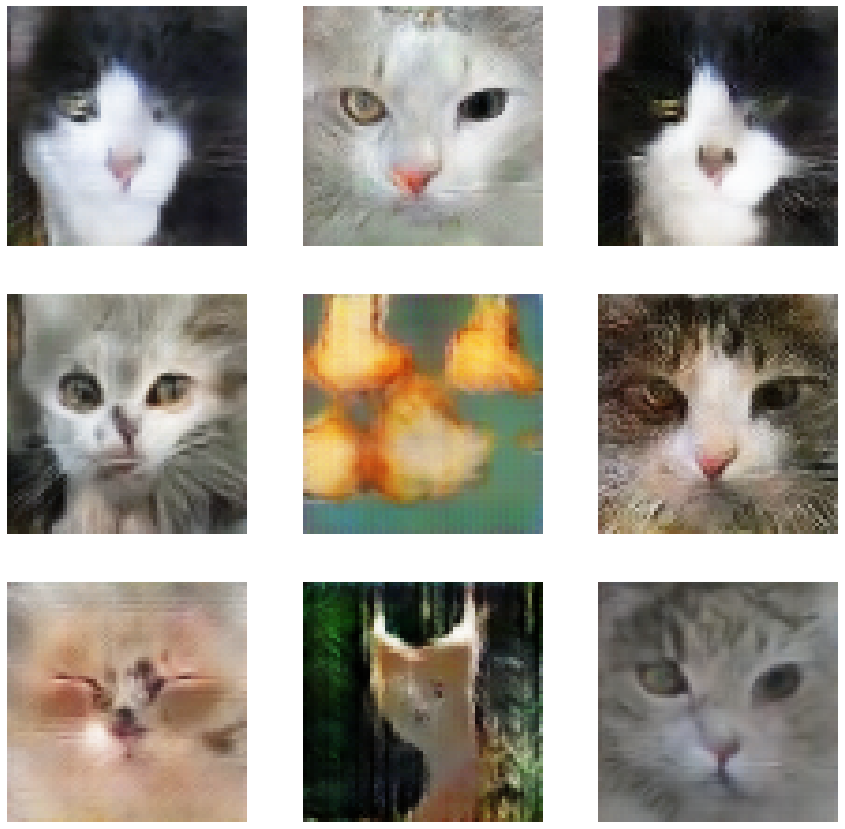

 94%|█████████▍| 94/100 [1:28:44<05:44, 57.37s/it]

Epoch: 94 computed for 57.89196729660034 sec


 95%|█████████▌| 95/100 [1:29:42<04:46, 57.38s/it]

Epoch: 95 computed for 57.405128717422485 sec


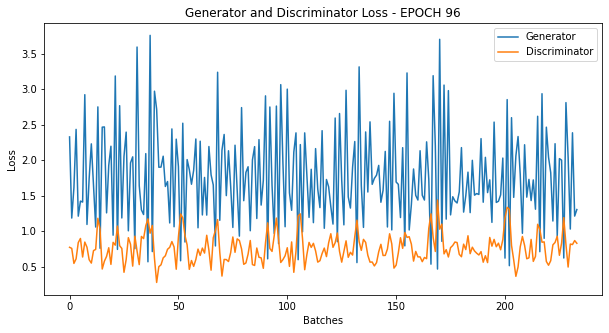

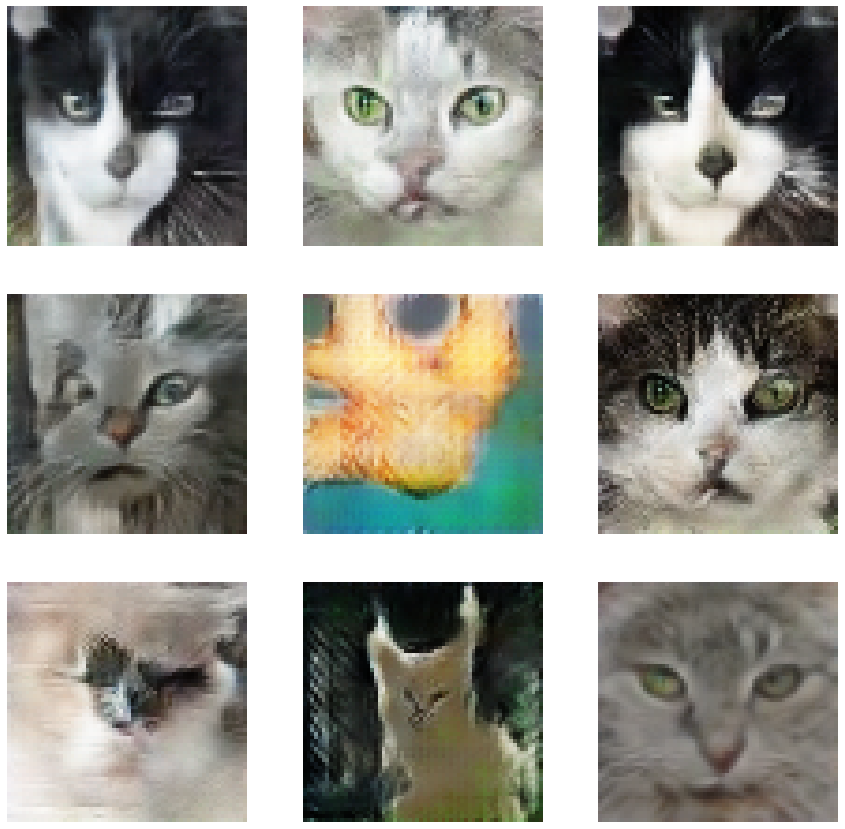

 96%|█████████▌| 96/100 [1:30:41<03:51, 57.84s/it]

Epoch: 96 computed for 58.93100428581238 sec


 97%|█████████▋| 97/100 [1:31:39<02:53, 57.97s/it]

Epoch: 97 computed for 58.2634699344635 sec


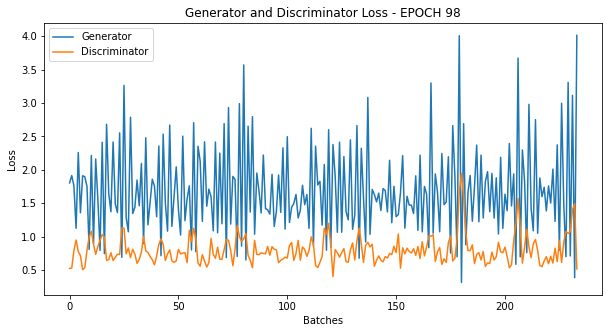

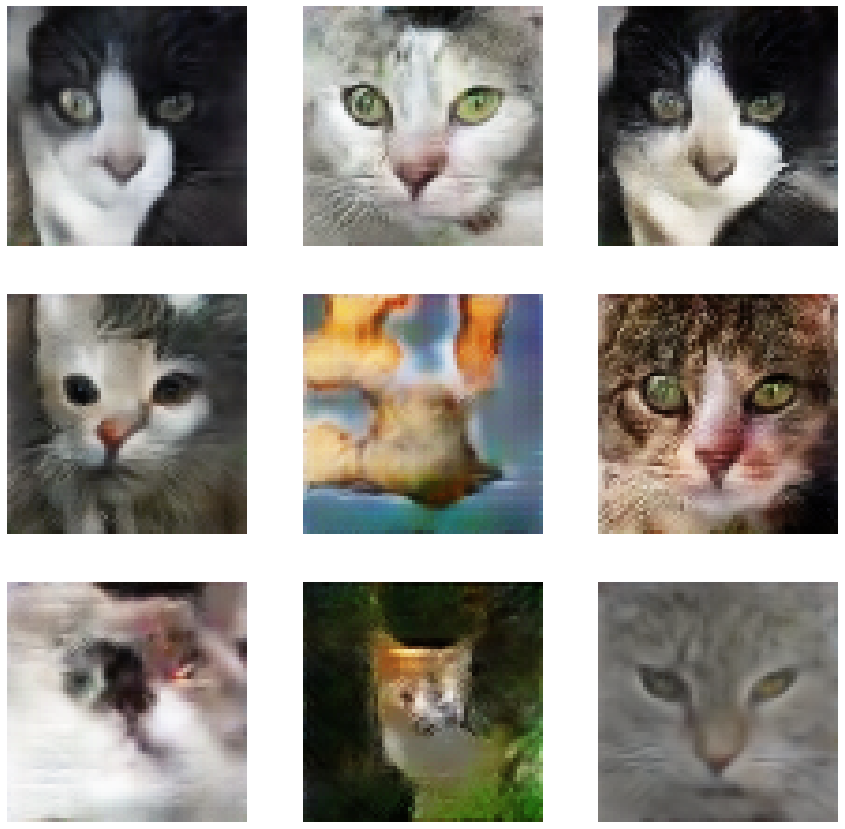

 98%|█████████▊| 98/100 [1:32:38<01:56, 58.30s/it]

Epoch: 98 computed for 59.05961537361145 sec


 99%|█████████▉| 99/100 [1:33:36<00:58, 58.20s/it]

Epoch: 99 computed for 57.9642493724823 sec


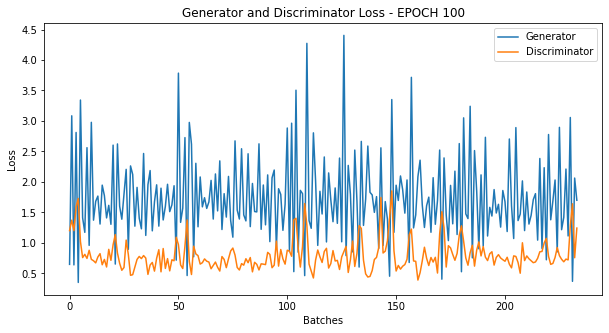

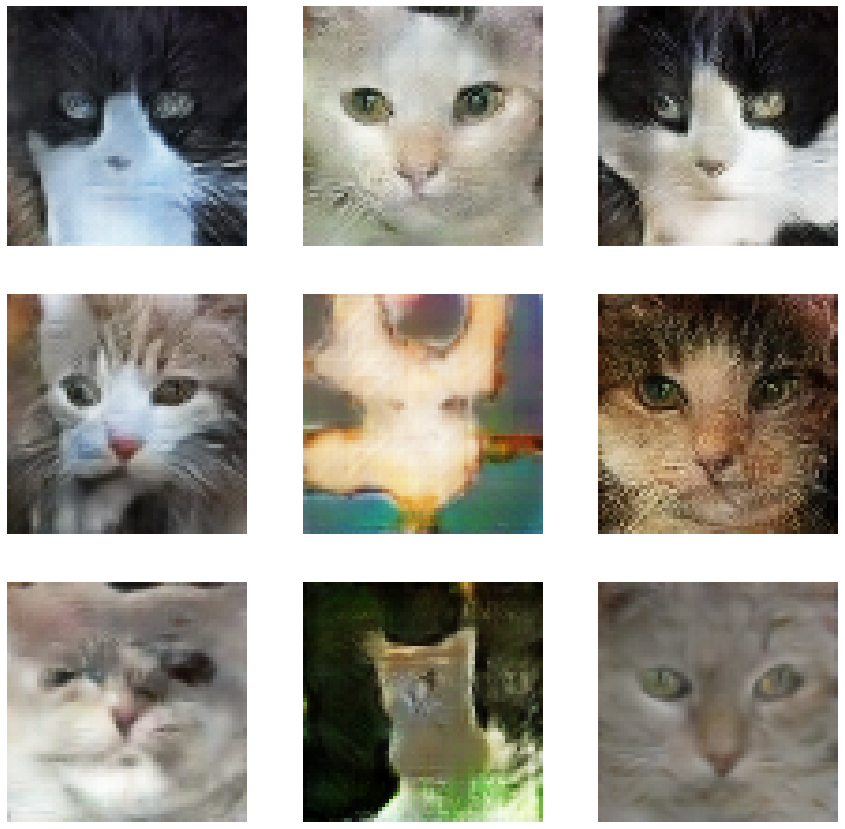

100%|██████████| 100/100 [1:34:35<00:00, 58.50s/it]

Epoch: 100 computed for 59.20443654060364 sec


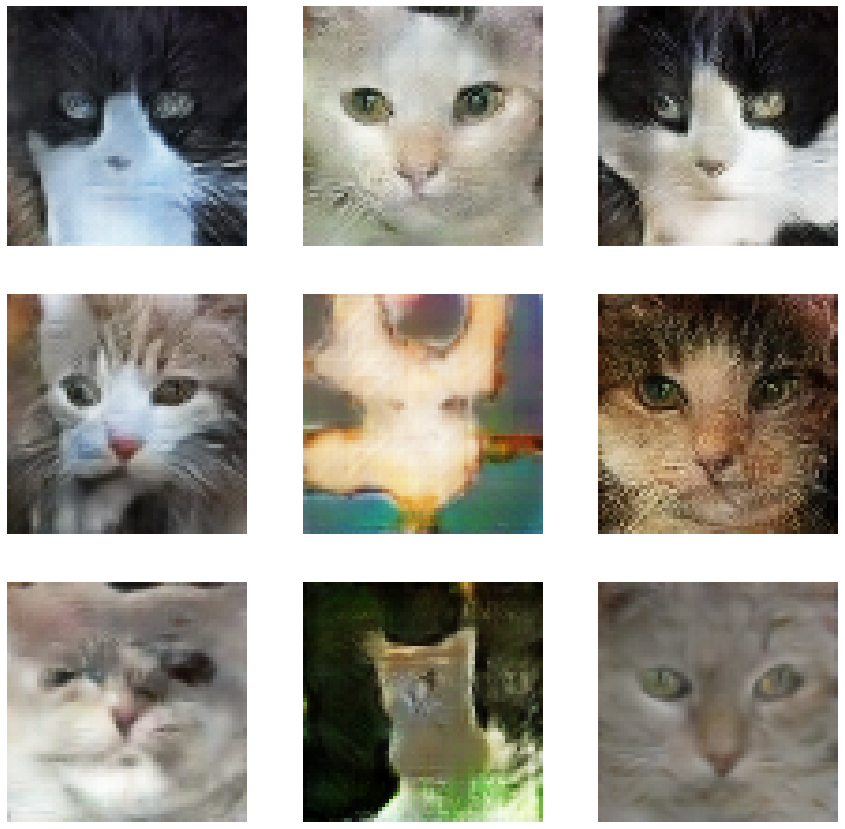

Final epoch.


In [29]:
Train(cat_features_data, 100)

  1%|          | 1/100 [00:56<1:33:51, 56.88s/it]

Epoch: 101 computed for 56.87885594367981 sec


  2%|▏         | 2/100 [01:53<1:32:39, 56.73s/it]

Epoch: 102 computed for 56.38591694831848 sec


  3%|▎         | 3/100 [02:49<1:31:32, 56.62s/it]

Epoch: 103 computed for 56.36026453971863 sec


  4%|▍         | 4/100 [03:46<1:30:31, 56.58s/it]

Epoch: 104 computed for 56.492331743240356 sec


  5%|▌         | 5/100 [04:42<1:29:33, 56.57s/it]

Epoch: 105 computed for 56.521161794662476 sec


  6%|▌         | 6/100 [05:38<1:28:28, 56.48s/it]

Epoch: 106 computed for 56.27015042304993 sec


  7%|▋         | 7/100 [06:35<1:27:30, 56.46s/it]

Epoch: 107 computed for 56.39881753921509 sec


  8%|▊         | 8/100 [07:31<1:26:31, 56.43s/it]

Epoch: 108 computed for 56.370282888412476 sec


  9%|▉         | 9/100 [08:27<1:25:31, 56.39s/it]

Epoch: 109 computed for 56.28363347053528 sec


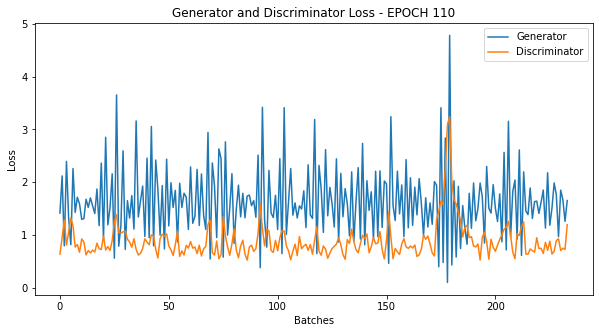

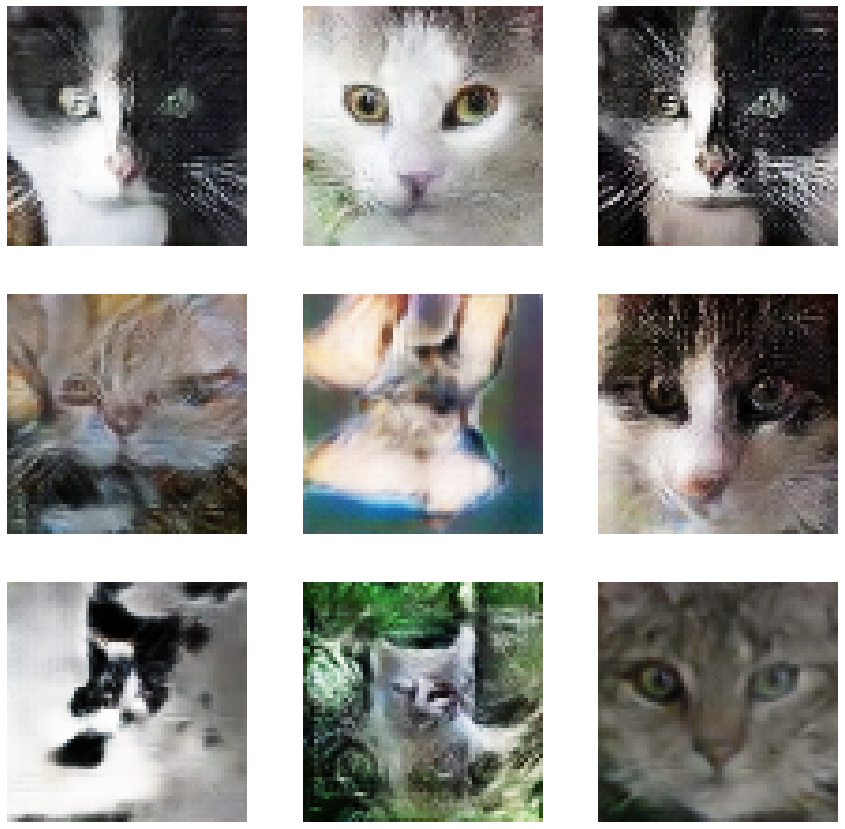

 10%|█         | 10/100 [09:25<1:25:13, 56.82s/it]

Epoch: 110 computed for 57.813169956207275 sec


 11%|█         | 11/100 [10:22<1:24:07, 56.71s/it]

Epoch: 111 computed for 56.46976709365845 sec


 12%|█▏        | 12/100 [11:18<1:23:06, 56.66s/it]

Epoch: 112 computed for 56.53309464454651 sec


 13%|█▎        | 13/100 [12:14<1:21:51, 56.46s/it]

Epoch: 113 computed for 55.99333071708679 sec


 14%|█▍        | 14/100 [13:11<1:20:55, 56.46s/it]

Epoch: 114 computed for 56.44521760940552 sec


 15%|█▌        | 15/100 [14:07<1:20:03, 56.51s/it]

Epoch: 115 computed for 56.64416766166687 sec


 16%|█▌        | 16/100 [15:03<1:18:55, 56.37s/it]

Epoch: 116 computed for 56.048869609832764 sec


 17%|█▋        | 17/100 [16:00<1:17:53, 56.31s/it]

Epoch: 117 computed for 56.170361042022705 sec


 18%|█▊        | 18/100 [16:56<1:16:53, 56.26s/it]

Epoch: 118 computed for 56.14336562156677 sec


 19%|█▉        | 19/100 [17:52<1:15:52, 56.21s/it]

Epoch: 119 computed for 56.077861309051514 sec


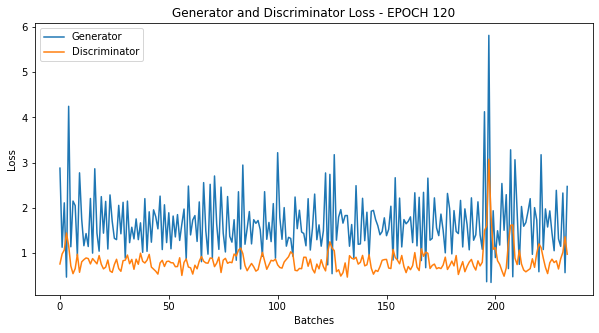

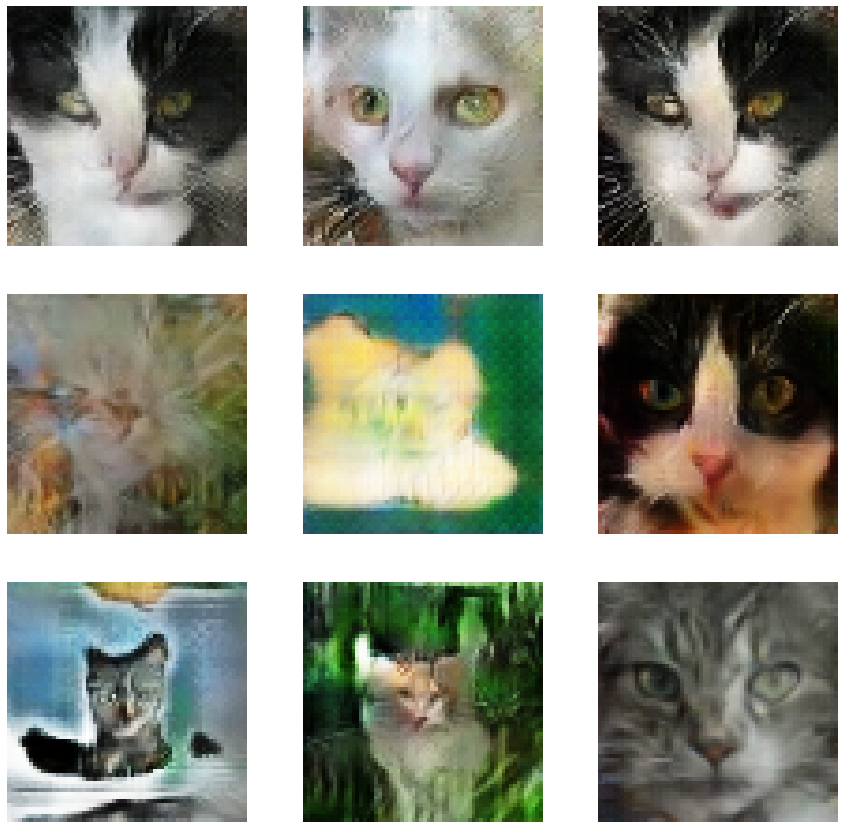

 20%|██        | 20/100 [18:49<1:15:12, 56.41s/it]

Epoch: 120 computed for 56.86984705924988 sec


 21%|██        | 21/100 [19:45<1:14:16, 56.41s/it]

Epoch: 121 computed for 56.4188506603241 sec


 22%|██▏       | 22/100 [20:41<1:13:03, 56.20s/it]

Epoch: 122 computed for 55.69320607185364 sec


 23%|██▎       | 23/100 [21:37<1:11:59, 56.10s/it]

Epoch: 123 computed for 55.8567168712616 sec


 24%|██▍       | 24/100 [22:32<1:10:53, 55.96s/it]

Epoch: 124 computed for 55.65000939369202 sec


 25%|██▌       | 25/100 [23:28<1:09:53, 55.91s/it]

Epoch: 125 computed for 55.79442882537842 sec


 26%|██▌       | 26/100 [24:24<1:08:57, 55.91s/it]

Epoch: 126 computed for 55.89908051490784 sec


 27%|██▋       | 27/100 [25:20<1:08:01, 55.91s/it]

Epoch: 127 computed for 55.92741656303406 sec


 28%|██▊       | 28/100 [26:16<1:07:03, 55.88s/it]

Epoch: 128 computed for 55.80020999908447 sec


 29%|██▉       | 29/100 [27:11<1:06:03, 55.82s/it]

Epoch: 129 computed for 55.68104648590088 sec


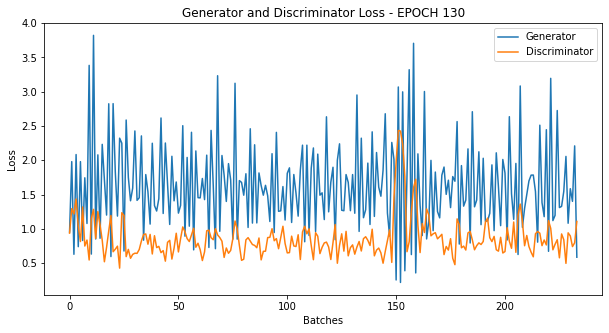

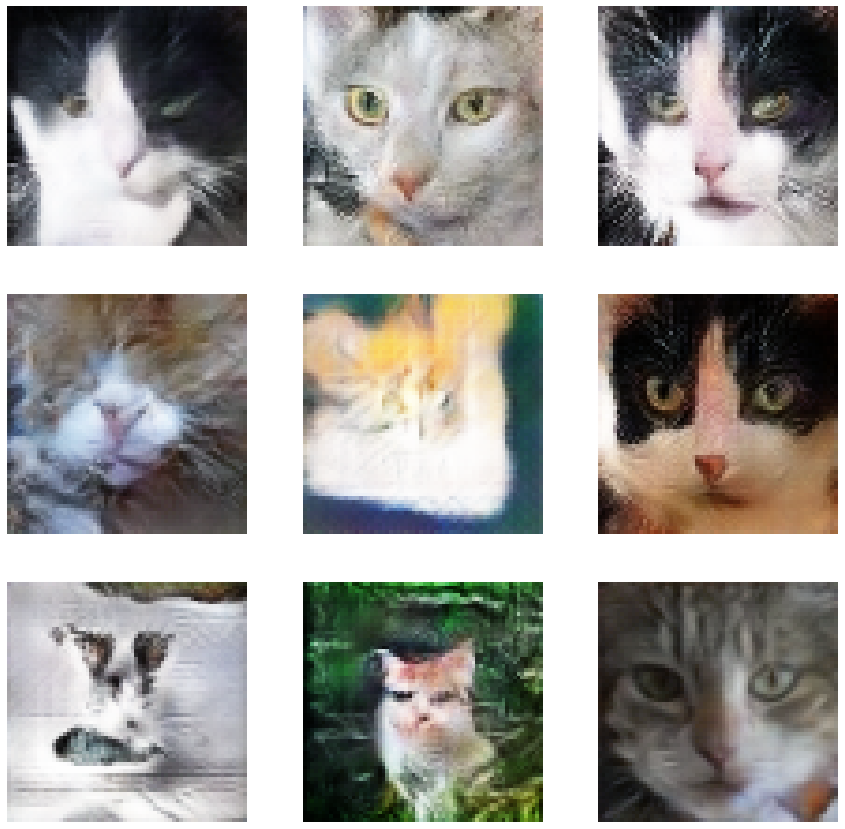

 30%|███       | 30/100 [28:09<1:05:35, 56.23s/it]

Epoch: 130 computed for 57.172849893569946 sec


 31%|███       | 31/100 [29:06<1:04:55, 56.45s/it]

Epoch: 131 computed for 56.97040677070618 sec


 32%|███▏      | 32/100 [30:02<1:03:59, 56.46s/it]

Epoch: 132 computed for 56.47461247444153 sec


 33%|███▎      | 33/100 [30:59<1:03:02, 56.46s/it]

Epoch: 133 computed for 56.452857971191406 sec


 34%|███▍      | 34/100 [31:55<1:02:04, 56.44s/it]

Epoch: 134 computed for 56.39289212226868 sec


 35%|███▌      | 35/100 [32:51<1:01:03, 56.37s/it]

Epoch: 135 computed for 56.203829526901245 sec


 36%|███▌      | 36/100 [33:47<59:54, 56.17s/it]  

Epoch: 136 computed for 55.69221782684326 sec


 37%|███▋      | 37/100 [34:43<58:50, 56.04s/it]

Epoch: 137 computed for 55.73330235481262 sec


 38%|███▊      | 38/100 [35:38<57:50, 55.97s/it]

Epoch: 138 computed for 55.81013035774231 sec


 39%|███▉      | 39/100 [36:34<56:49, 55.90s/it]

Epoch: 139 computed for 55.73540019989014 sec


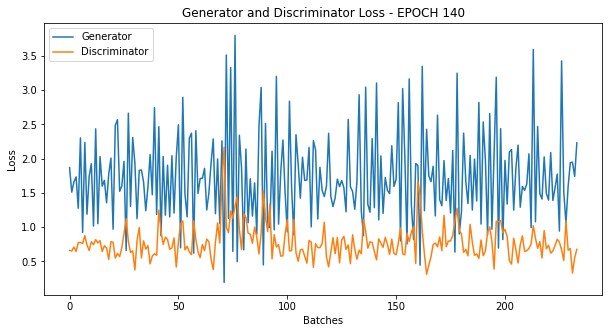

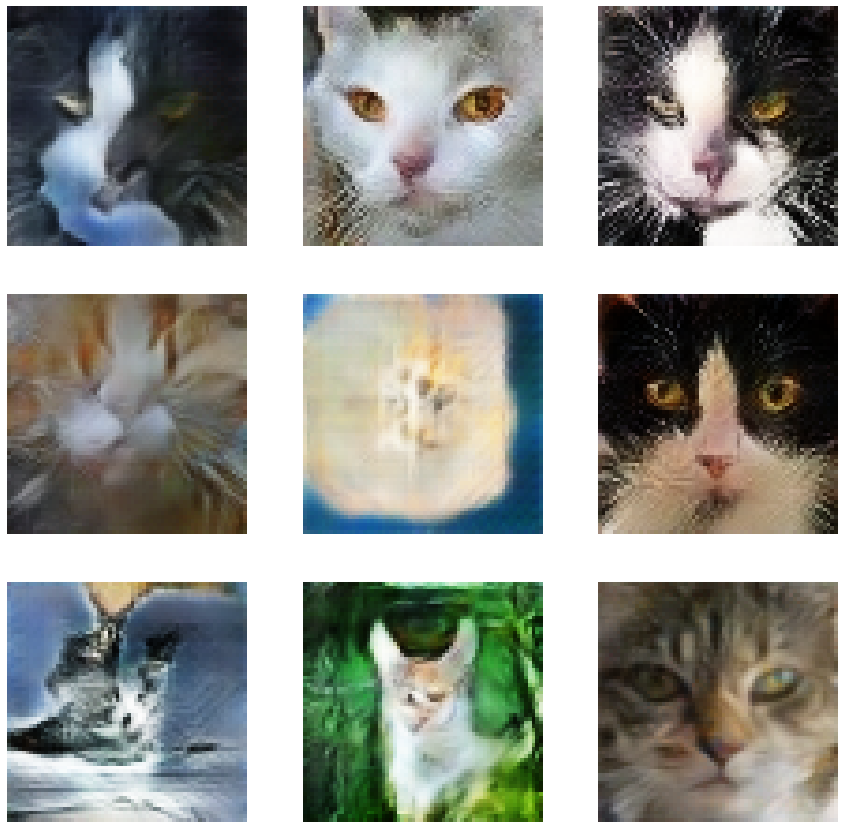

 40%|████      | 40/100 [37:31<56:15, 56.25s/it]

Epoch: 140 computed for 57.08080005645752 sec


 41%|████      | 41/100 [38:27<55:13, 56.16s/it]

Epoch: 141 computed for 55.929784059524536 sec


 42%|████▏     | 42/100 [39:23<54:08, 56.00s/it]

Epoch: 142 computed for 55.64082384109497 sec


 43%|████▎     | 43/100 [40:19<53:08, 55.93s/it]

Epoch: 143 computed for 55.75879406929016 sec


 44%|████▍     | 44/100 [41:14<52:05, 55.82s/it]

Epoch: 144 computed for 55.558319091796875 sec


 45%|████▌     | 45/100 [42:10<51:06, 55.76s/it]

Epoch: 145 computed for 55.61558175086975 sec


 46%|████▌     | 46/100 [43:05<50:07, 55.69s/it]

Epoch: 146 computed for 55.519612312316895 sec


 47%|████▋     | 47/100 [44:01<49:07, 55.62s/it]

Epoch: 147 computed for 55.45464324951172 sec


 48%|████▊     | 48/100 [44:56<48:09, 55.57s/it]

Epoch: 148 computed for 55.463913917541504 sec


 49%|████▉     | 49/100 [45:52<47:15, 55.60s/it]

Epoch: 149 computed for 55.6450035572052 sec


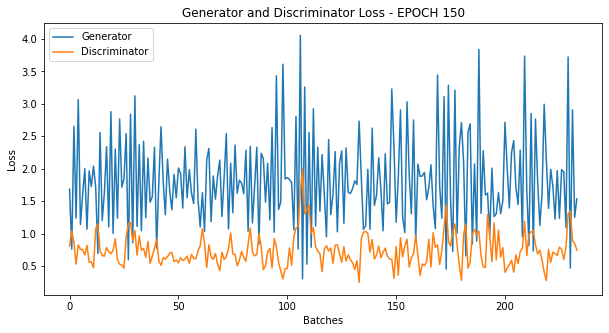

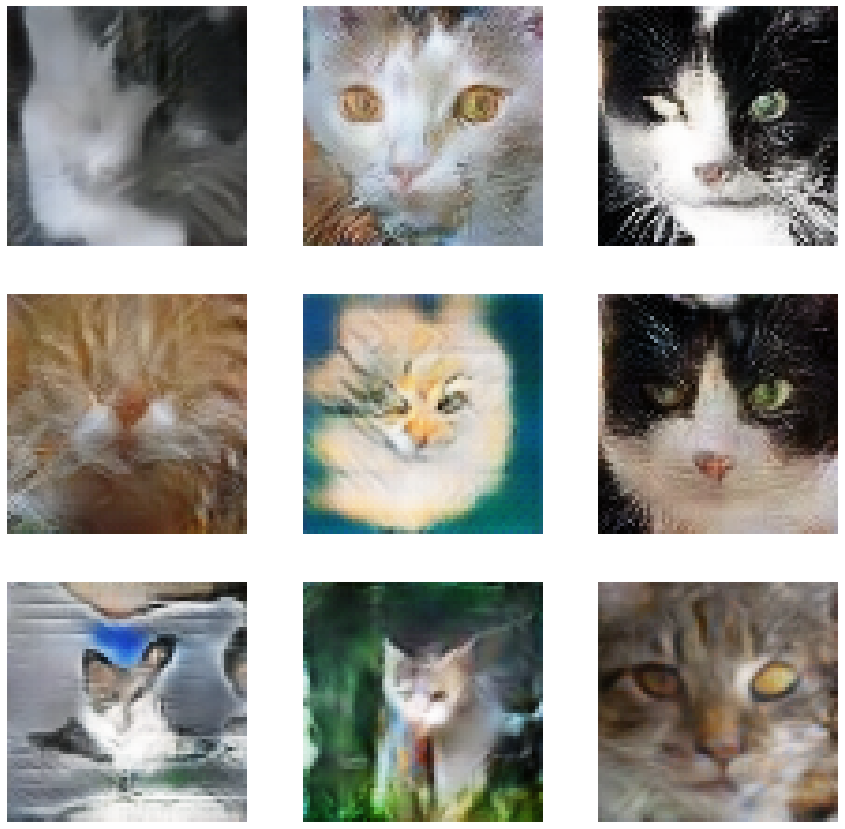

 50%|█████     | 50/100 [46:49<46:39, 55.99s/it]

Epoch: 150 computed for 56.91561508178711 sec


 51%|█████     | 51/100 [47:44<45:39, 55.91s/it]

Epoch: 151 computed for 55.701172828674316 sec


 52%|█████▏    | 52/100 [48:40<44:36, 55.77s/it]

Epoch: 152 computed for 55.4561550617218 sec


 53%|█████▎    | 53/100 [49:35<43:36, 55.66s/it]

Epoch: 153 computed for 55.41592526435852 sec


 54%|█████▍    | 54/100 [50:31<42:40, 55.66s/it]

Epoch: 154 computed for 55.630990982055664 sec


 55%|█████▌    | 55/100 [51:26<41:41, 55.60s/it]

Epoch: 155 computed for 55.46364736557007 sec


 56%|█████▌    | 56/100 [52:22<40:41, 55.49s/it]

Epoch: 156 computed for 55.238449811935425 sec


 57%|█████▋    | 57/100 [53:17<39:45, 55.48s/it]

Epoch: 157 computed for 55.44563269615173 sec


 58%|█████▊    | 58/100 [54:12<38:49, 55.46s/it]

Epoch: 158 computed for 55.40333390235901 sec


 59%|█████▉    | 59/100 [55:08<37:53, 55.45s/it]

Epoch: 159 computed for 55.43810701370239 sec


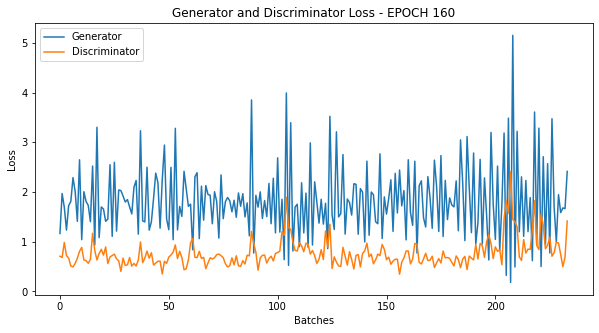

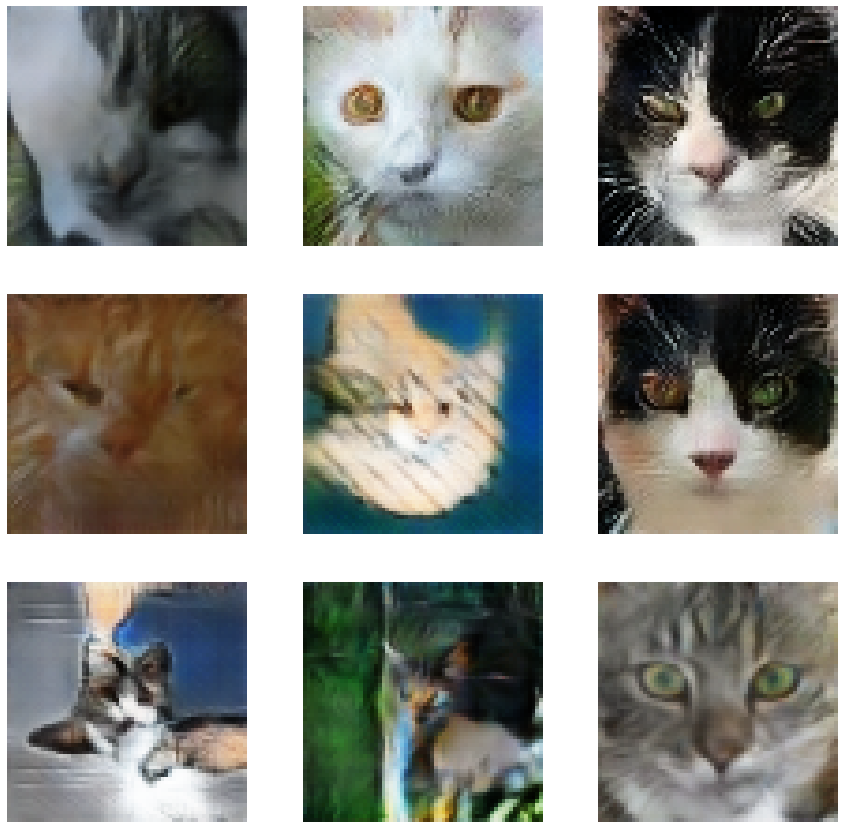

 60%|██████    | 60/100 [56:05<37:23, 56.08s/it]

Epoch: 160 computed for 57.533941984176636 sec


 61%|██████    | 61/100 [57:02<36:28, 56.11s/it]

Epoch: 161 computed for 56.17995023727417 sec


 62%|██████▏   | 62/100 [57:57<35:27, 55.98s/it]

Epoch: 162 computed for 55.684162616729736 sec


 63%|██████▎   | 63/100 [58:53<34:30, 55.95s/it]

Epoch: 163 computed for 55.86745071411133 sec


 64%|██████▍   | 64/100 [59:49<33:31, 55.86s/it]

Epoch: 164 computed for 55.659114360809326 sec


 65%|██████▌   | 65/100 [1:00:45<32:33, 55.82s/it]

Epoch: 165 computed for 55.717607259750366 sec


 66%|██████▌   | 66/100 [1:01:40<31:35, 55.75s/it]

Epoch: 166 computed for 55.56833481788635 sec


 67%|██████▋   | 67/100 [1:02:36<30:39, 55.73s/it]

Epoch: 167 computed for 55.699026584625244 sec


 68%|██████▊   | 68/100 [1:03:32<29:44, 55.77s/it]

Epoch: 168 computed for 55.87422180175781 sec


 69%|██████▉   | 69/100 [1:04:27<28:48, 55.77s/it]

Epoch: 169 computed for 55.74815797805786 sec


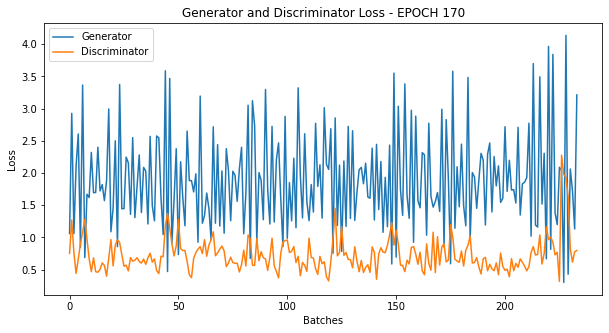

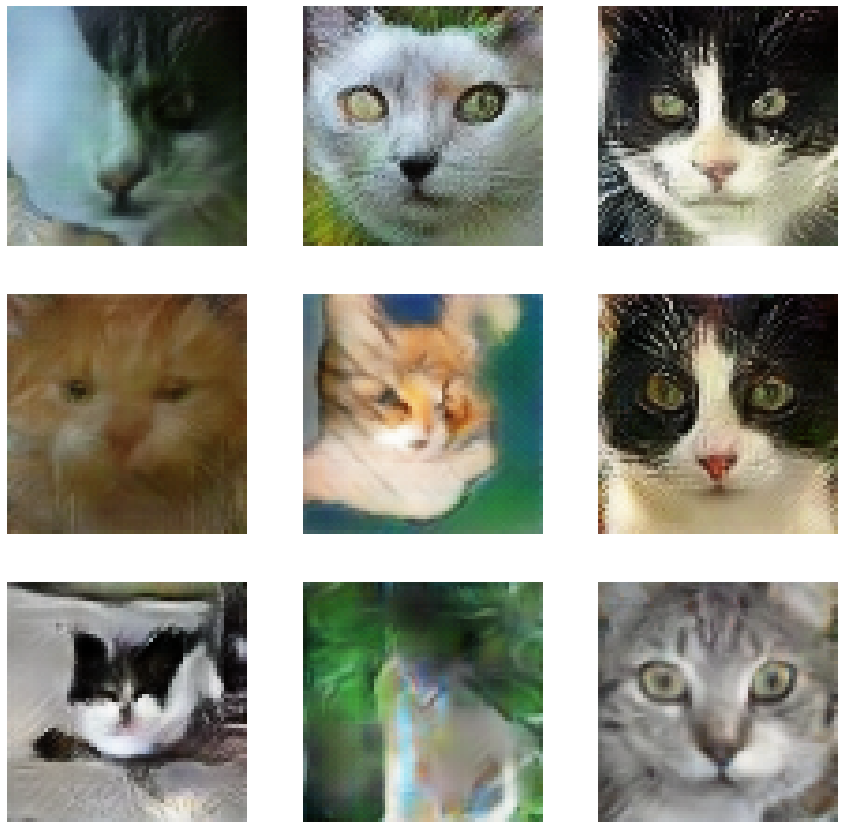

 70%|███████   | 70/100 [1:05:24<28:02, 56.10s/it]

Epoch: 170 computed for 56.861327171325684 sec


 71%|███████   | 71/100 [1:06:20<27:05, 56.07s/it]

Epoch: 171 computed for 56.00083541870117 sec


 72%|███████▏  | 72/100 [1:07:16<26:04, 55.86s/it]

Epoch: 172 computed for 55.36695098876953 sec


 73%|███████▎  | 73/100 [1:08:11<25:06, 55.80s/it]

Epoch: 173 computed for 55.65339279174805 sec


 74%|███████▍  | 74/100 [1:09:07<24:08, 55.73s/it]

Epoch: 174 computed for 55.572943687438965 sec


 75%|███████▌  | 75/100 [1:10:02<23:11, 55.67s/it]

Epoch: 175 computed for 55.52032494544983 sec


 76%|███████▌  | 76/100 [1:10:58<22:15, 55.65s/it]

Epoch: 176 computed for 55.61724495887756 sec


 77%|███████▋  | 77/100 [1:11:54<21:21, 55.73s/it]

Epoch: 177 computed for 55.89310693740845 sec


 78%|███████▊  | 78/100 [1:12:50<20:24, 55.67s/it]

Epoch: 178 computed for 55.54415678977966 sec


 79%|███████▉  | 79/100 [1:13:45<19:28, 55.63s/it]

Epoch: 179 computed for 55.519282817840576 sec


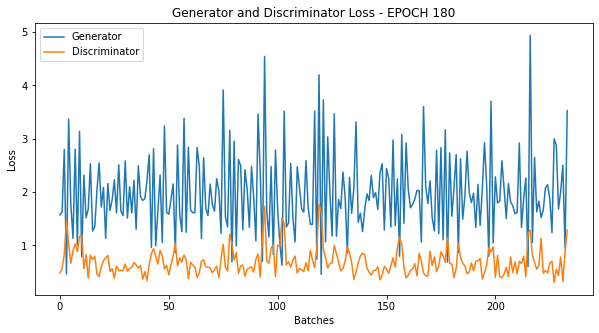

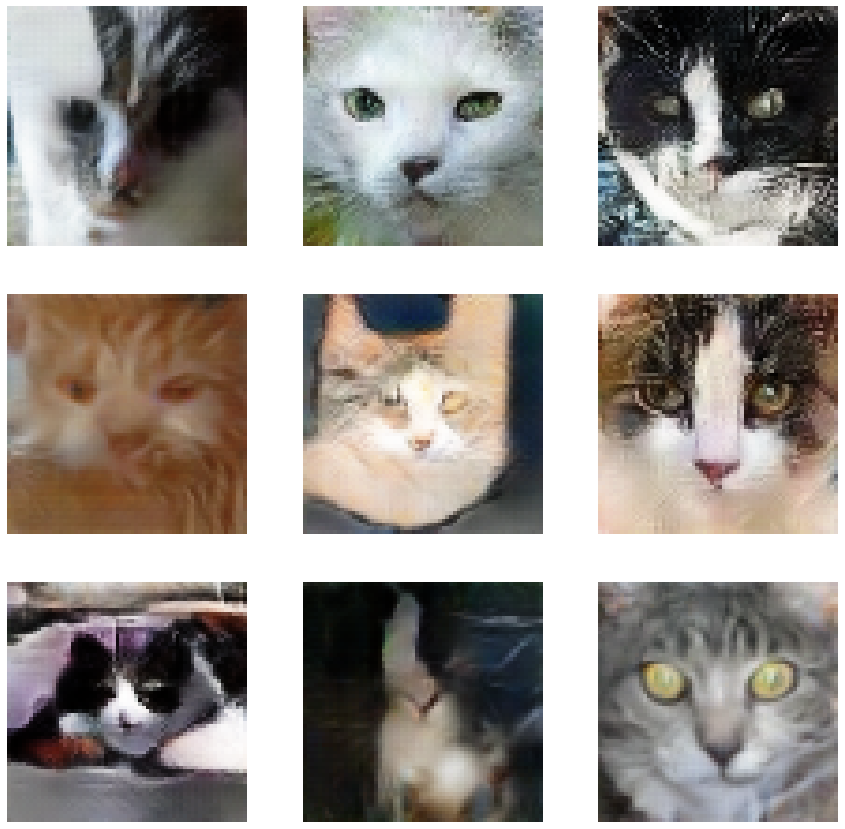

 80%|████████  | 80/100 [1:14:42<18:41, 56.06s/it]

Epoch: 180 computed for 57.05724859237671 sec


 81%|████████  | 81/100 [1:15:38<17:43, 55.99s/it]

Epoch: 181 computed for 55.83002328872681 sec


 82%|████████▏ | 82/100 [1:16:33<16:45, 55.85s/it]

Epoch: 182 computed for 55.50991749763489 sec


 83%|████████▎ | 83/100 [1:17:29<15:47, 55.72s/it]

Epoch: 183 computed for 55.41118764877319 sec


 84%|████████▍ | 84/100 [1:18:24<14:49, 55.58s/it]

Epoch: 184 computed for 55.24638366699219 sec


 85%|████████▌ | 85/100 [1:19:19<13:51, 55.45s/it]

Epoch: 185 computed for 55.14678621292114 sec


 86%|████████▌ | 86/100 [1:20:15<12:55, 55.40s/it]

Epoch: 186 computed for 55.28380751609802 sec


 87%|████████▋ | 87/100 [1:21:10<11:59, 55.37s/it]

Epoch: 187 computed for 55.31199932098389 sec


 88%|████████▊ | 88/100 [1:22:05<11:05, 55.43s/it]

Epoch: 188 computed for 55.54163217544556 sec


 89%|████████▉ | 89/100 [1:23:01<10:09, 55.40s/it]

Epoch: 189 computed for 55.330613136291504 sec


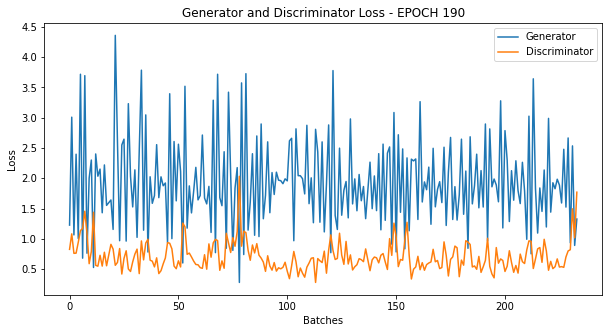

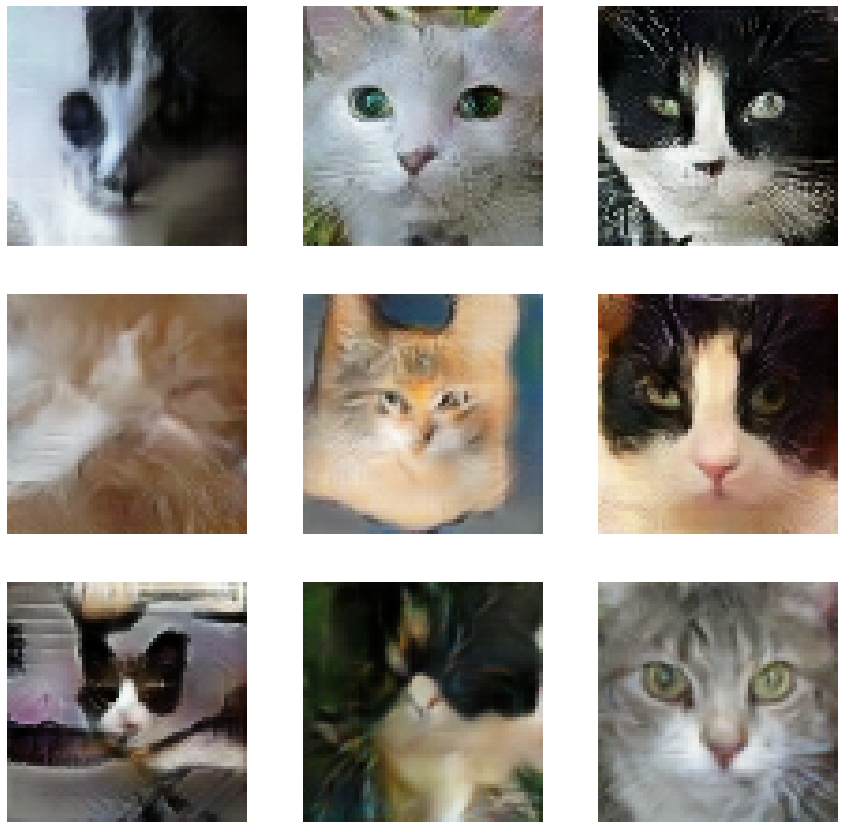

 90%|█████████ | 90/100 [1:23:57<09:17, 55.80s/it]

Epoch: 190 computed for 56.731226205825806 sec


 91%|█████████ | 91/100 [1:24:53<08:21, 55.74s/it]

Epoch: 191 computed for 55.58754253387451 sec


 92%|█████████▏| 92/100 [1:25:49<07:25, 55.66s/it]

Epoch: 192 computed for 55.46817636489868 sec


 93%|█████████▎| 93/100 [1:26:45<06:30, 55.76s/it]

Epoch: 193 computed for 56.010302782058716 sec


 94%|█████████▍| 94/100 [1:27:40<05:34, 55.74s/it]

Epoch: 194 computed for 55.67289400100708 sec


 95%|█████████▌| 95/100 [1:28:36<04:38, 55.73s/it]

Epoch: 195 computed for 55.707594871520996 sec


 96%|█████████▌| 96/100 [1:29:32<03:42, 55.74s/it]

Epoch: 196 computed for 55.770487546920776 sec


 97%|█████████▋| 97/100 [1:30:27<02:47, 55.68s/it]

Epoch: 197 computed for 55.54858422279358 sec


 98%|█████████▊| 98/100 [1:31:23<01:51, 55.64s/it]

Epoch: 198 computed for 55.52051091194153 sec


 99%|█████████▉| 99/100 [1:32:18<00:55, 55.65s/it]

Epoch: 199 computed for 55.67290115356445 sec


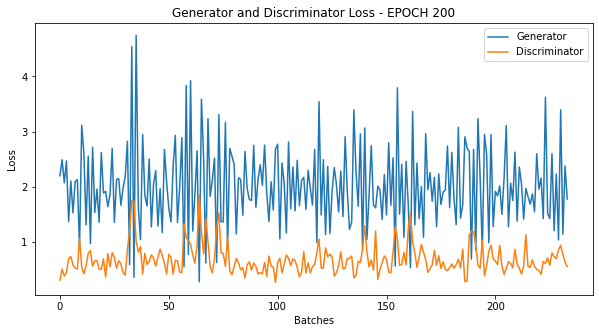

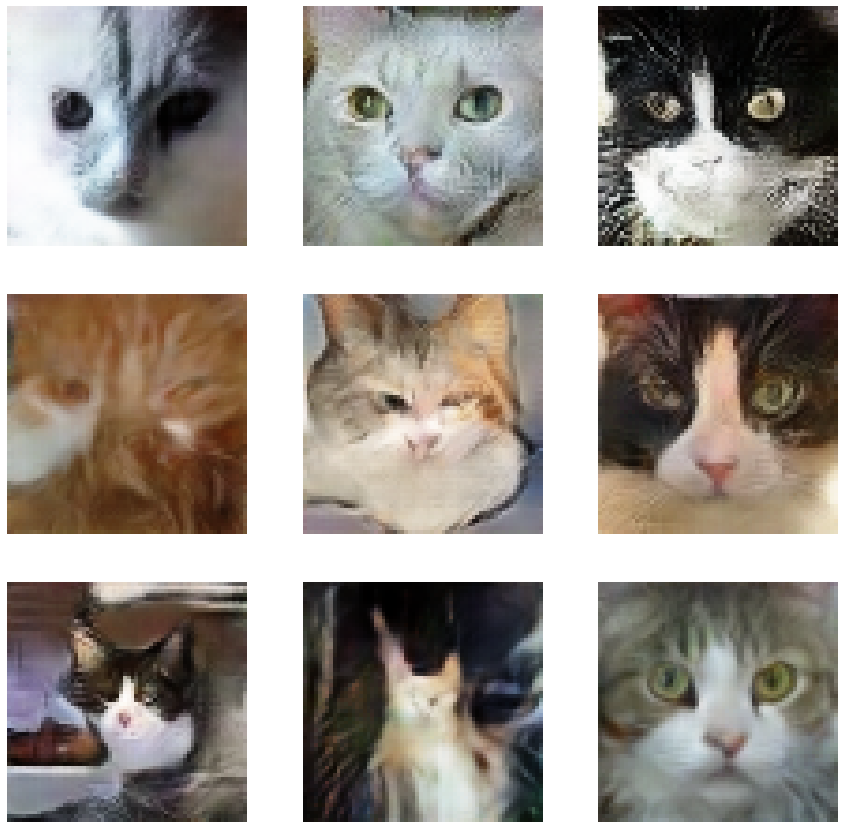

100%|██████████| 100/100 [1:33:15<00:00, 56.00s/it]

Epoch: 200 computed for 56.81565237045288 sec


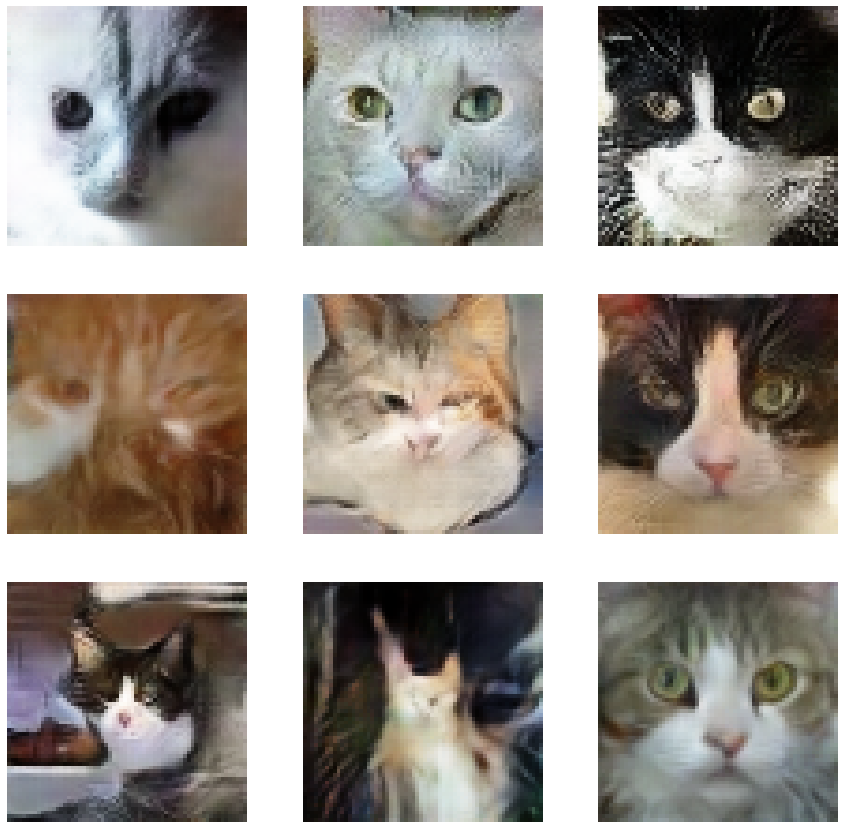

Final epoch.


In [31]:
Train(cat_features_data, 100)

100%|██████████| 1/1 [00:56<00:00, 56.66s/it]

Epoch: 101 computed for 56.66289949417114 sec


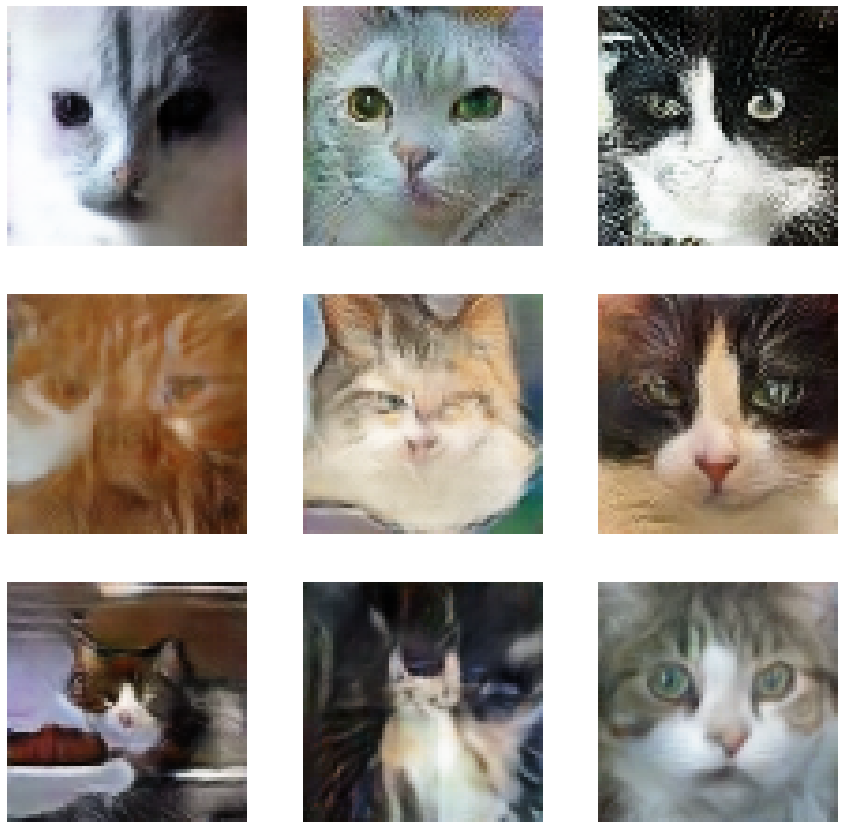

Final epoch.


In [32]:
Train(cat_features_data, 1)

### Generate Cats!

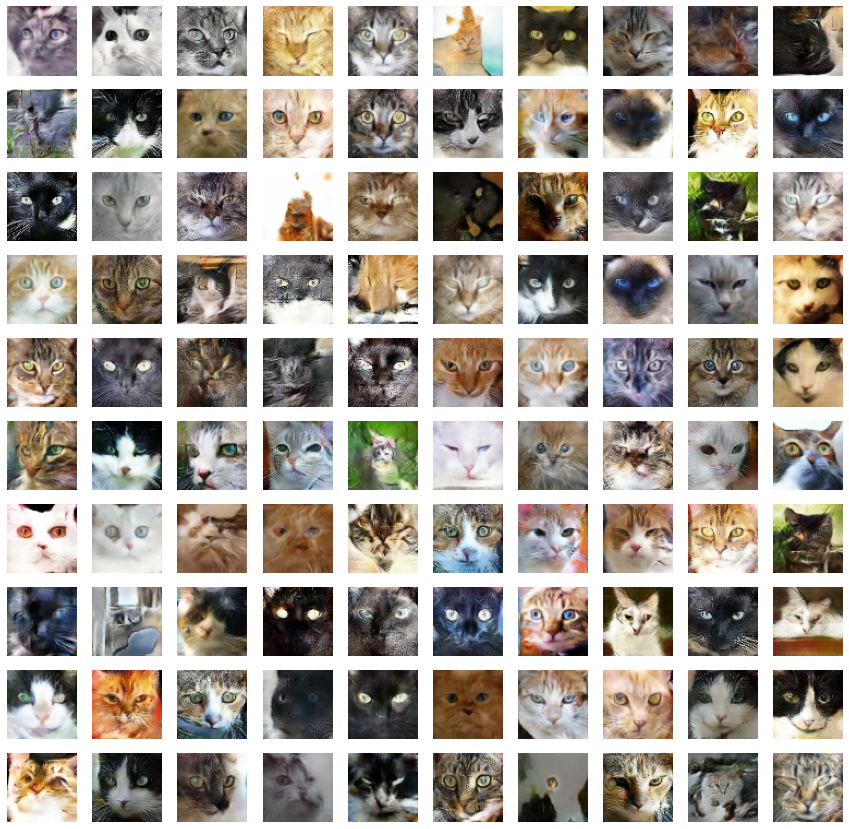

In [35]:
N_TO_GENERATE = 100
noise = tf.random.normal([N_TO_GENERATE, NOISE_DIM])
GenerateShowSaveCatImages(cat_generator,201, noise)